In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

source_df = pd.read_csv('../dataset/Datathon #4 - mhealth Dataset - HAD7001.csv')
#source_df.insert(0,'times', source_df.index)
print(source_df.shape)
print(source_df.subject.value_counts())
print(source_df.Activity.value_counts())

(999999, 14)
subject
subject1    161280
subject2    130561
subject8    129024
subject3    122112
subject5    119808
subject4    116736
subject7    104448
subject6     98304
subject9     17726
Name: count, dtype: int64
Activity
0     720946
1      27648
2      25406
3      24576
4      24576
9      24576
10     24576
11     24576
5      24576
7      23809
8      23501
6      22990
12      8243
Name: count, dtype: int64


In [2]:
null_check = source_df.isnull()
print(source_df[null_check.any(axis=1)])

Empty DataFrame
Columns: [alx, aly, alz, glx, gly, glz, arx, ary, arz, grx, gry, grz, Activity, subject]
Index: []


In [3]:
activity_10_mapping = {
    0: "Resting",
    1: "Standing still (1 min)",
    2: "Sitting and relaxing (1 min)",
    3: "Lying down (1 min)",
    4: "Walking (1 min)",
    5: "Climbing stairs (1 min)",
    6: "Waist bends forward (x20)",
    7: "Frontal elevation of arms (x20)",
    8: "Knees bending (crouching) (x20)",
    9: "Cycling (1 min)",
    10: "Jogging (1 min)",
    11: "Running (1 min)",
    12: "Jump front & back (x20)"
}
source_df['activity_10_category'] = source_df['Activity'].map(activity_10_mapping)


# Grop the label into 4
0 - Inactivity / Resting ( 0: Nothing , 1: Standing still (1 min) , 2: Sitting and relaxing (1 min), 3: Lying down (1 min))
1 - Low-Intensity Activities (4: Walking (1 min), 5: Climbing stairs (1 min) ,
2 - Moderate-Intensity Exercises , 6: Waist bends forward (x20) , 7: Frontal elevation of arms (x20) , 8: Knees bending (crouching) (x20), 9: Cycling (1 min)
3 - High-Intensity Exercises 10: Jogging (1 min) , 11: Running (1 min) , 12: Jump front & back (x20) 

In [4]:
num_subjects = source_df['subject'].nunique()

activity_mapping = {
    0: "Resting",
    1: "Resting",
    2: "Resting",
    3: "Resting",
    4: "LowIntensityExercise",
    5: "ModerateIntensityExercise",
    6: "LowIntensityExercise",
    7: "ModerateIntensityExercise",
    8: "ModerateIntensityExercise",
    9: "ModerateIntensityExercise",
    10: "HighIntensityExercise",
    11: "HighIntensityExercise",
    12: "HighIntensityExercise"
}

def get_activity_category(activity_id):
    return activity_mapping.get(activity_id, "Unknown")

#get_activity_category

source_df['activity_category'] = source_df['Activity'].map(activity_mapping)

activity_summary = source_df['activity_category'].value_counts()

num_subjects, activity_summary

(9,
 activity_category
 Resting                      798576
 ModerateIntensityExercise     96462
 HighIntensityExercise         57395
 LowIntensityExercise          47566
 Name: count, dtype: int64)

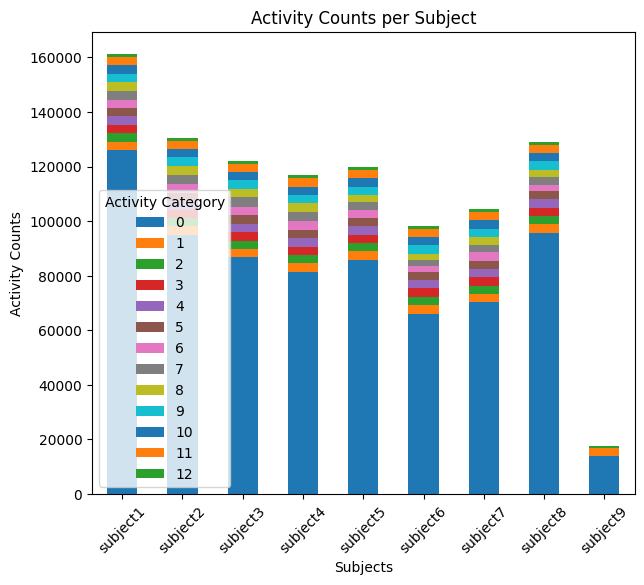

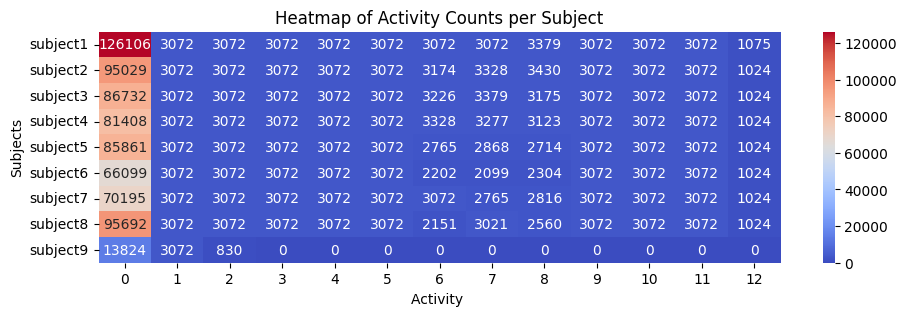

In [5]:
activity_counts_per_subject = source_df.groupby(["subject", "Activity"]).size().unstack(fill_value=0)
activity_counts_per_subject.plot(kind='bar', figsize=(7, 6), stacked=True)
plt.xlabel("Subjects")
plt.ylabel("Activity Counts")
plt.title("Activity Counts per Subject")
plt.legend(title="Activity Category")
plt.xticks(rotation=45)
plt.show()

plt.figure(figsize=(11,3))
sns.heatmap(activity_counts_per_subject, annot=True, cmap="coolwarm", fmt="d")
plt.xlabel("Activity ")
plt.ylabel("Subjects")
plt.title("Heatmap of Activity Counts per Subject")
plt.show()

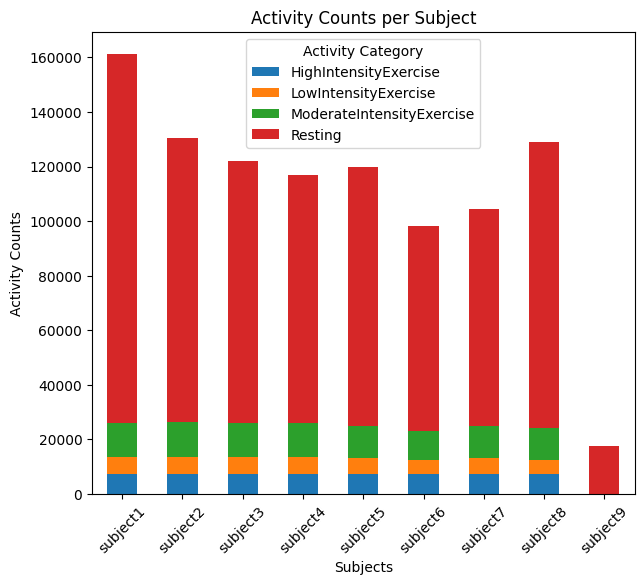

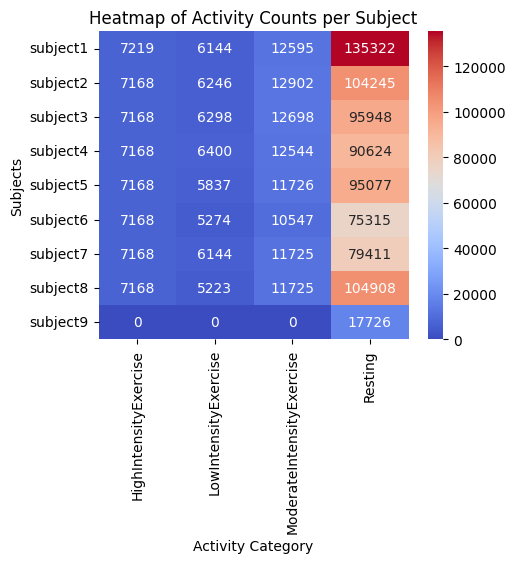

In [6]:
activity_counts_per_subject = source_df.groupby(["subject", "activity_category"]).size().unstack(fill_value=0)
activity_counts_per_subject.plot(kind='bar', figsize=(7, 6), stacked=True)
plt.xlabel("Subjects")
plt.ylabel("Activity Counts")
plt.title("Activity Counts per Subject")
plt.legend(title="Activity Category")
plt.xticks(rotation=45)
plt.show()

plt.figure(figsize=(5,4))
sns.heatmap(activity_counts_per_subject, annot=True, cmap="coolwarm", fmt="d")
plt.xlabel("Activity Category")
plt.ylabel("Subjects")
plt.title("Heatmap of Activity Counts per Subject")
plt.show()

####  we can use subject 4 and 5 for our evaluation subject

In [7]:
df = source_df.copy()
#df["activity_category_num"] = df["activity_category"].astype("category").cat.codes
#category_mapping = dict(zip(df["activity_category"].astype("category").cat.categories, 
#                            range(len(df["activity_category"].astype("category").cat.categories))))
custom_order = ["Resting", "LowIntensityExercise", "ModerateIntensityExercise", "HighIntensityExercise"]
df["activity_category"] = pd.Categorical(df["activity_category"], categories=custom_order, ordered=True)
df["activity_category_num"] = df["activity_category"].cat.codes
category_mapping = dict(zip(df["activity_category"].cat.categories, range(len(df["activity_category"].cat.categories))))
print(category_mapping)


{'Resting': 0, 'LowIntensityExercise': 1, 'ModerateIntensityExercise': 2, 'HighIntensityExercise': 3}


In [8]:
df.columns

Index(['alx', 'aly', 'alz', 'glx', 'gly', 'glz', 'arx', 'ary', 'arz', 'grx',
       'gry', 'grz', 'Activity', 'subject', 'activity_10_category',
       'activity_category', 'activity_category_num'],
      dtype='object')

In [9]:
column_names = [ "accel_left_x", "accel_left_y", "accel_left_z","gyro_left_x", "gyro_left_y", "gyro_left_z",
    "accel_right_x", "accel_right_y", "accel_right_z", "gyro_right_x", "gyro_right_y", "gyro_right_z",
    "activity", "subject", "activity_10_category", "activity_category", "activity_category_num" ]

lf_acc, lf_gry = ['accel_left_x', 'accel_left_y', 'accel_left_z'] , ['gyro_left_x', 'gyro_left_y', 'gyro_left_z']
rt_acc, rt_gry  = ['accel_right_x', 'accel_right_y', 'accel_right_z'], ['gyro_right_x', 'gyro_right_y', 'gyro_right_z']
df.columns = column_names
df["activity_category_num"] = df["activity_category"].astype("category").cat.codes
df['subject'] = df['subject'].astype('category')
df['activity'] = df['activity'].astype('category')
df.head()

,accel_left_x,accel_left_y,accel_left_z,gyro_left_x,gyro_left_y,gyro_left_z,accel_right_x,accel_right_y,accel_right_z,gyro_right_x,gyro_right_y,gyro_right_z,activity,subject,activity_10_category,activity_category,activity_category_num
0,2.1849,-9.6967,0.63077,0.103900,-0.84053,-0.68762,-8.6499,-4.5781,0.187760,-0.44902,-1.0103,0.034483,0,subject1,Resting,Resting,0
1,2.3876,-9.5080,0.68389,0.085343,-0.83865,-0.68369,-8.6275,-4.3198,0.023595,-0.44902,-1.0103,0.034483,0,subject1,Resting,Resting,0
2,2.4086,-9.5674,0.68113,0.085343,-0.83865,-0.68369,-8.5055,-4.2772,0.275720,-0.44902,-1.0103,0.034483,0,subject1,Resting,Resting,0
3,2.1814,-9.4301,0.55031,0.085343,-0.83865,-0.68369,-8.6279,-4.3163,0.367520,-0.45686,-1.0082,0.025862,0,subject1,Resting,Resting,0
4,2.4173,-9.3889,0.71098,0.085343,-0.83865,-0.68369,-8.7008,-4.1459,0.407290,-0.45686,-1.0082,0.025862,0,subject1,Resting,Resting,0


In [10]:
import pandas as pd

pd.set_option('display.max_rows', None)  
pd.set_option('display.max_columns', None)  
pd.set_option('display.width', None)  
pd.set_option('display.max_colwidth', None)  
df['row_index'] = df.index
result = df.groupby(["subject", "activity_10_category"])["row_index"].agg(["min", "max"])
result

/var/folders/p7/ndj4bdjd7sz9qctplsv33b0m0000gn/T/ipykernel_19072/3505429392.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  result = df.groupby(["subject", "activity_10_category"])["row_index"].agg(["min", "max"])


min       max
subject  activity_10_category                               
subject1 Climbing stairs (1 min)          157184.0  160255.0
         Cycling (1 min)                   76083.0   79154.0
         Frontal elevation of arms (x20)   52736.0   55807.0
         Jogging (1 min)                   88064.0   91135.0
         Jump front & back (x20)          113408.0  114482.0
         Knees bending (crouching) (x20)   61440.0   64818.0
         Lying down (1 min)                18944.0   22015.0
         Resting                               0.0  161279.0
         Running (1 min)                   98816.0  101887.0
         Sitting and relaxing (1 min)      12800.0   15871.0
         Standing still (1 min)             6656.0    9727.0
         Waist bends forward (x20)         37376.0   40447.0
         Walking (1 min)                   28160.0   31231.0
subject2 Climbing stairs (1 min)          175872.0  178943.0
         Cycling (1 min)                  284928.0  287999.0
         Frontal elevation of arms (x20)  239872.0  243199.0
         Jogging (1 min)                  253440.0  256511.0
         Jump front & back (x20)          274176.0  275199.0
         Knees bending (crouching) (x20)  245248.0  248677.0
         Lying down (1 min)               217344.0  220415.0
         Resting                          161280.0  291840.0
         Running (1 min)                  264960.0  268031.0
         Sitting and relaxing (1 min)     211200.0  214271.0
         Standing still (1 min)           205056.0  208127.0
         Waist bends forward (x20)        232704.0  235877.0
         Walking (1 min)                  223744.0  226815.0
subject3 Climbing stairs (1 min)          409345.0  412416.0
         Cycling (1 min)                  347137.0  350208.0
         Frontal elevation of arms (x20)  333313.0  336691.0
         Jogging (1 min)                  355841.0  358912.0
         Jump front & back (x20)          377857.0  378880.0
         Knees bending (crouching) (x20)  338125.0  341299.0
         Lying down (1 min)               308225.0  311296.0
         Resting                          291841.0  413952.0
         Running (1 min)                  364545.0  367616.0
         Sitting and relaxing (1 min)     302081.0  305152.0
         Standing still (1 min)           296449.0  299520.0
         Waist bends forward (x20)        327271.0  330496.0
         Walking (1 min)                  316417.0  319488.0
subject4 Climbing stairs (1 min)          416257.0  419328.0
         Cycling (1 min)                  508673.0  511744.0
         Frontal elevation of arms (x20)  487783.0  491059.0
         Jogging (1 min)                  514561.0  517632.0
         Jump front & back (x20)          527617.0  528640.0
         Knees bending (crouching) (x20)  498023.0  501145.0
         Lying down (1 min)               464641.0  467712.0
         Resting                          413953.0  530688.0
         Running (1 min)                  521985.0  525056.0
         Sitting and relaxing (1 min)     459521.0  462592.0
         Standing still (1 min)           454145.0  457216.0
         Waist bends forward (x20)        482407.0  485734.0
         Walking (1 min)                  471297.0  474368.0
subject5 Climbing stairs (1 min)          642817.0  645888.0
         Cycling (1 min)                  572161.0  575232.0
         Frontal elevation of arms (x20)  559873.0  562740.0
         Jogging (1 min)                  579841.0  582912.0
         Jump front & back (x20)          602881.0  603904.0
         Knees bending (crouching) (x20)  564481.0  567194.0
         Lying down (1 min)               542977.0  546048.0
         Resting                          530689.0  650496.0
         Running (1 min)                  589057.0  592128.0
         Sitting and relaxing (1 min)     538369.0  541440.0
         Standing still (1 min)           533761.0  536832.0
         Waist bends forward (x20)        555265.0  558029.0
         Walking (1 m

In [11]:
#source_df['row_index'] = source_df.index
#result = source_df.groupby(["subject", "Activity"])["row_index"].agg(["min", "max"])
#result

In [12]:
df.head(3)

,accel_left_x,accel_left_y,accel_left_z,gyro_left_x,gyro_left_y,gyro_left_z,accel_right_x,accel_right_y,accel_right_z,gyro_right_x,gyro_right_y,gyro_right_z,activity,subject,activity_10_category,activity_category,activity_category_num,row_index
0,2.1849,-9.6967,0.63077,0.103900,-0.84053,-0.68762,-8.6499,-4.5781,0.187760,-0.44902,-1.0103,0.034483,0,subject1,Resting,Resting,0,0
1,2.3876,-9.5080,0.68389,0.085343,-0.83865,-0.68369,-8.6275,-4.3198,0.023595,-0.44902,-1.0103,0.034483,0,subject1,Resting,Resting,0,1
2,2.4086,-9.5674,0.68113,0.085343,-0.83865,-0.68369,-8.5055,-4.2772,0.275720,-0.44902,-1.0103,0.034483,0,subject1,Resting,Resting,0,2


### activity 5 timestamps is werid

In [24]:
import matplotlib.pyplot as plt


    

def plot_all_subjects_per_activity(df, cat_type, accel_cols, gyro_cols, title_prefix, sampling_rate, activity_id):
    if "row_index" not in df.columns:
        df["row_index"] = df.index  

    df_filtered = df[df[cat_type] == activity_id]

    print(f"Filtered data shape: {df_filtered.shape}")
    if df_filtered.empty:
        print("No data available for this activity.")
        return  

    subjects = df_filtered["subject"].unique()

    for subject in subjects:
        df_subject = df_filtered[df_filtered["subject"] == subject]

        if len(df_subject) > sampling_rate:
            df_subject = df_subject.iloc[::min(sampling_rate, 100)]  

        print(f"Subject: {subject}, Data shape after sampling: {df_subject.shape}")
        if df_subject.empty:
            print(f"No valid data for subject {subject} after sampling.")
            continue  
        fig, axes = plt.subplots(2, 1, figsize=(8, 6), sharex=True)

        axes[0].plot(df_subject["row_index"], df_subject[accel_cols[0]], label="Ax", alpha=0.7, color="blue")
        axes[0].plot(df_subject["row_index"], df_subject[accel_cols[1]], label="Ay", alpha=0.7, color="red")
        axes[0].plot(df_subject["row_index"], df_subject[accel_cols[2]], label="Az", alpha=0.7, color="orange")
        axes[0].set_ylabel("Acceleration (m/s²)")
        axes[0].set_title(f"{title_prefix} Accelerometer Data - {subject}")
        axes[0].legend()
        axes[1].plot(df_subject["row_index"], df_subject[gyro_cols[0]], label="Gx", alpha=0.7, color="blue")
        axes[1].plot(df_subject["row_index"], df_subject[gyro_cols[1]], label="Gy", alpha=0.7, color="red")
        axes[1].plot(df_subject["row_index"], df_subject[gyro_cols[2]], label="Gz", alpha=0.7, color="orange")
        axes[1].set_ylabel("Angular Velocity (°/s)")
        axes[1].set_xlabel("Row Index (Time)")
        axes[1].set_title(f"{title_prefix} Gyroscope Data - {subject}")
        axes[1].legend()
        plt.tight_layout()
        plt.show()


def plot_composite_feature_aligned(df, cat_type, accel_cols, gyro_cols, title_prefix, sampling_rate, activity_id):
    df_filtered = df[df[cat_type] == activity_id].reset_index(drop=True)
    
    print(f"Filtered data shape: {df_filtered.shape}")
    if df_filtered.empty:
        print("No data available for this activity.")
        return  

    subjects = df_filtered["subject"].unique()
    fig, axes = plt.subplots(2, 1, figsize=(10, 6), sharex=True)

    for subject in subjects:
        df_subject = df_filtered[df_filtered["subject"] == subject].copy()

        df_subject = df_subject.reset_index(drop=True)
        df_subject["time"] = df_subject.index 

        if len(df_subject) > sampling_rate:
            df_subject = df_subject.iloc[::min(sampling_rate, 100)]  

        print(f"Subject: {subject}, Data shape after sampling: {df_subject.shape}")
        if df_subject.empty:
            print(f"No valid data for subject {subject} after sampling.")
            continue  

        df_subject["composite_accel"] = np.sqrt(df_subject[accel_cols[0]]**2 + df_subject[accel_cols[1]]**2 + df_subject[accel_cols[2]]**2)
        df_subject["composite_gyro"] = np.sqrt(df_subject[gyro_cols[0]]**2 + df_subject[gyro_cols[1]]**2 + df_subject[gyro_cols[2]]**2)

        df_subject["composite_accel"] = (df_subject["composite_accel"] - df_subject["composite_accel"].min()) / (df_subject["composite_accel"].max() - df_subject["composite_accel"].min())
        df_subject["composite_gyro"] = (df_subject["composite_gyro"] - df_subject["composite_gyro"].min()) / (df_subject["composite_gyro"].max() - df_subject["composite_gyro"].min())

        axes[0].plot(df_subject["time"], df_subject["composite_accel"], label=f"{subject}", alpha=0.7)
        axes[1].plot(df_subject["time"], df_subject["composite_gyro"], label=f"{subject}", alpha=0.7)

    axes[0].set_ylabel("Normalized Composite Acceleration")
    axes[0].set_title(f"{title_prefix} Composite Acceleration - Activity {activity_id}")
    axes[0].legend()

    axes[1].set_ylabel("Normalized Composite Gyroscope")
    axes[1].set_xlabel("Time (Normalized)")
    axes[1].set_title(f"{title_prefix} Composite Gyroscope - Activity {activity_id}")
    axes[1].legend()

    plt.tight_layout()
    plt.show()
    

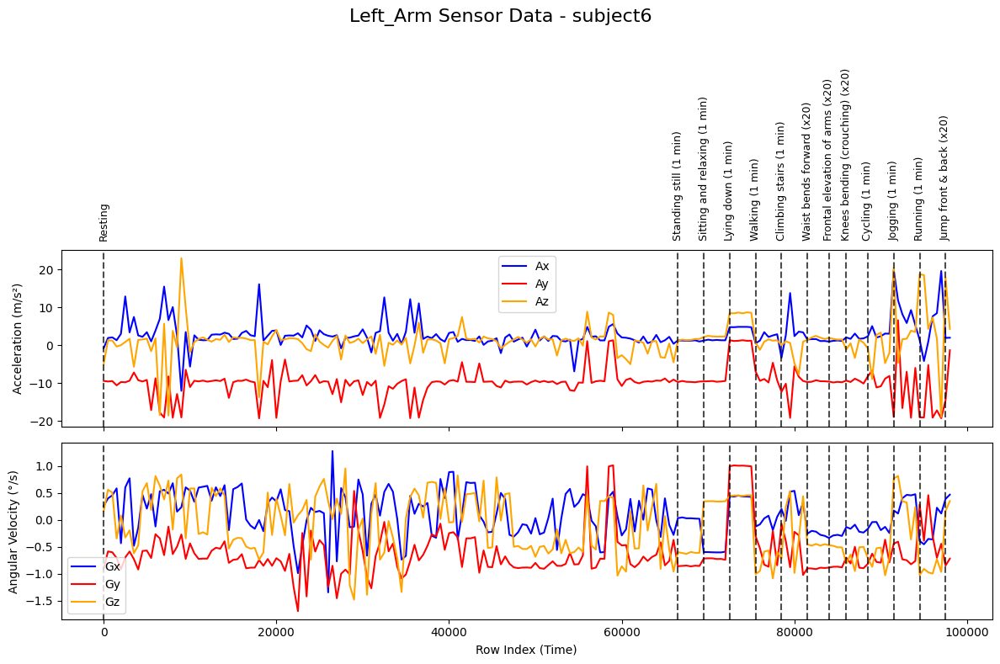

In [14]:
def plot_activity_data_by_subject(df, activity_col, accel_cols, gyro_cols, title_prefix, sampling_rate, subject_id):
    df_subject = df[df["subject"] == subject_id].copy()
    
    df_subject = df_subject.sort_values(by=[activity_col]).reset_index(drop=True)
    
    df_subject = df_subject.iloc[::sampling_rate].copy()
    
    df_subject["row_index"] = df_subject.index

    fig, axes = plt.subplots(2, 1, figsize=(12, 8), sharex=True)

    axes[0].plot(df_subject["row_index"], df_subject[accel_cols[0]], label="Ax", color="blue")
    axes[0].plot(df_subject["row_index"], df_subject[accel_cols[1]], label="Ay", color="red")
    axes[0].plot(df_subject["row_index"], df_subject[accel_cols[2]], label="Az", color="orange")
    axes[0].set_ylabel("Acceleration (m/s²)")
    axes[0].legend()

    axes[1].plot(df_subject["row_index"], df_subject[gyro_cols[0]], label="Gx", color="blue")
    axes[1].plot(df_subject["row_index"], df_subject[gyro_cols[1]], label="Gy", color="red")
    axes[1].plot(df_subject["row_index"], df_subject[gyro_cols[2]], label="Gz", color="orange")
    axes[1].set_ylabel("Angular Velocity (°/s)")
    axes[1].set_xlabel("Row Index (Time)")
    axes[1].legend()

    unique_activities = df_subject[activity_col].unique()
    for activity in unique_activities:
        activity_indices = df_subject[df_subject[activity_col] == activity].index

        if len(activity_indices) > 0:
            transition_idx = df_subject.loc[activity_indices[0], "row_index"]
            if activity_col == 'activity_category_num':
                activity_name = df_subject.loc[activity_indices[0], "activity_category"]
            else : activity_name = df_subject.loc[activity_indices[0], "activity_10_category"]
            axes[0].axvline(x=transition_idx, color="black", linestyle="--", alpha=0.7)
            axes[1].axvline(x=transition_idx, color="black", linestyle="--", alpha=0.7)
            axes[0].text(transition_idx, axes[0].get_ylim()[1] * 1.1, str(activity_name), 
                         rotation=90, verticalalignment='bottom', horizontalalignment='center', fontsize=9, clip_on=False)

    plt.suptitle(f"{title_prefix} Sensor Data - {subject_id}", fontsize=16, y=0.98)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
    return df_subject

subject_id = "subject6" 
_ = plot_activity_data_by_subject(df, "activity", lf_acc , lf_gry, "Left_Arm", sampling_rate=500 , subject_id=subject_id)


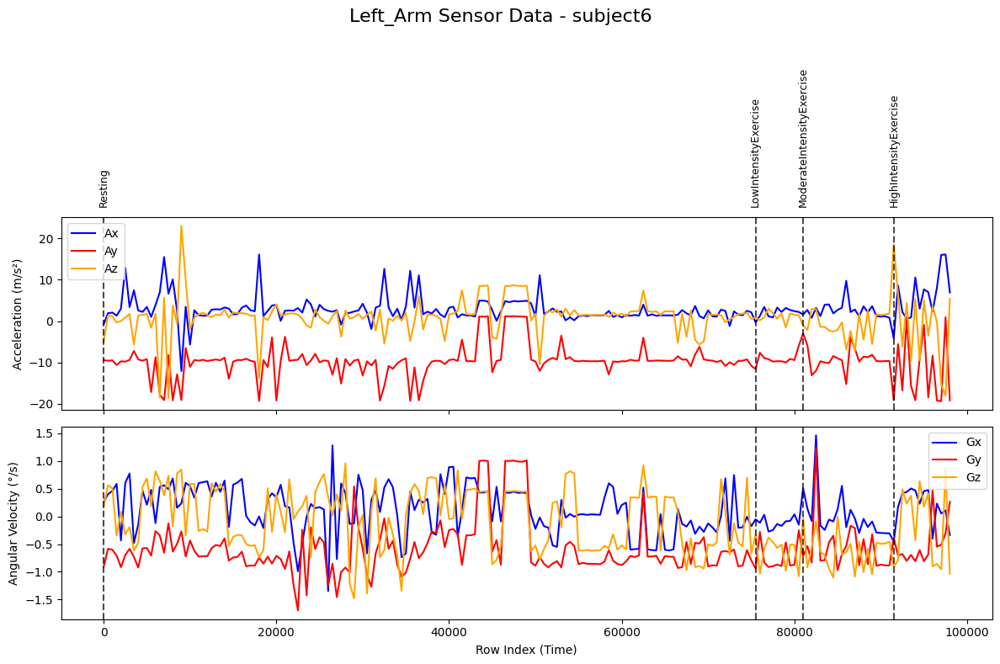

In [15]:
_ = plot_activity_data_by_subject(df, "activity_category_num", lf_acc , lf_gry, "Left_Arm", sampling_rate=500 , subject_id=subject_id)

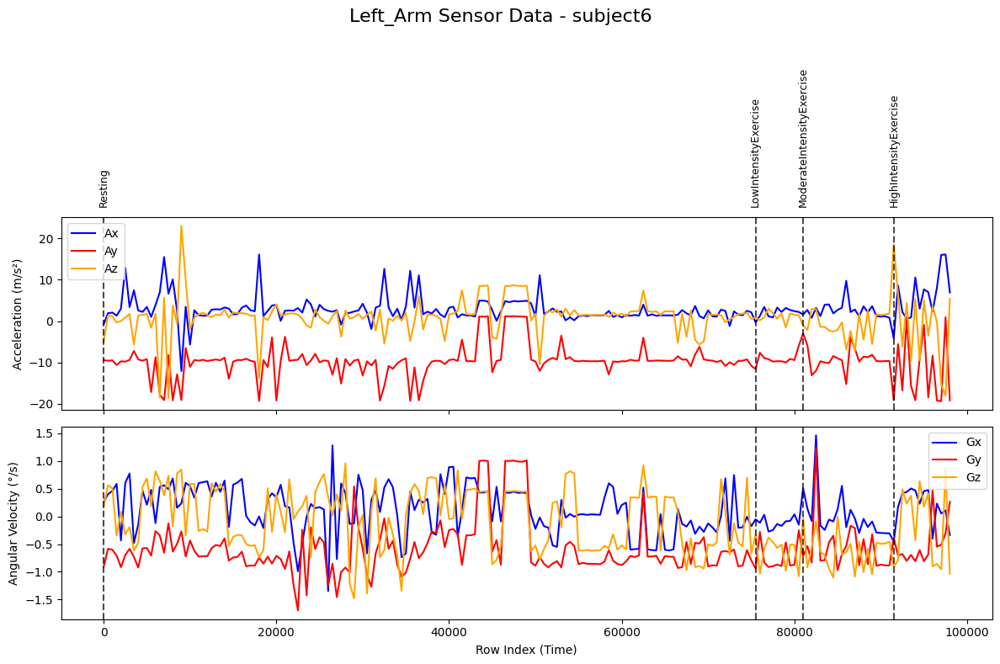

In [16]:
start_row, end_row = 0 , 0
sampling_rate = 500 
subject_id = "subject6" 
sel_cat_type = 'activity'

#_ = plot_activity_data_by_subject(df, sel_cat_type, lf_acc, lf_gry , "Left Ankle", sampling_rate, subject_id)
_ = plot_activity_data_by_subject(df, "activity_category_num", lf_acc , lf_gry, "Left_Arm", sampling_rate=500 , subject_id=subject_id)

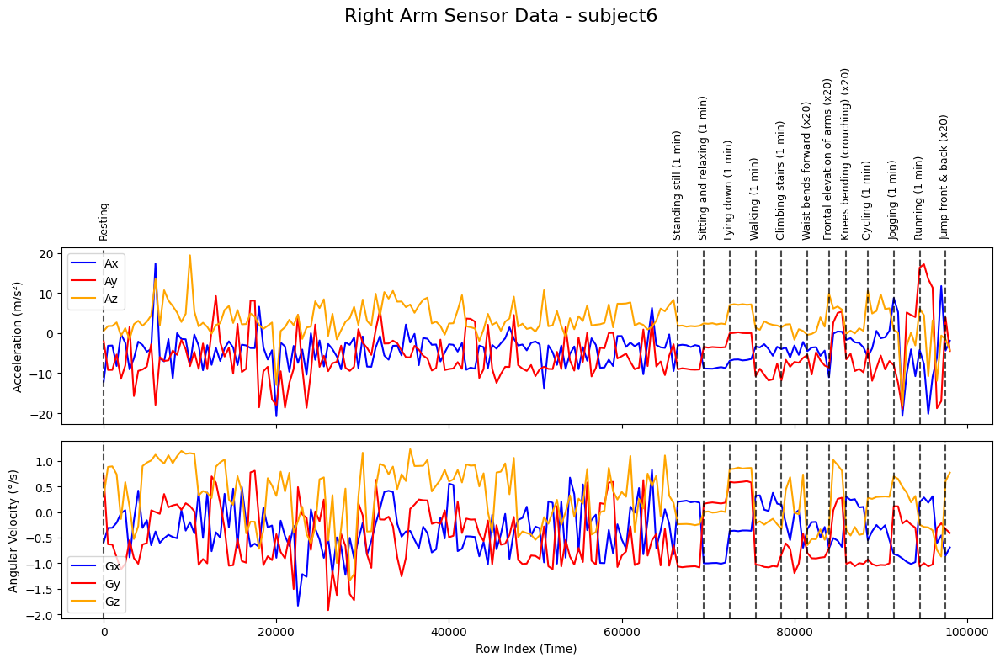

In [17]:
_ = plot_activity_data_by_subject(df, sel_cat_type, rt_acc, rt_gry , "Right Arm", sampling_rate, subject_id)

### Plot all activity per subject  (Longitudinal plot) - 13 categories

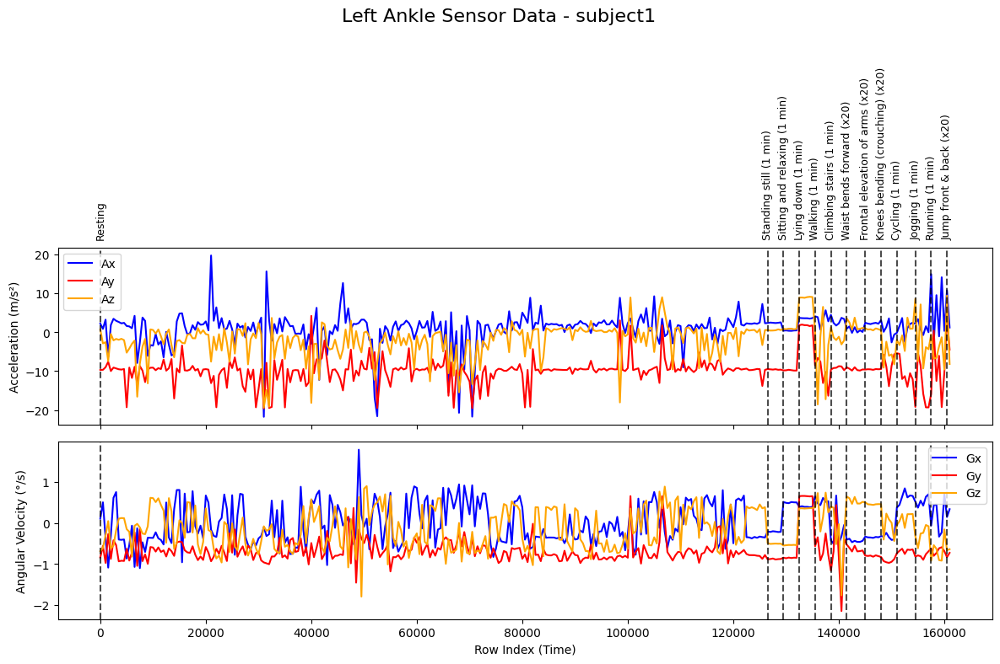

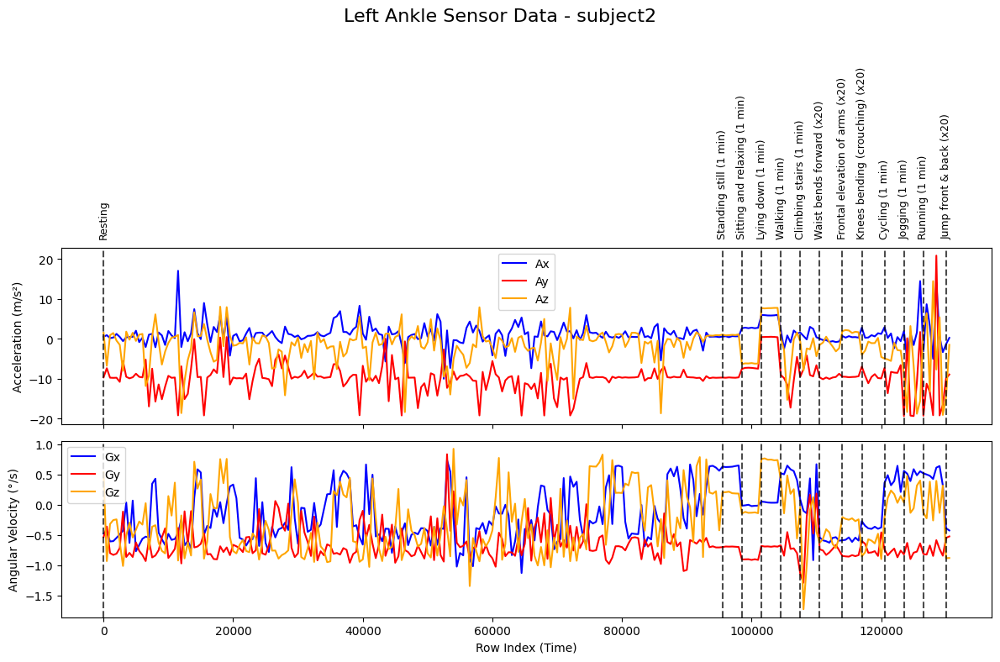

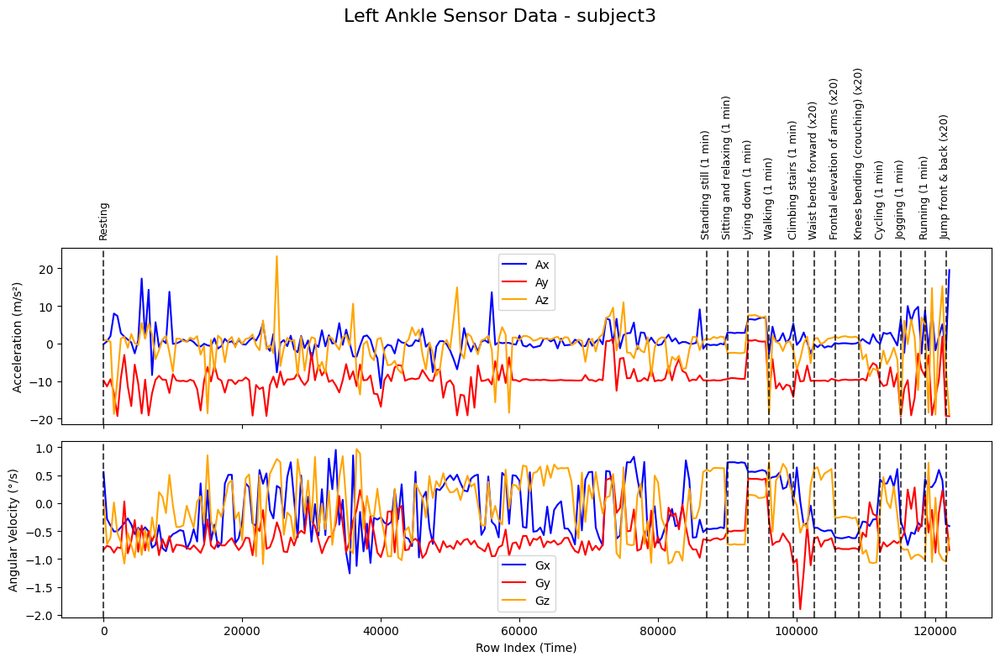

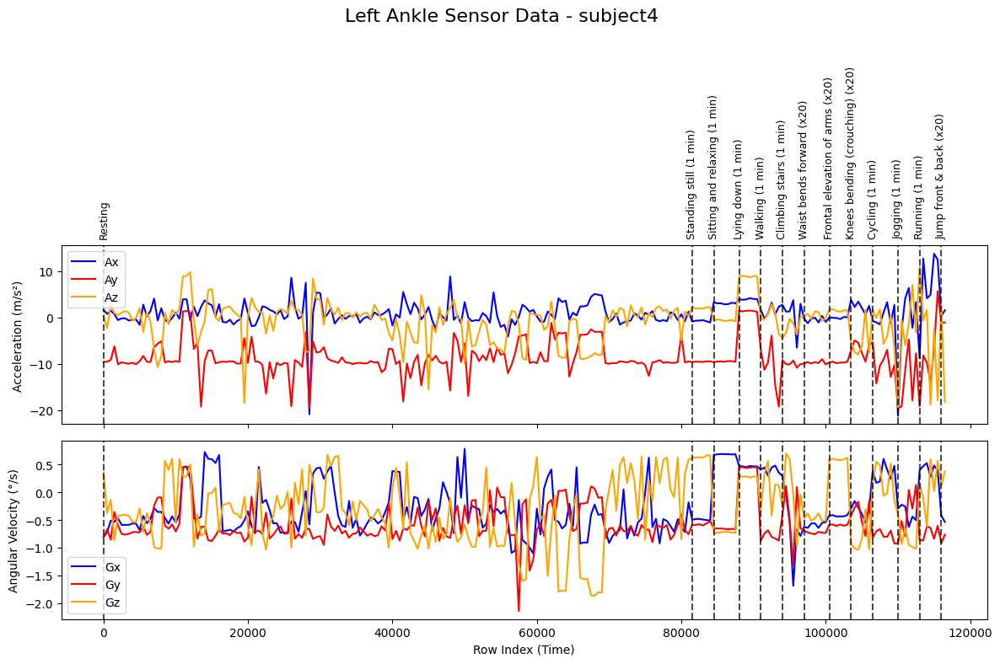

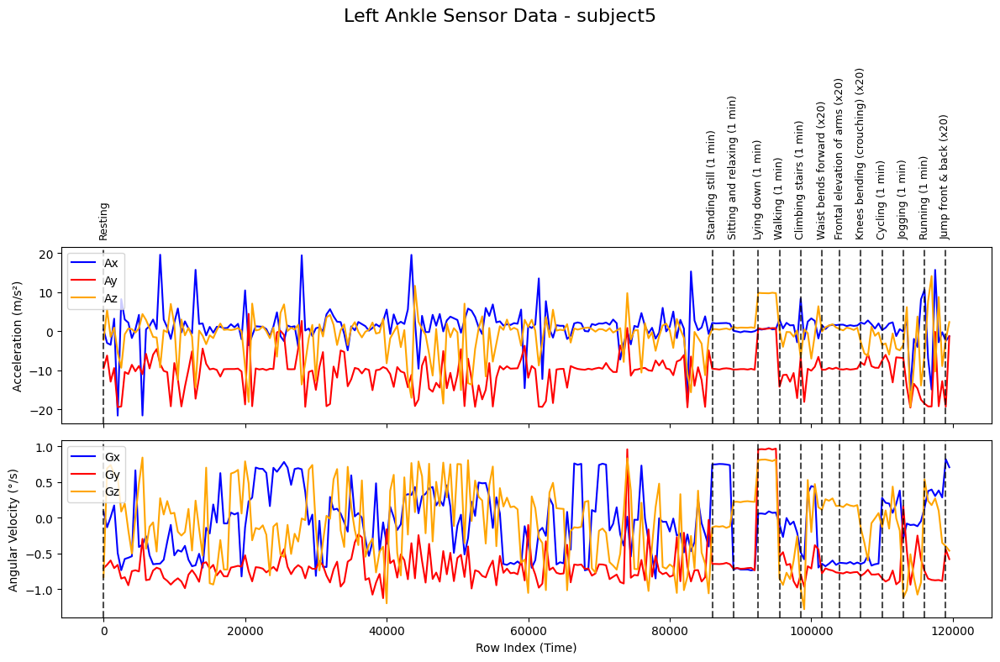

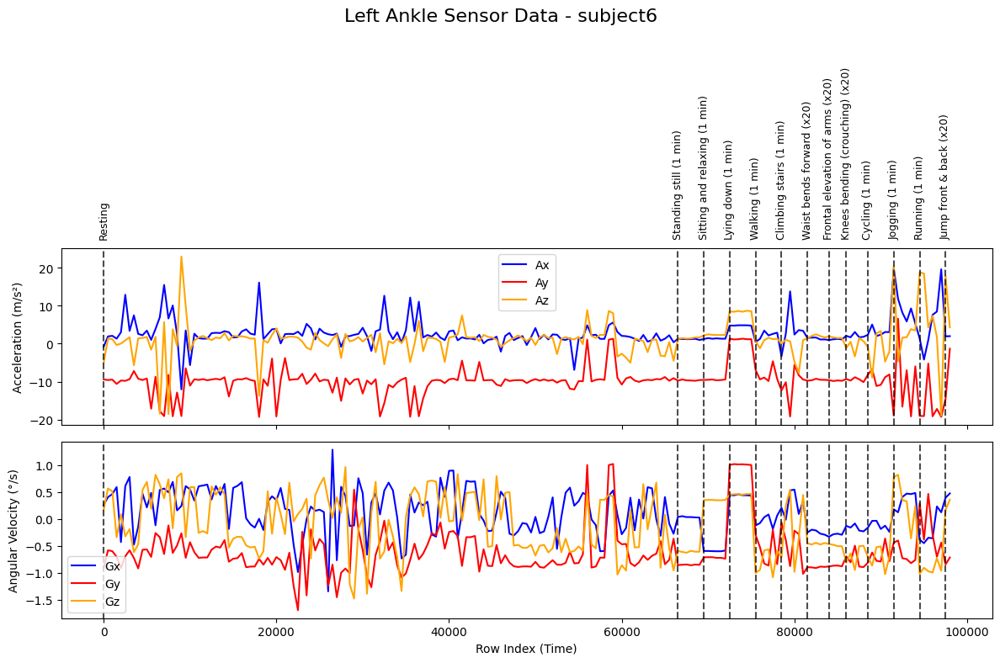

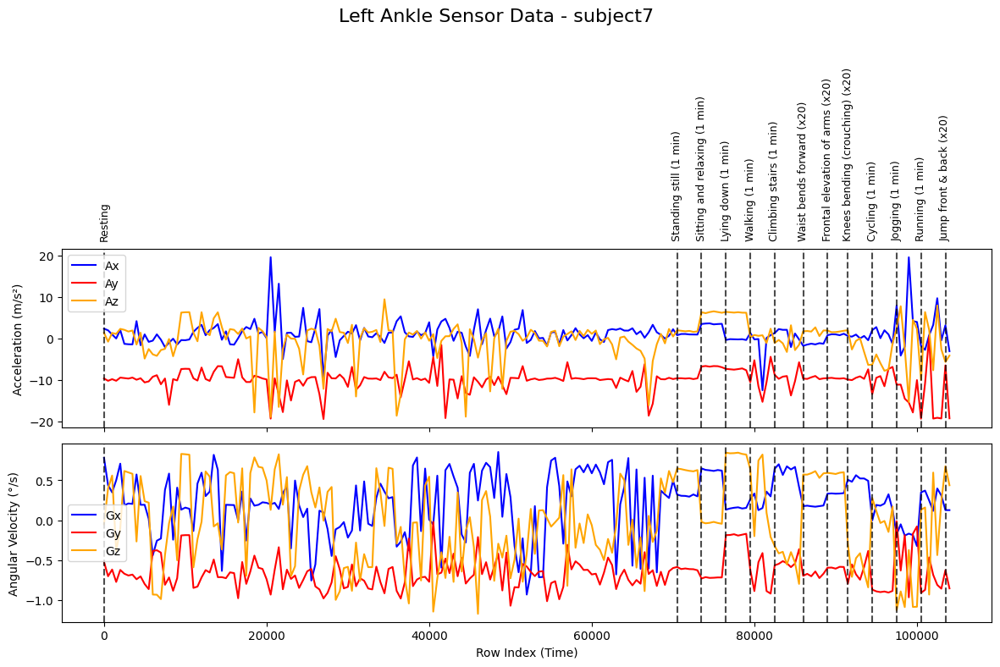

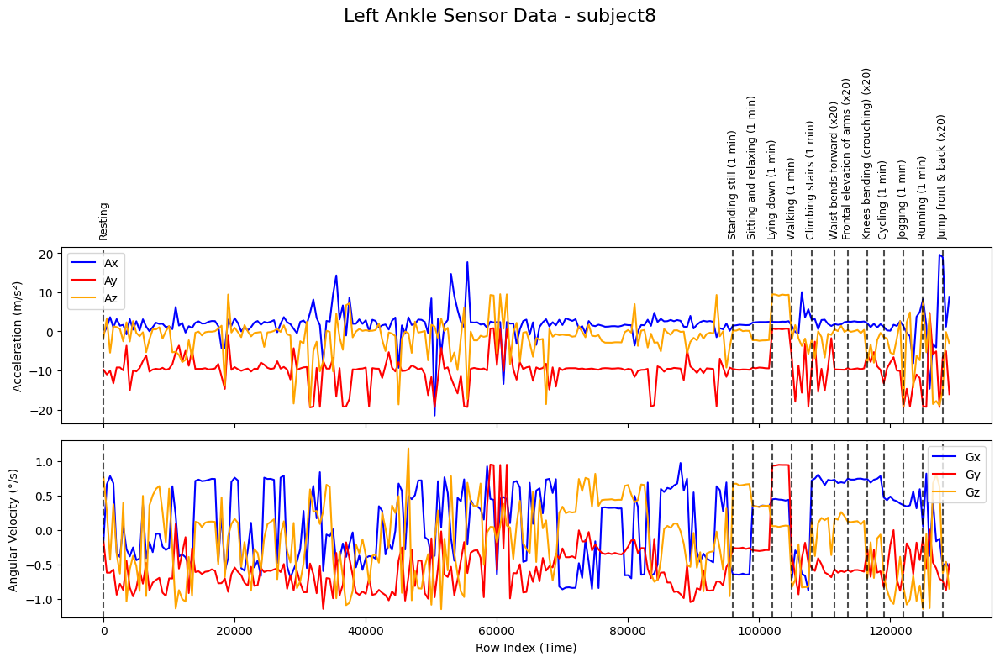

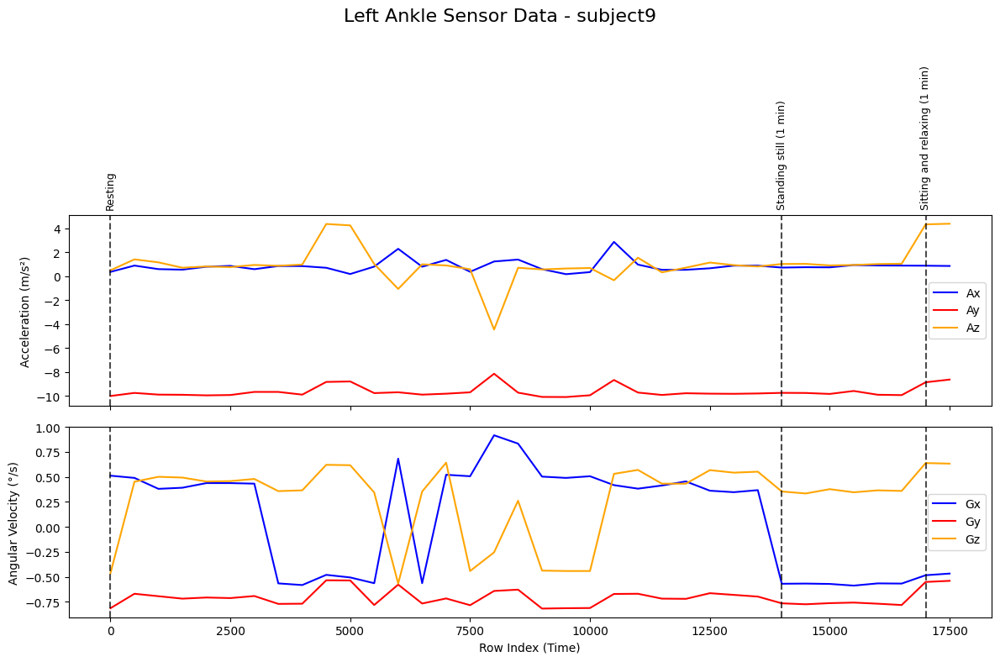

In [18]:
start_row, end_row = 0 , 0
sampling_rate = 500 
for i in range (1,10):
    subject_id = 'subject'+str(i)
    # Generate plots for the selected subject
    _ = plot_activity_data_by_subject(df, sel_cat_type, lf_acc, lf_gry , "Left Ankle", sampling_rate, subject_id)


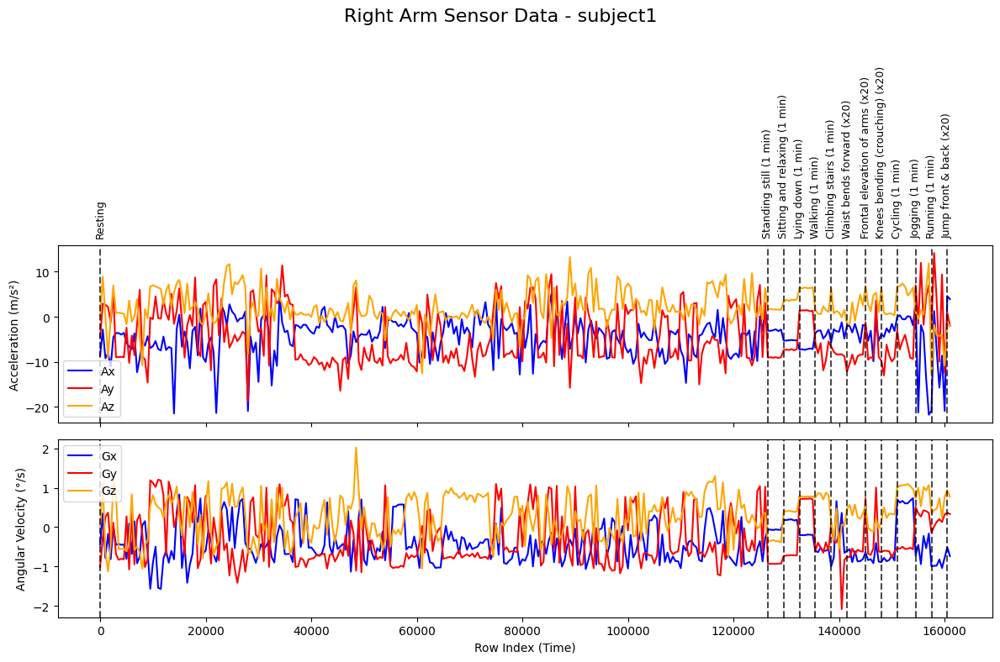

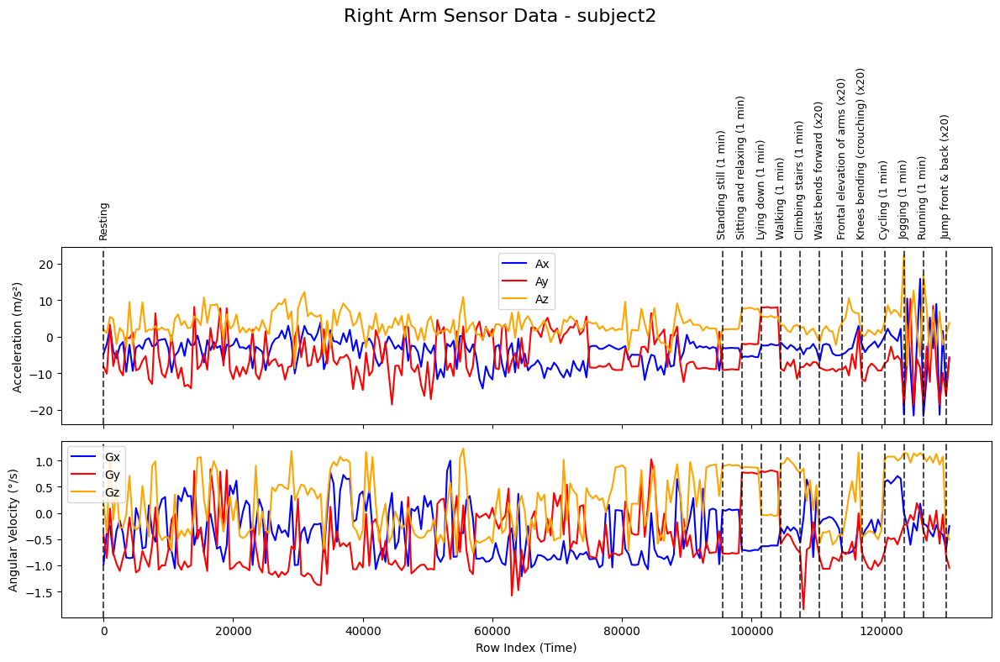

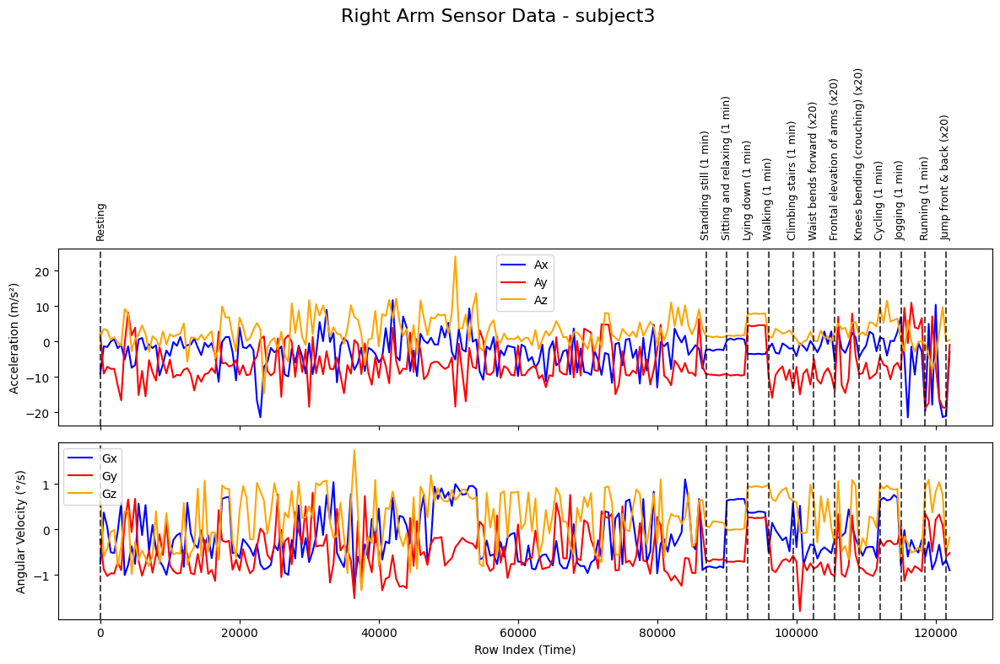

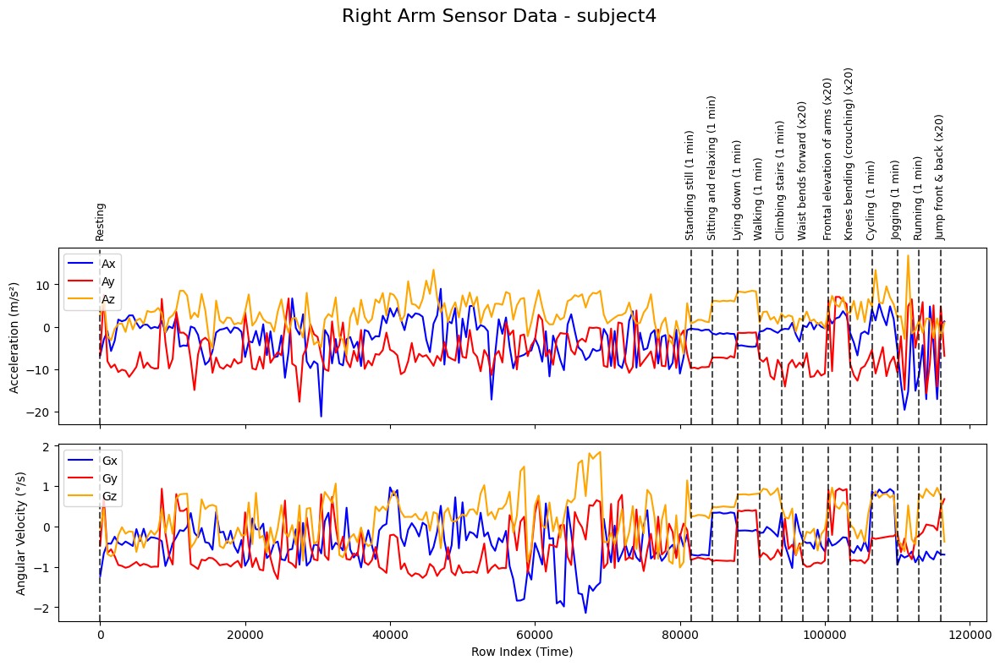

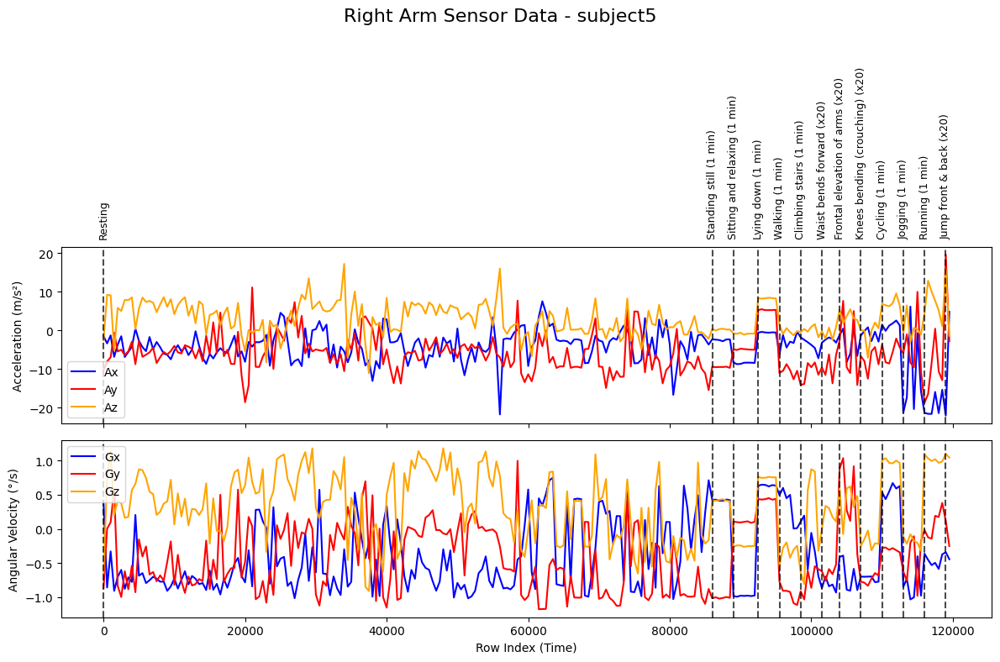

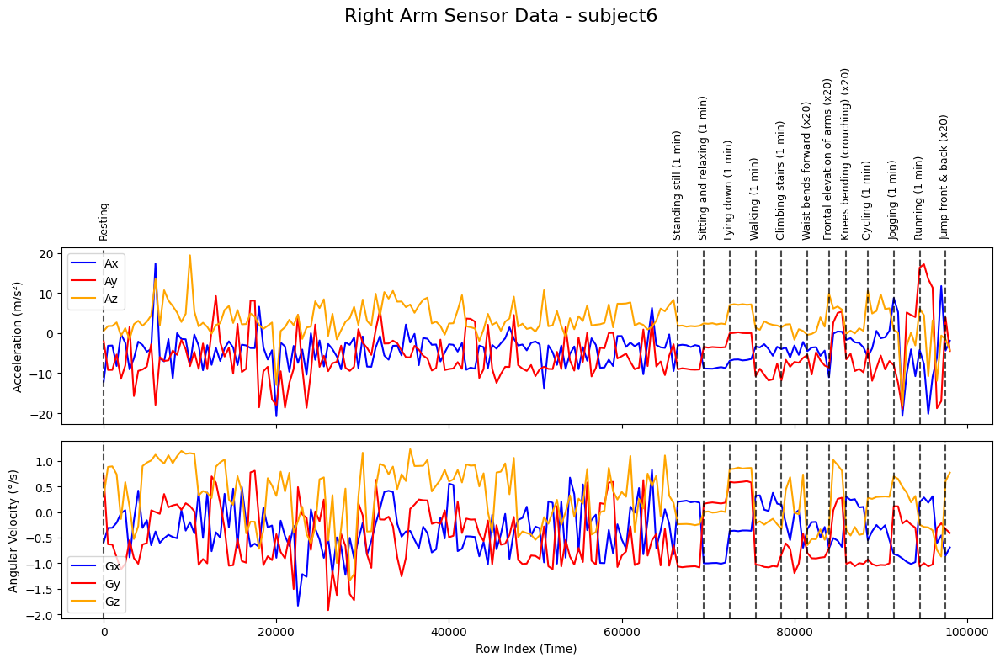

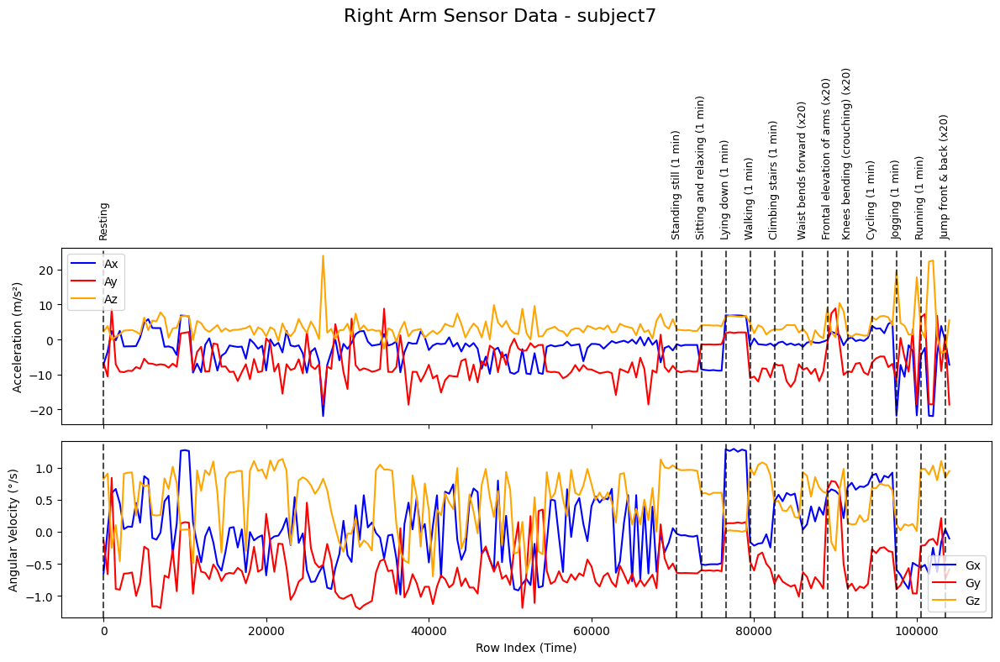

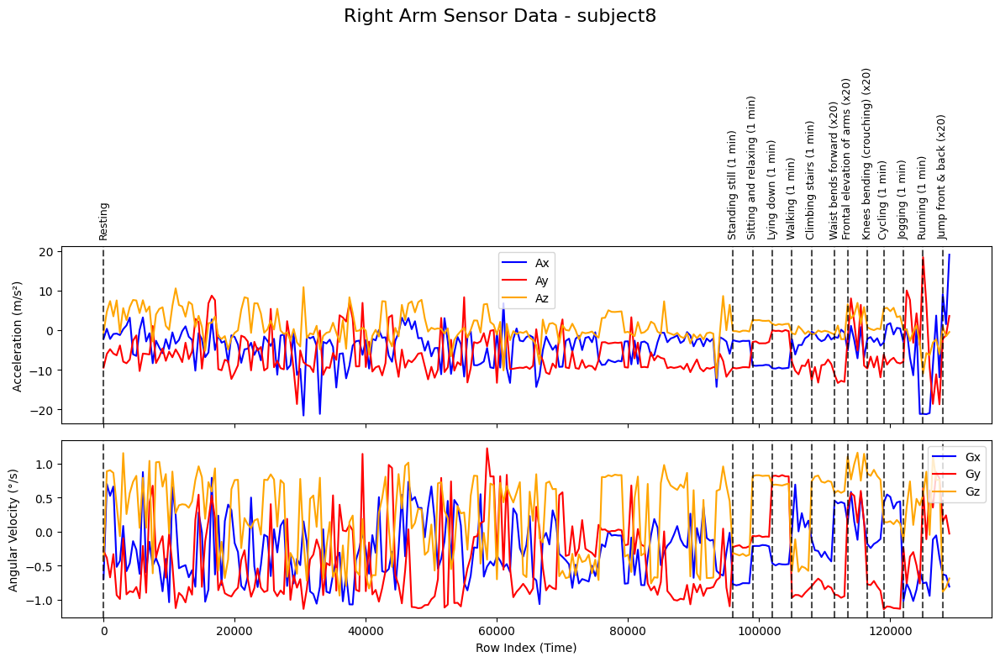

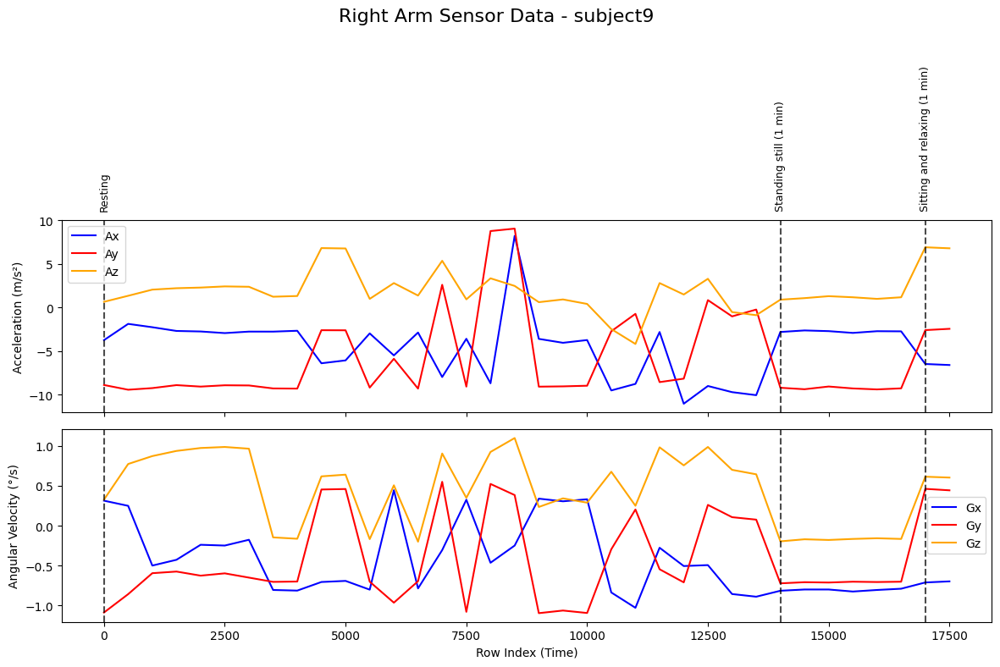

In [19]:
for i in range (1,10):
    subject_id = 'subject'+str(i)
    # Generate plots for the selected subject
    _ = plot_activity_data_by_subject(df, sel_cat_type, rt_acc, rt_gry , "Right Arm", sampling_rate, subject_id)

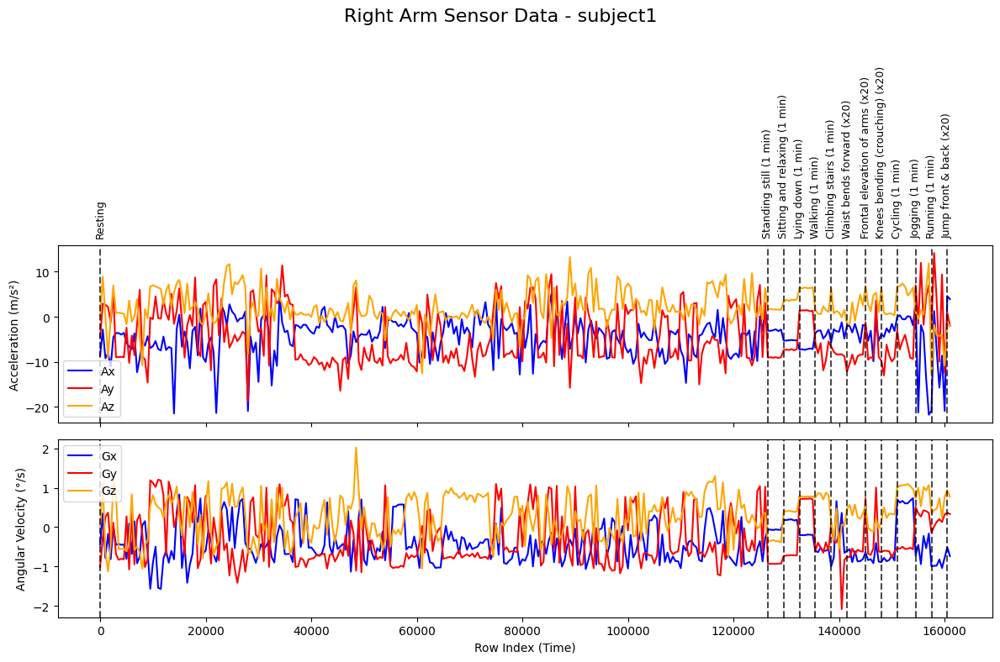

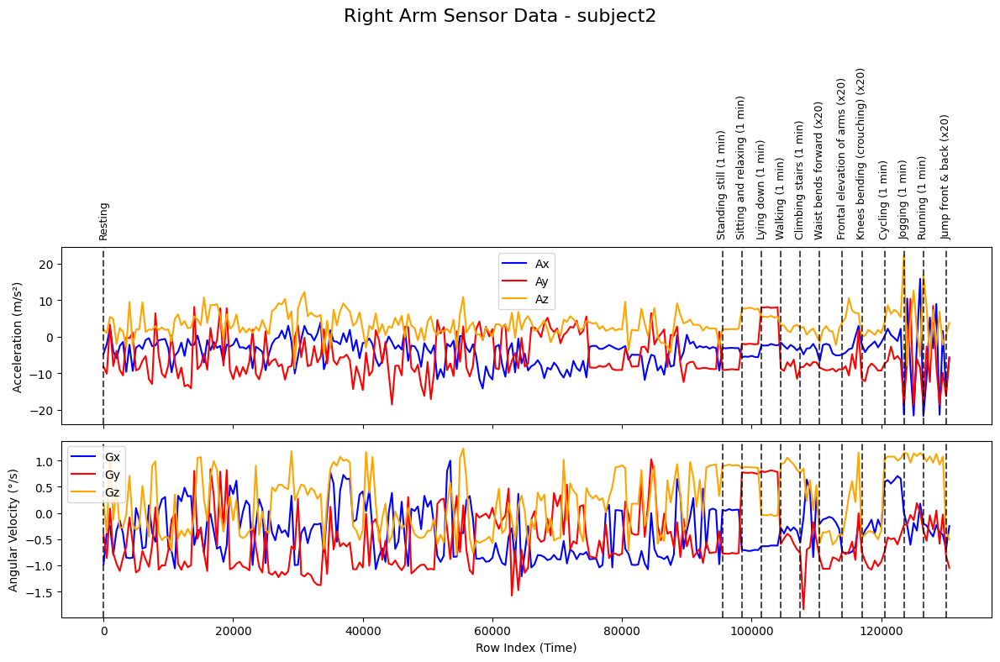

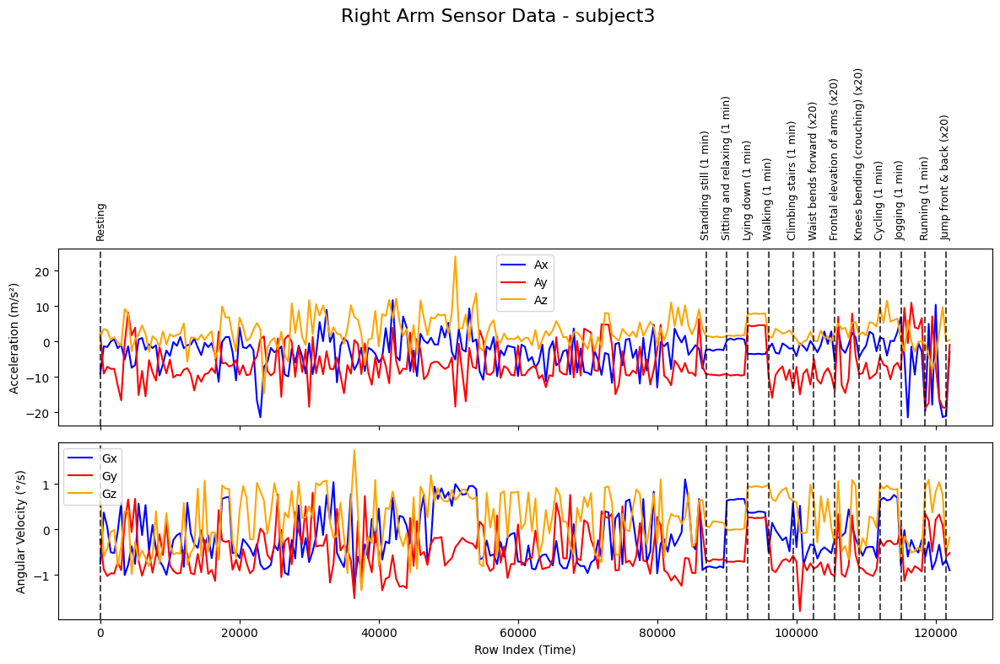

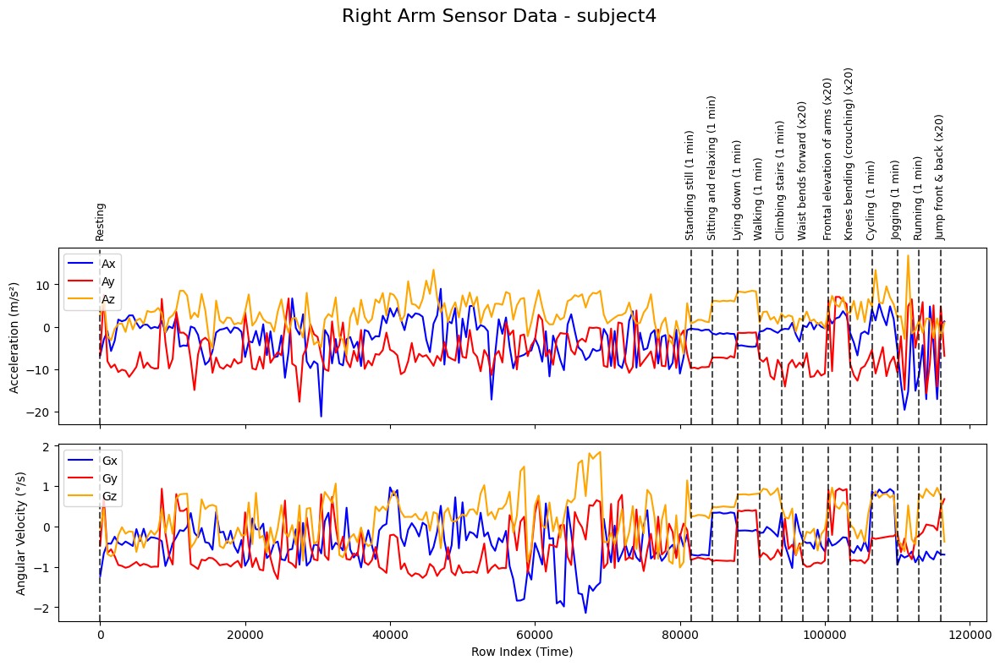

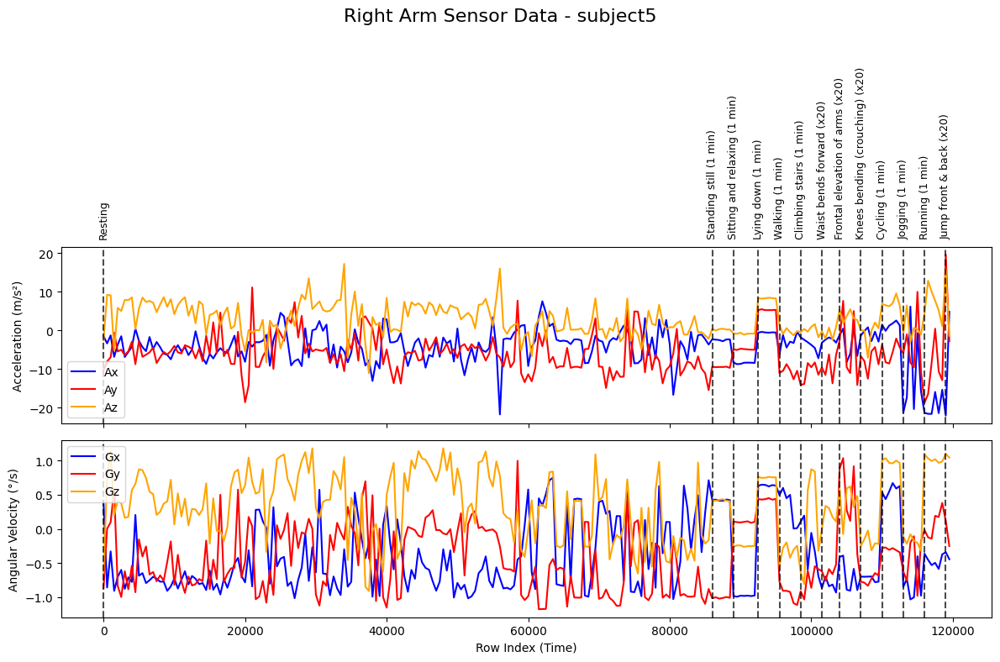

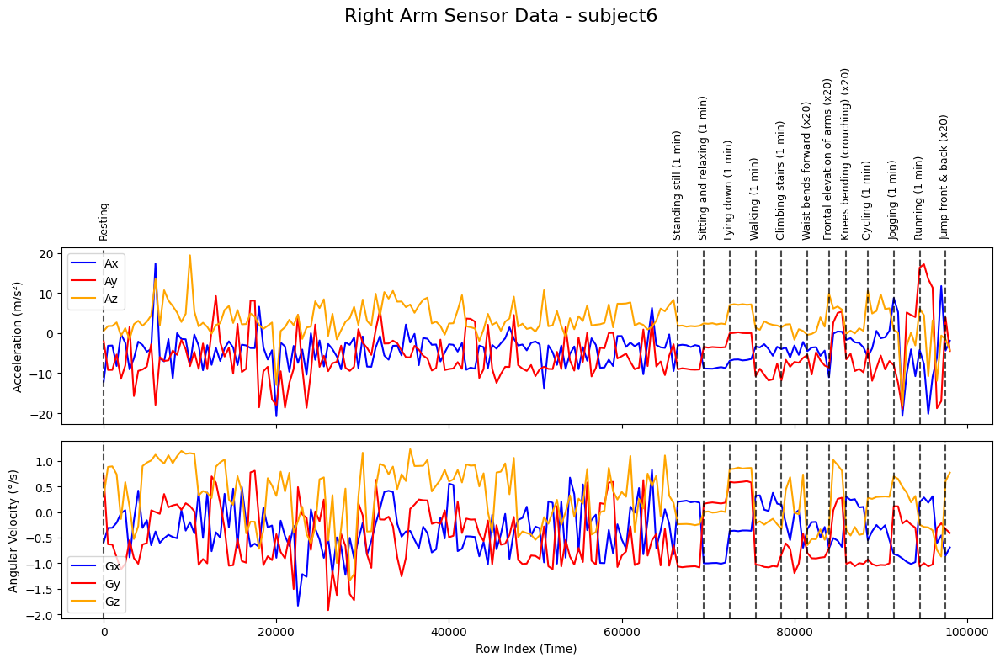

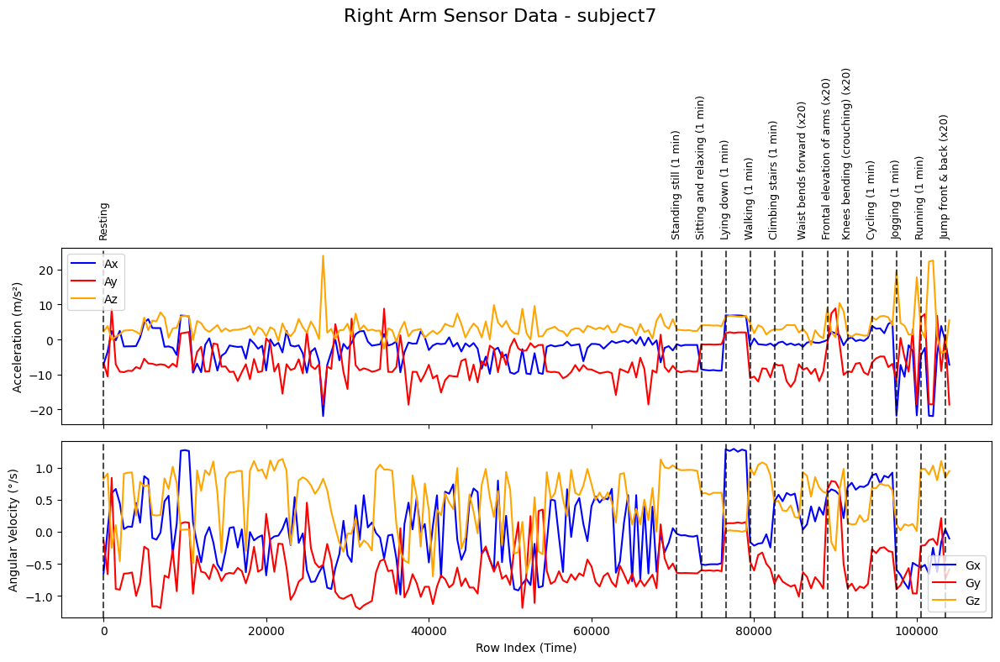

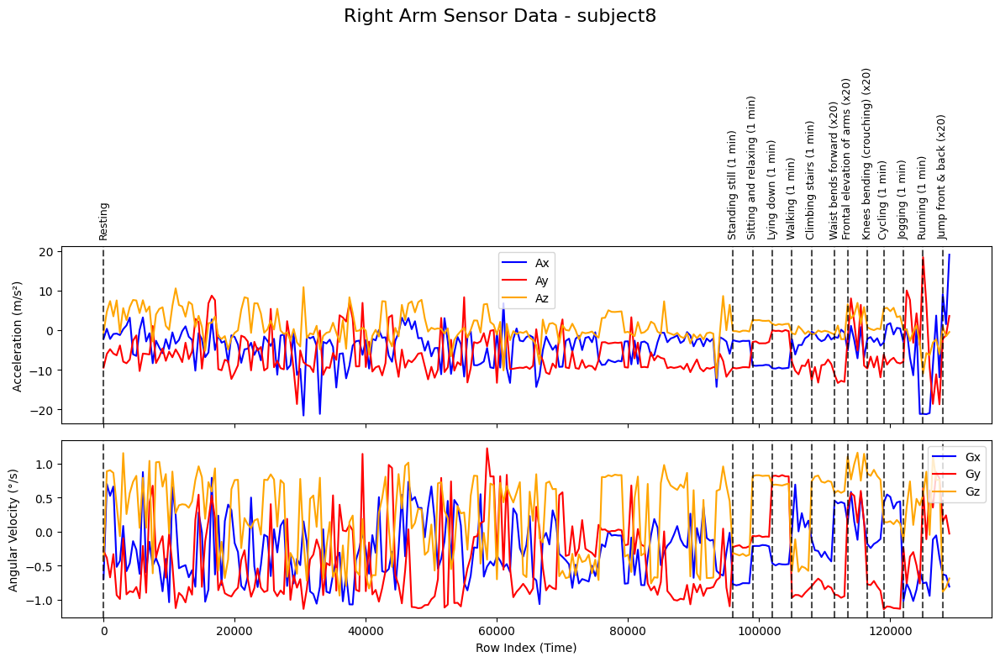

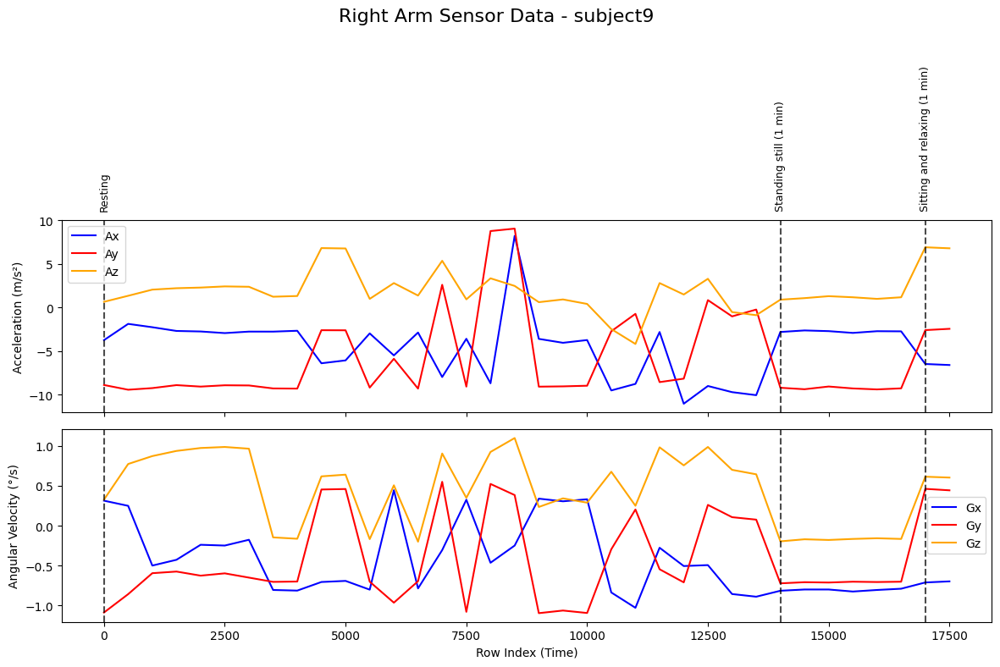

In [20]:
for i in range (1,10):
    subject_id = 'subject'+str(i)
    # Generate plots for the selected subject
    _ = plot_activity_data_by_subject(df, sel_cat_type, rt_acc, rt_gry , "Right Arm", sampling_rate, subject_id)

### Plot per subject

Filtered data shape: (720946, 18)
Subject: subject1, Data shape after sampling: (1262, 18)


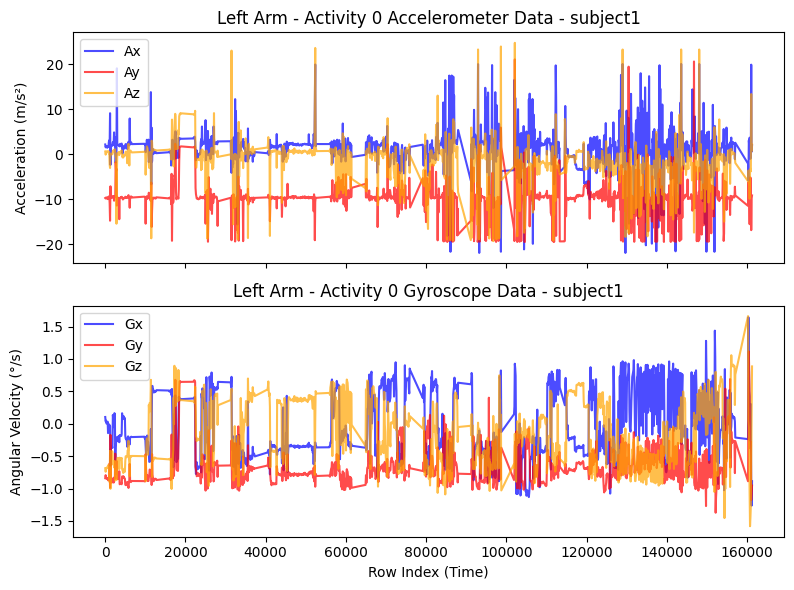

Subject: subject2, Data shape after sampling: (951, 18)


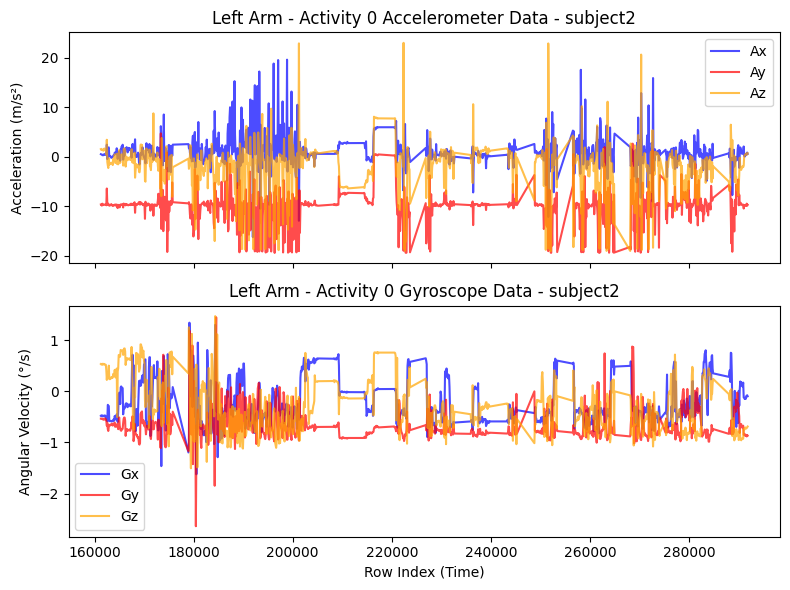

Subject: subject3, Data shape after sampling: (868, 18)


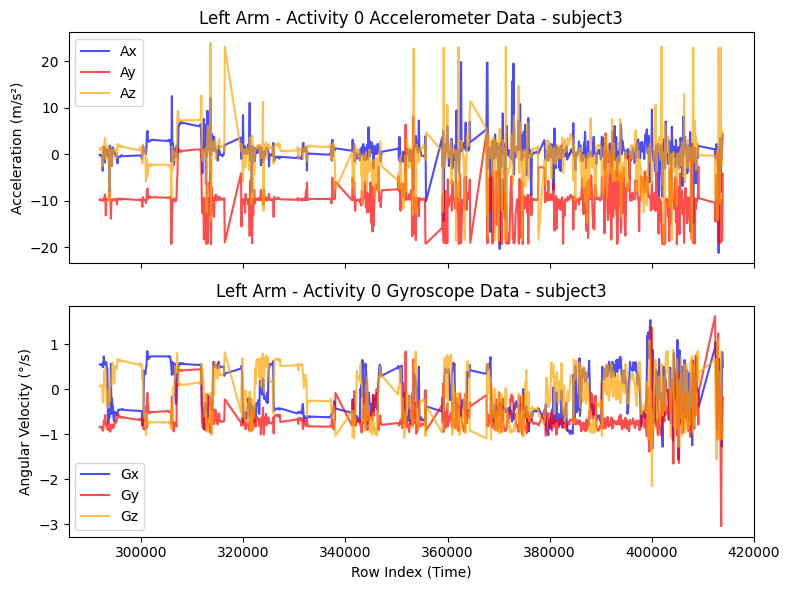

Subject: subject4, Data shape after sampling: (815, 18)


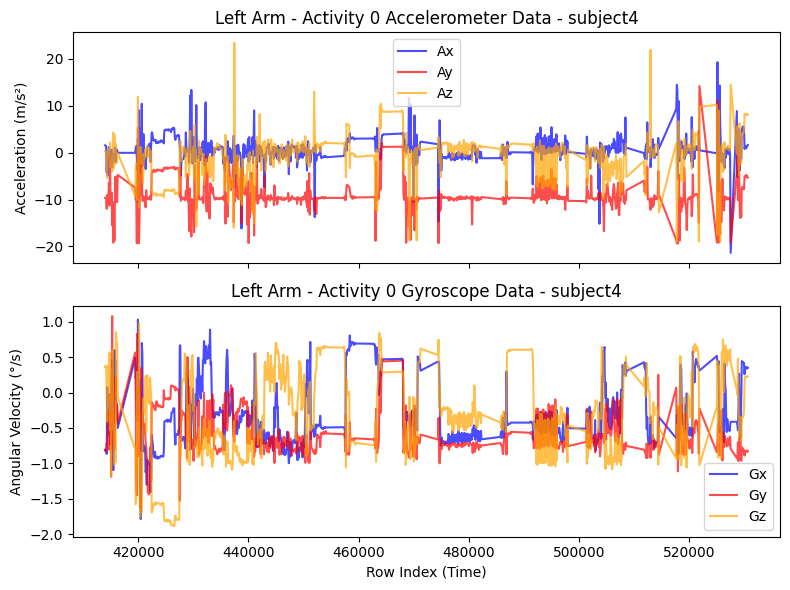

Subject: subject5, Data shape after sampling: (859, 18)


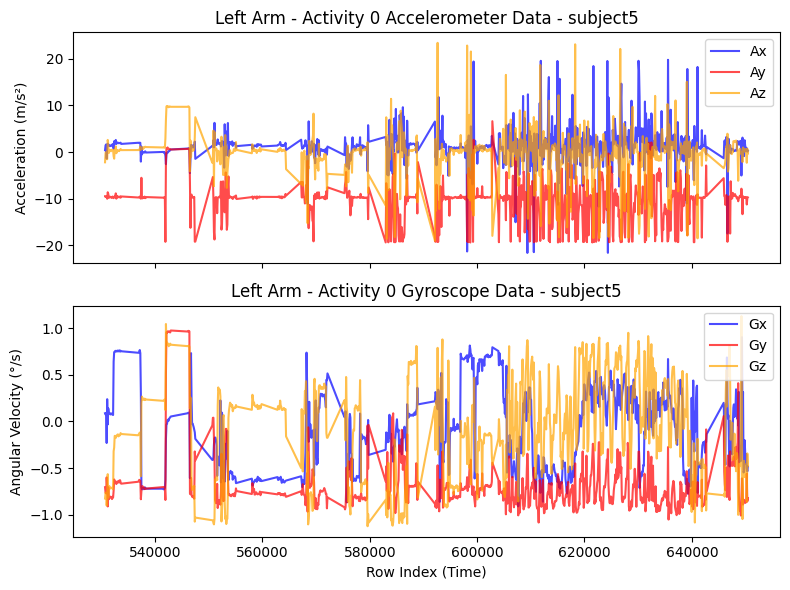

Subject: subject6, Data shape after sampling: (661, 18)


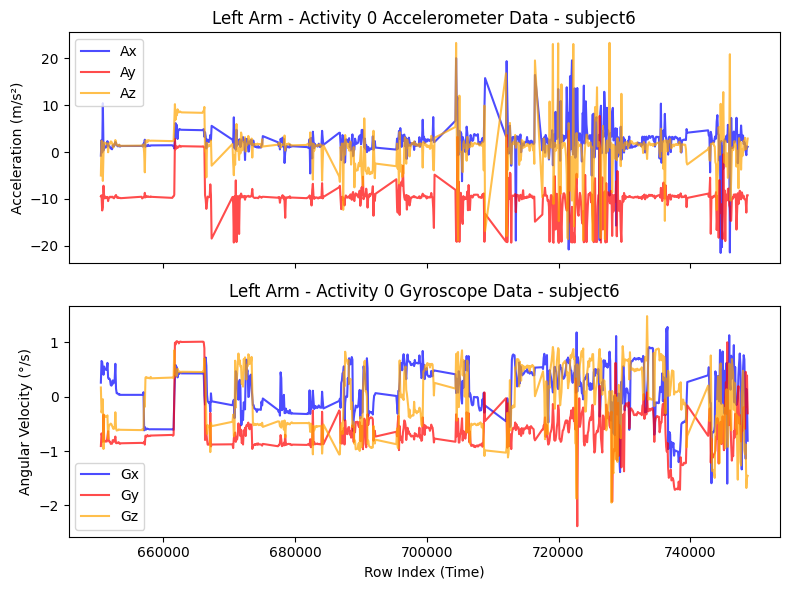

Subject: subject7, Data shape after sampling: (702, 18)


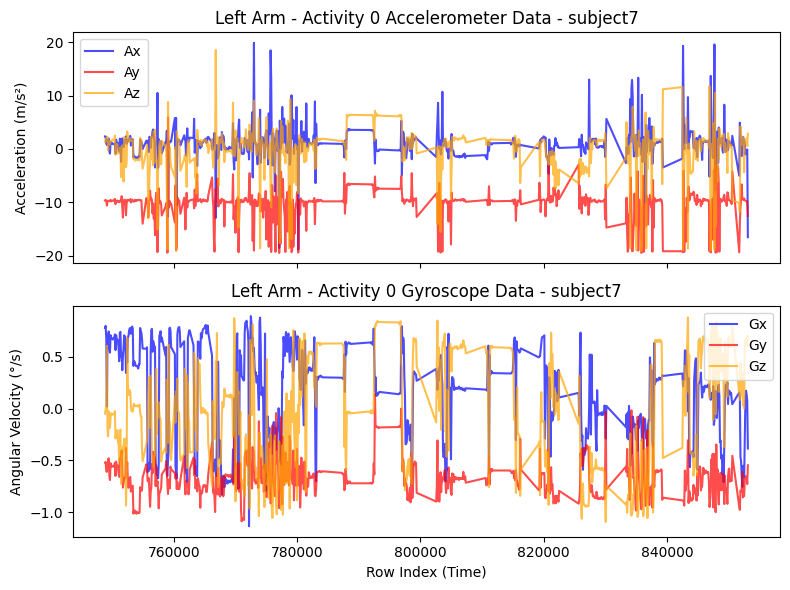

Subject: subject8, Data shape after sampling: (957, 18)


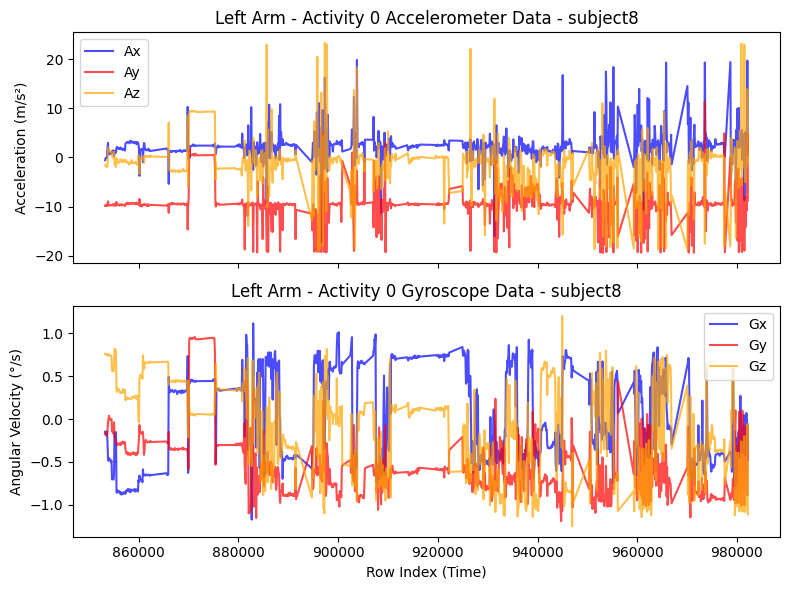

Subject: subject9, Data shape after sampling: (13824, 18)


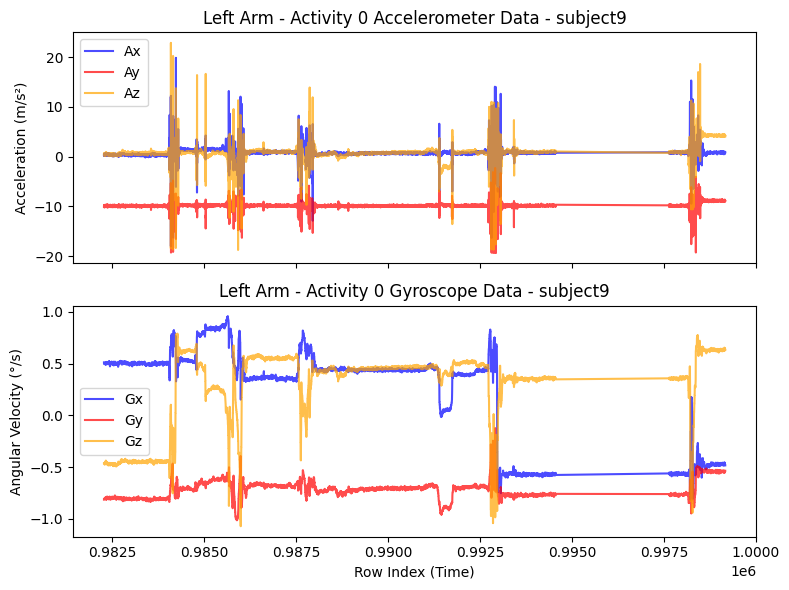

Filtered data shape: (27648, 18)
Subject: subject1, Data shape after sampling: (31, 18)


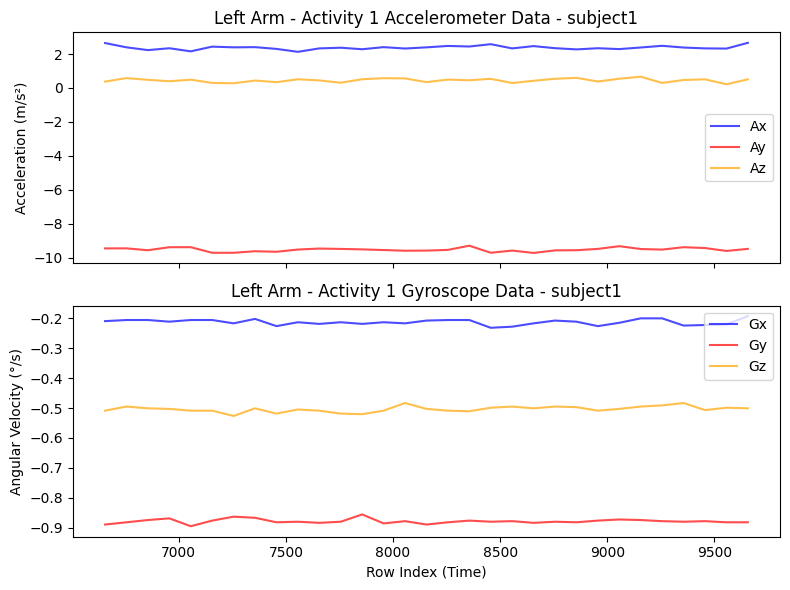

Subject: subject2, Data shape after sampling: (31, 18)


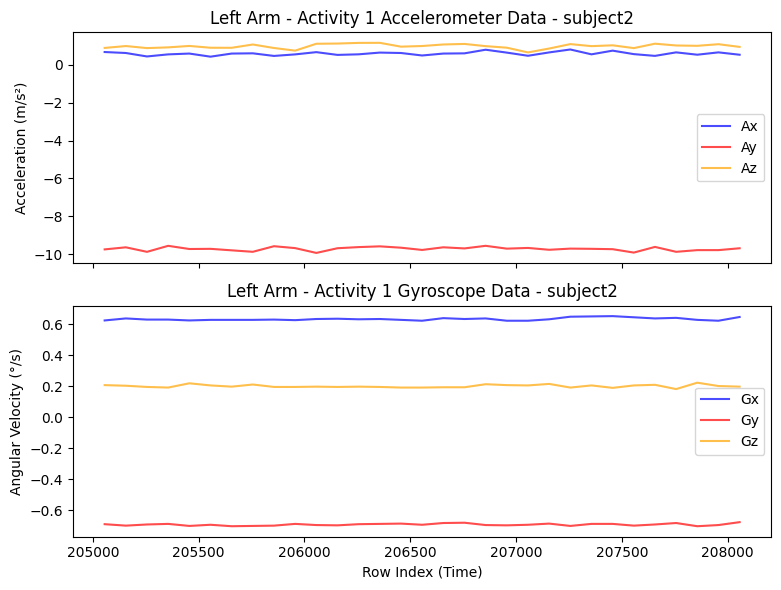

Subject: subject3, Data shape after sampling: (31, 18)


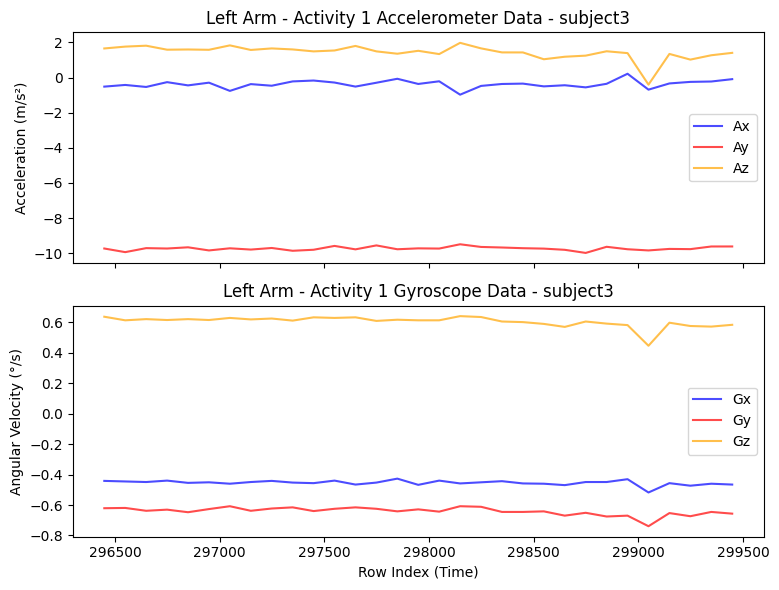

Subject: subject4, Data shape after sampling: (31, 18)


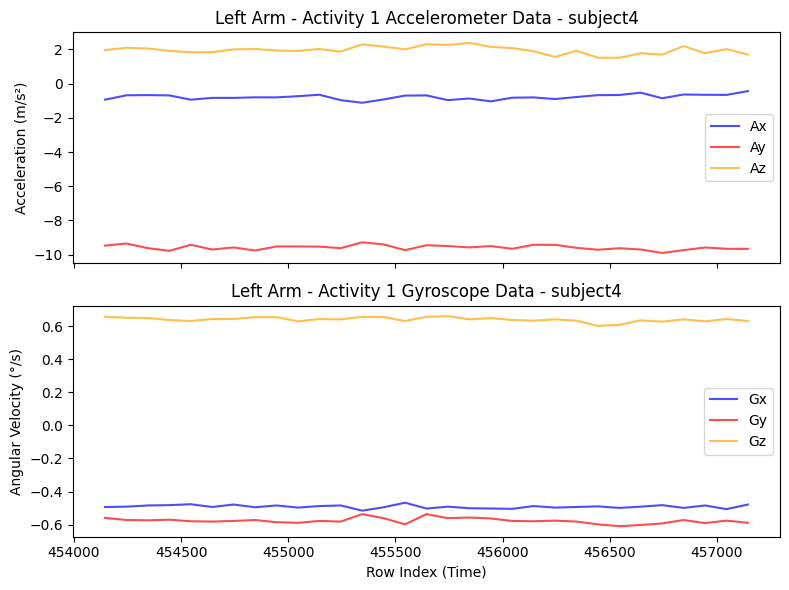

Subject: subject5, Data shape after sampling: (31, 18)


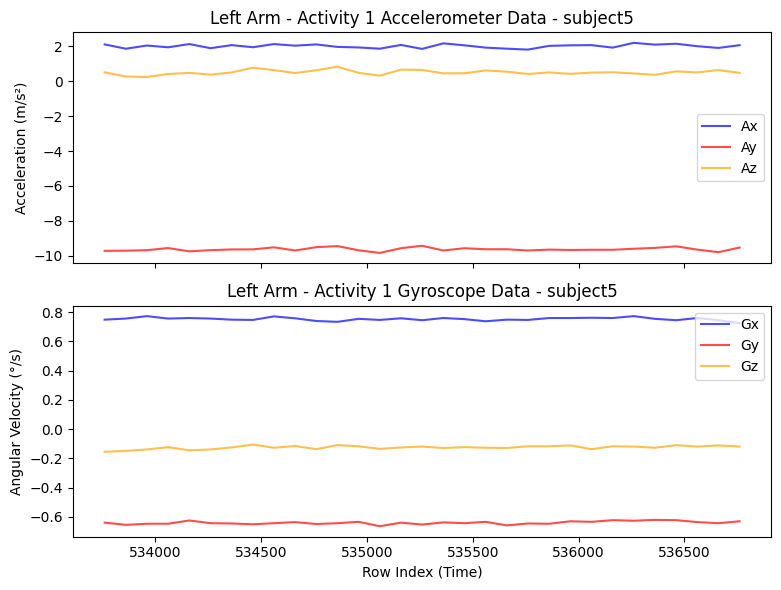

Subject: subject6, Data shape after sampling: (31, 18)


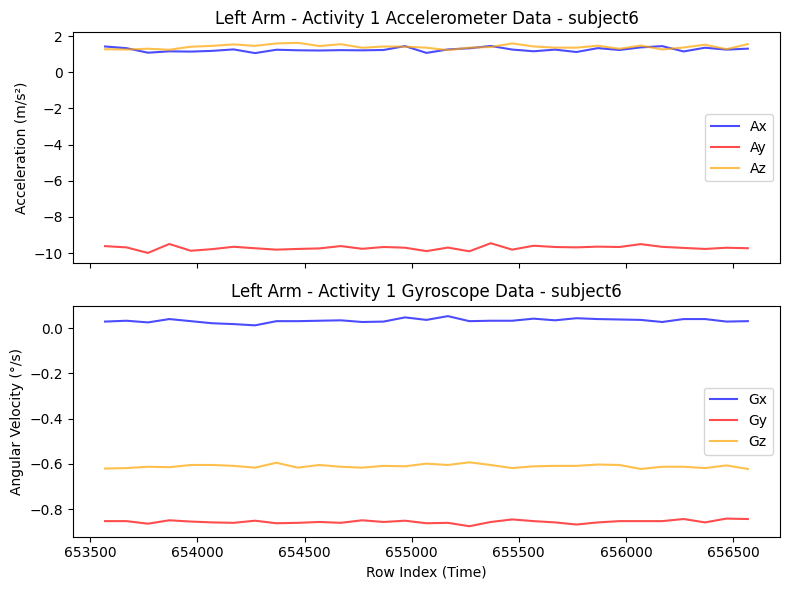

Subject: subject7, Data shape after sampling: (31, 18)


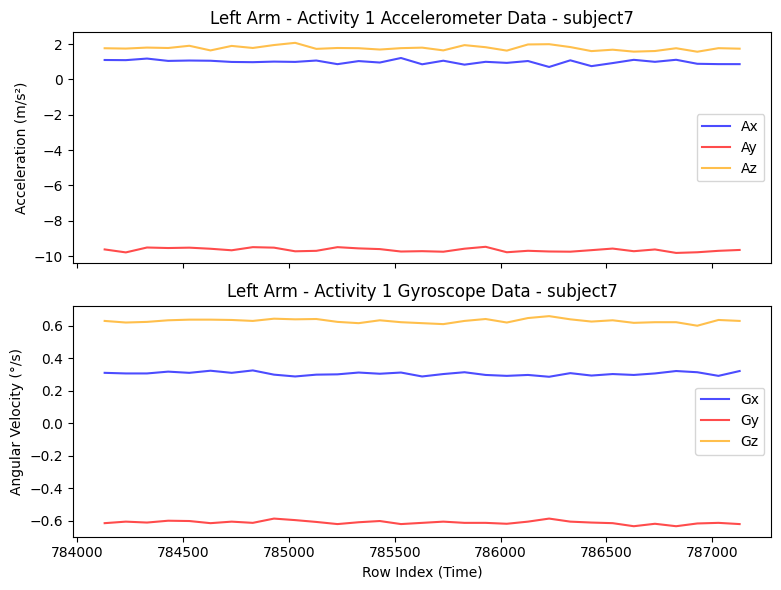

Subject: subject8, Data shape after sampling: (31, 18)


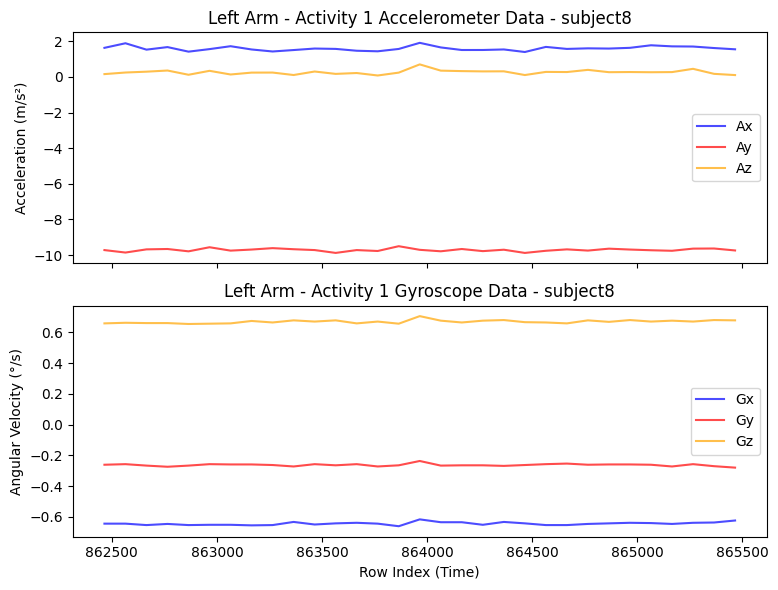

Subject: subject9, Data shape after sampling: (31, 18)


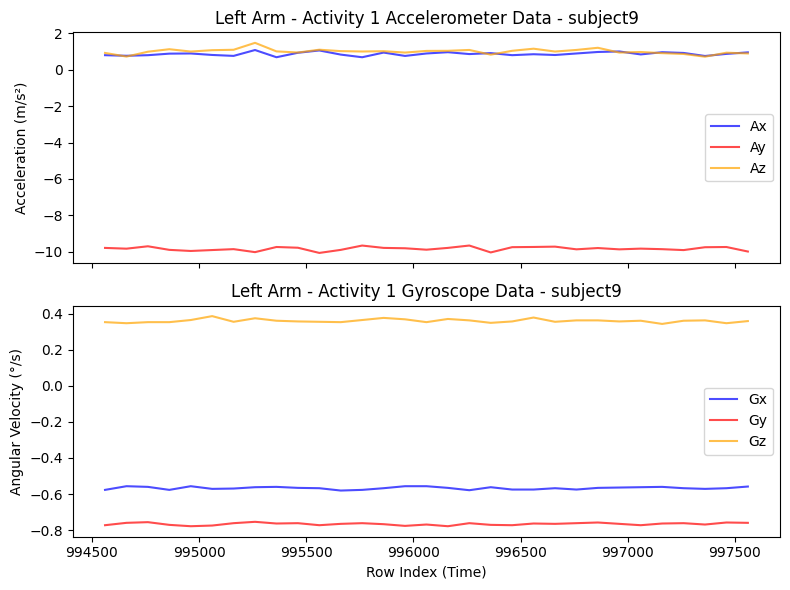

Filtered data shape: (25406, 18)
Subject: subject1, Data shape after sampling: (31, 18)


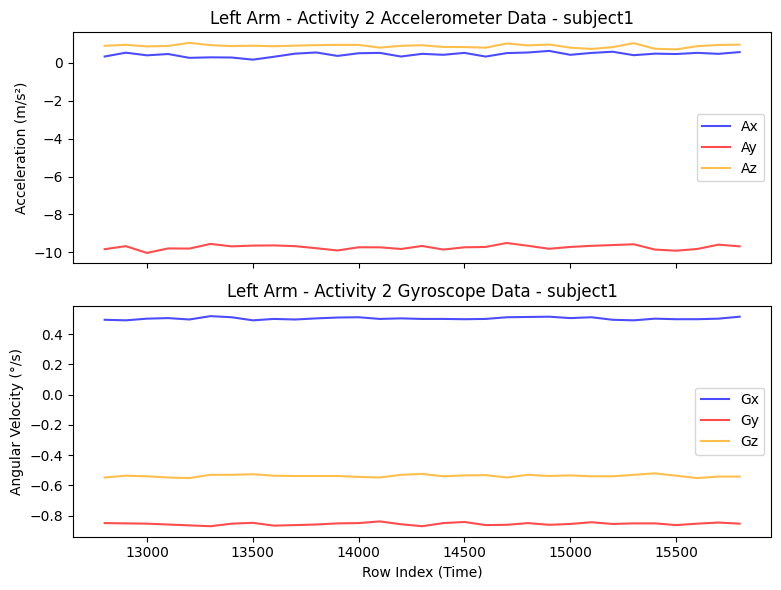

Subject: subject2, Data shape after sampling: (31, 18)


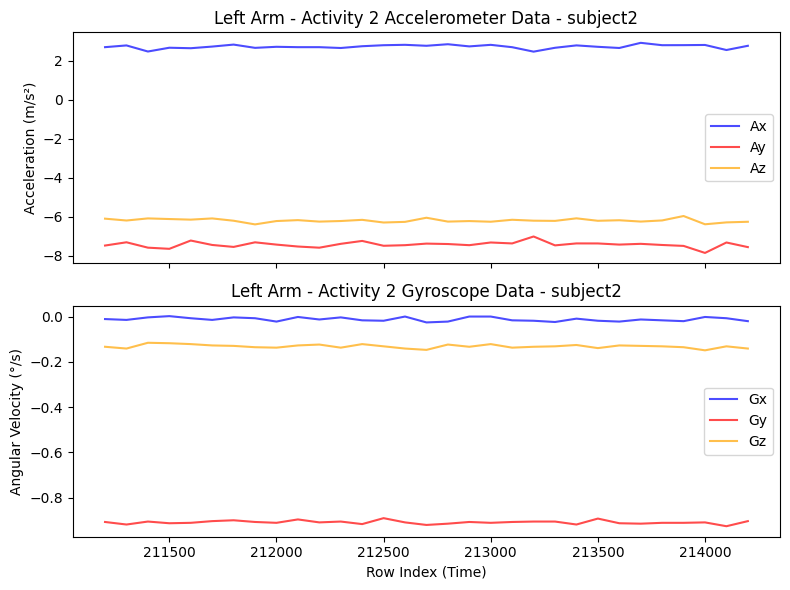

Subject: subject3, Data shape after sampling: (31, 18)


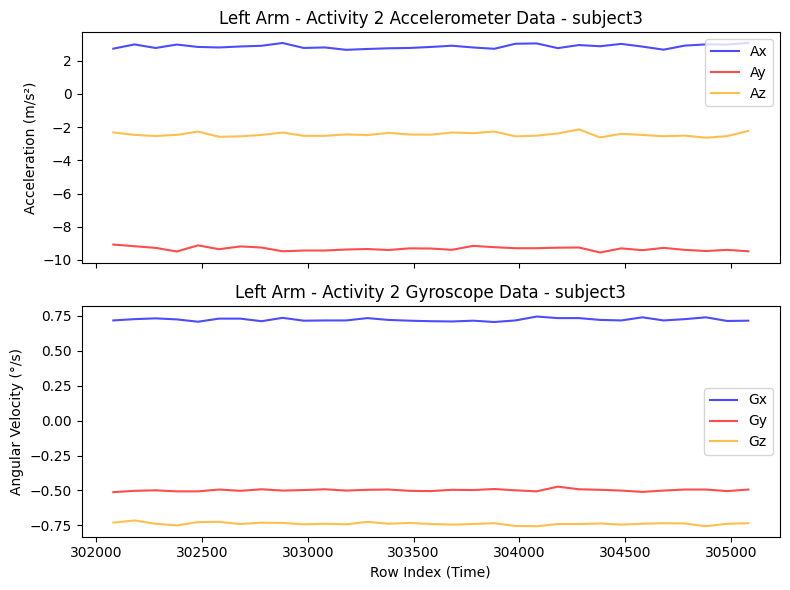

Subject: subject4, Data shape after sampling: (31, 18)


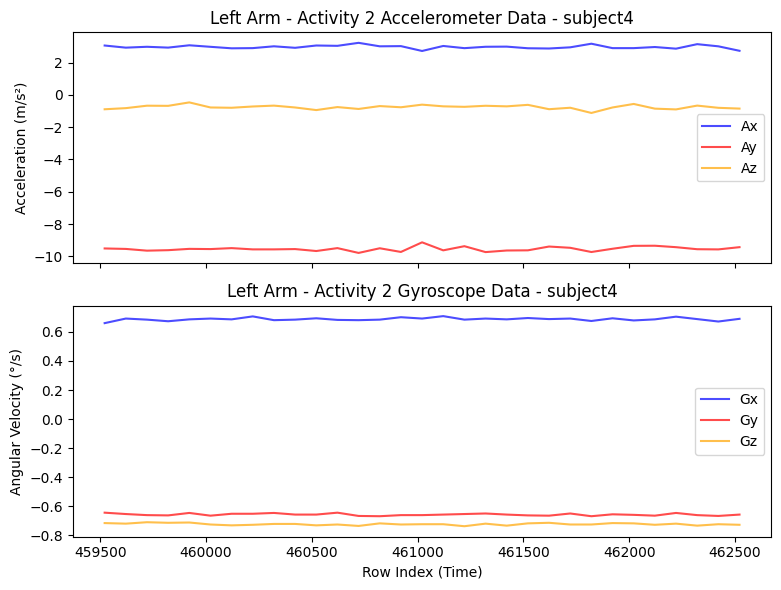

Subject: subject5, Data shape after sampling: (31, 18)


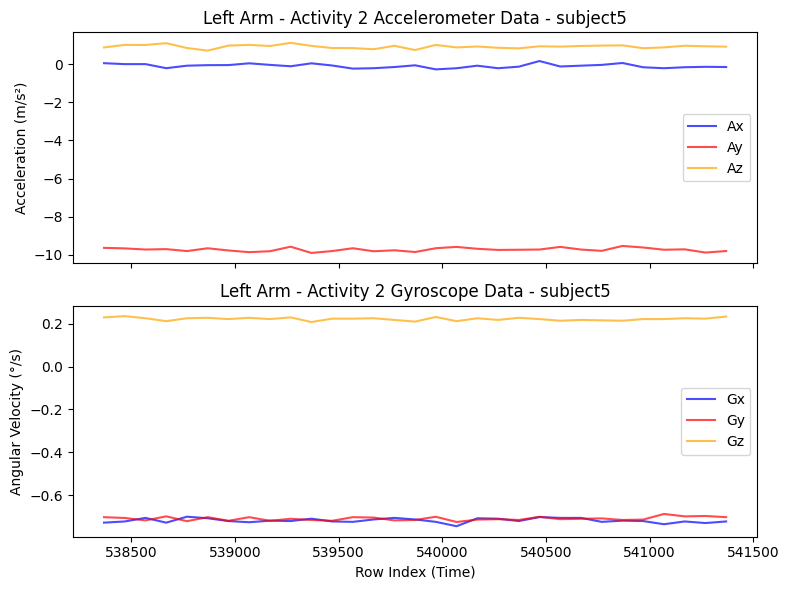

Subject: subject6, Data shape after sampling: (31, 18)


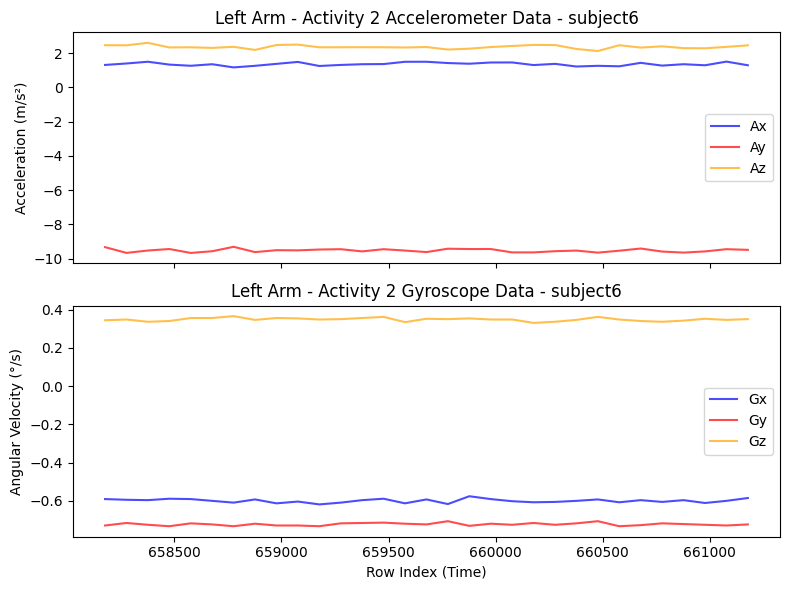

Subject: subject7, Data shape after sampling: (31, 18)


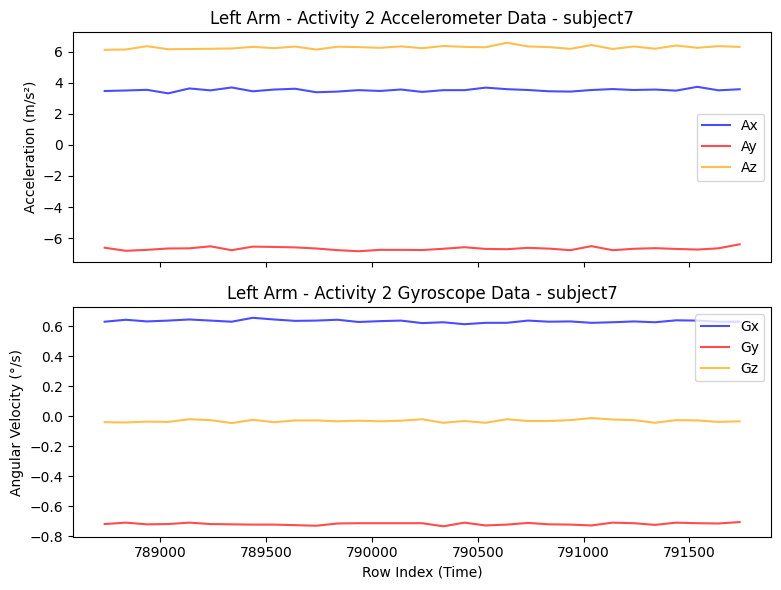

Subject: subject8, Data shape after sampling: (31, 18)


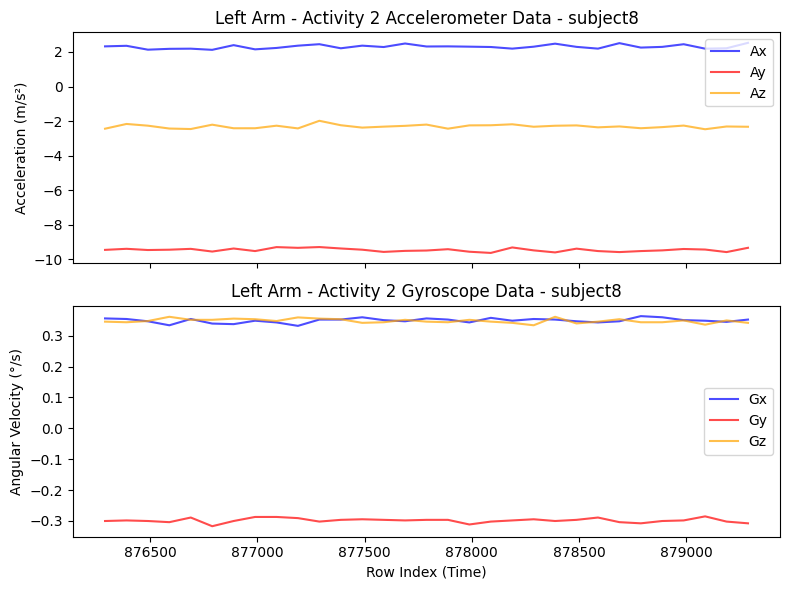

Subject: subject9, Data shape after sampling: (830, 18)


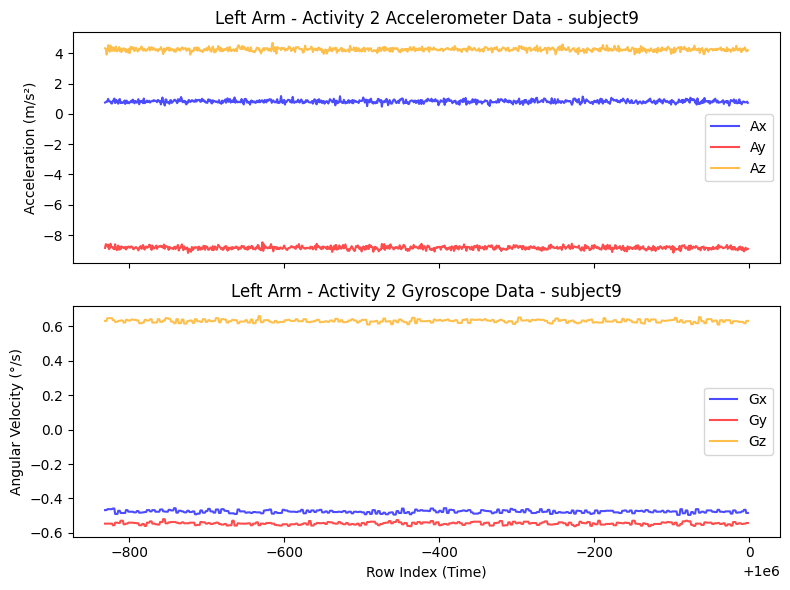

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 18)


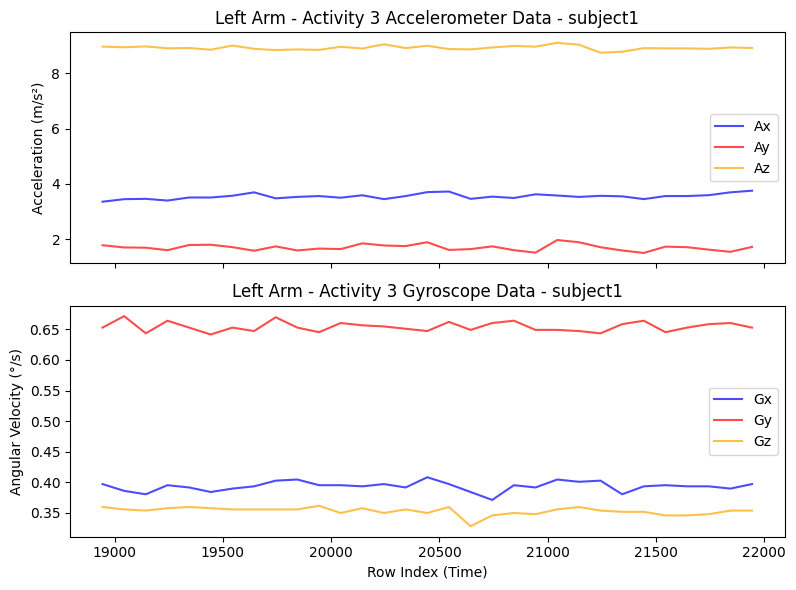

Subject: subject2, Data shape after sampling: (31, 18)


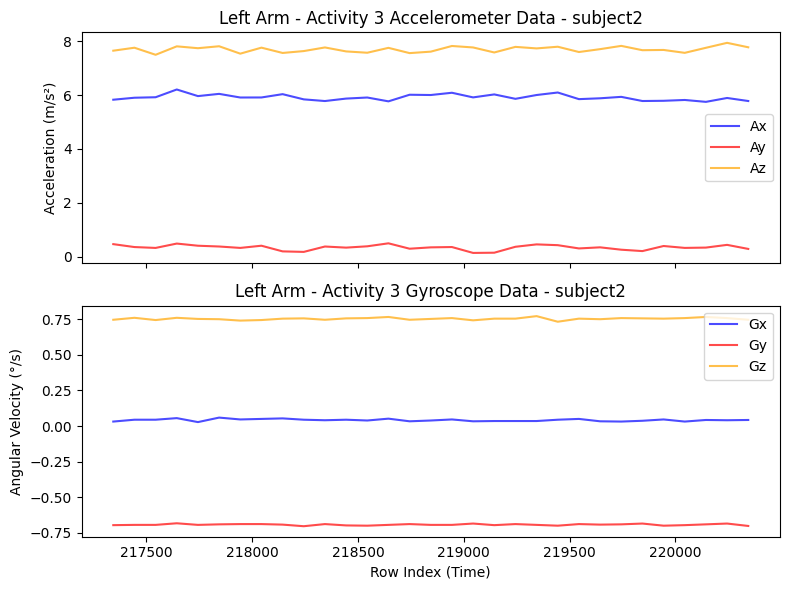

Subject: subject3, Data shape after sampling: (31, 18)


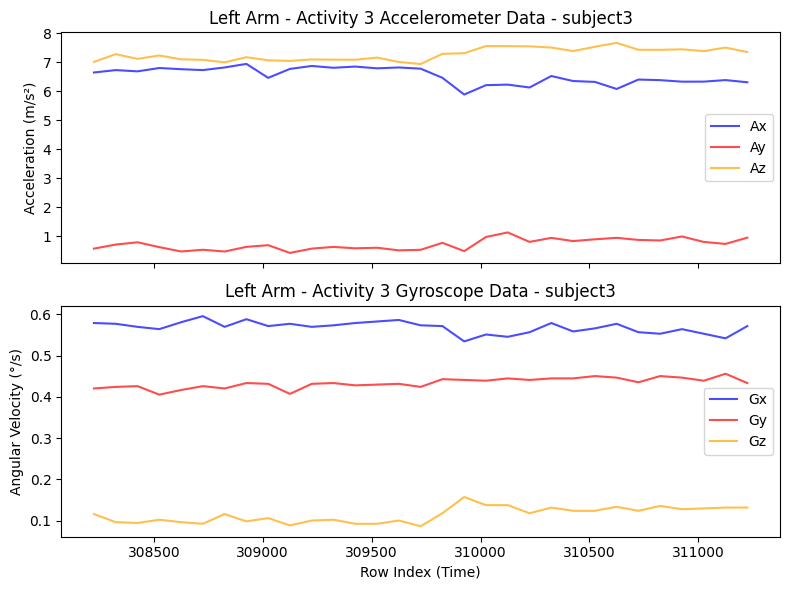

Subject: subject4, Data shape after sampling: (31, 18)


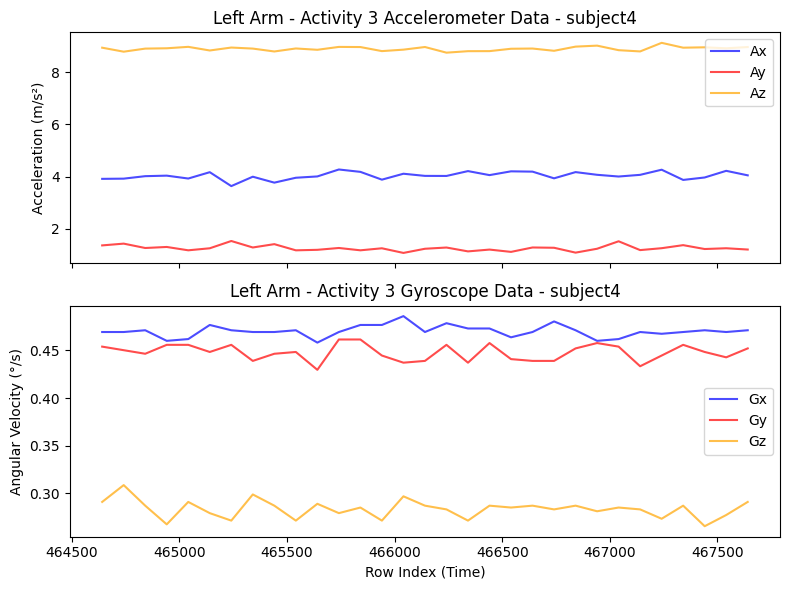

Subject: subject5, Data shape after sampling: (31, 18)


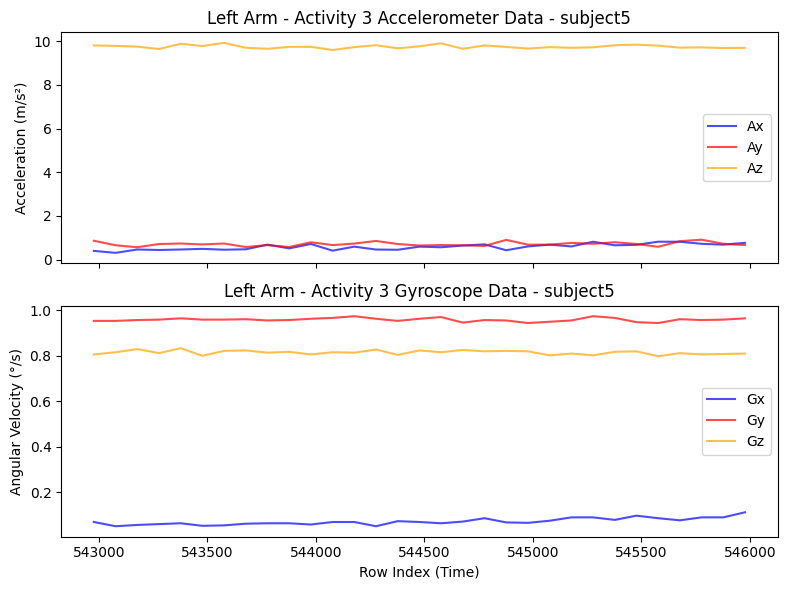

Subject: subject6, Data shape after sampling: (31, 18)


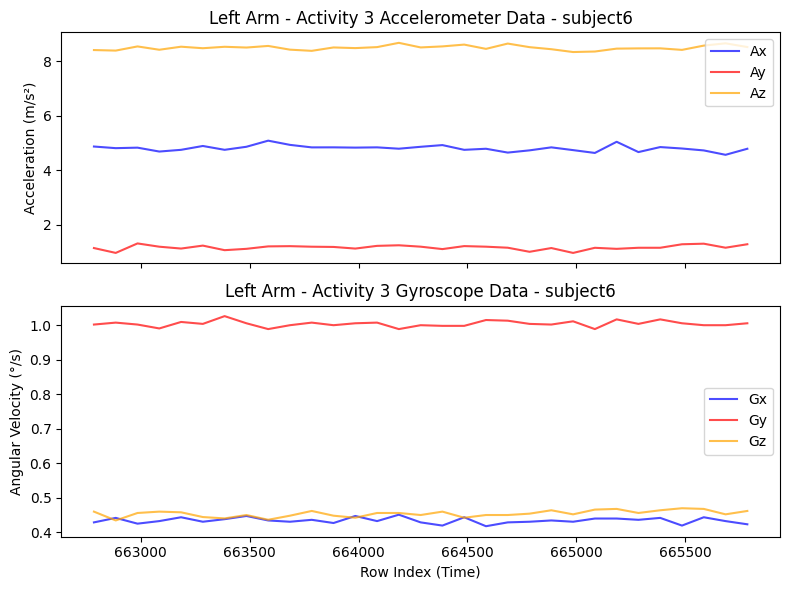

Subject: subject7, Data shape after sampling: (31, 18)


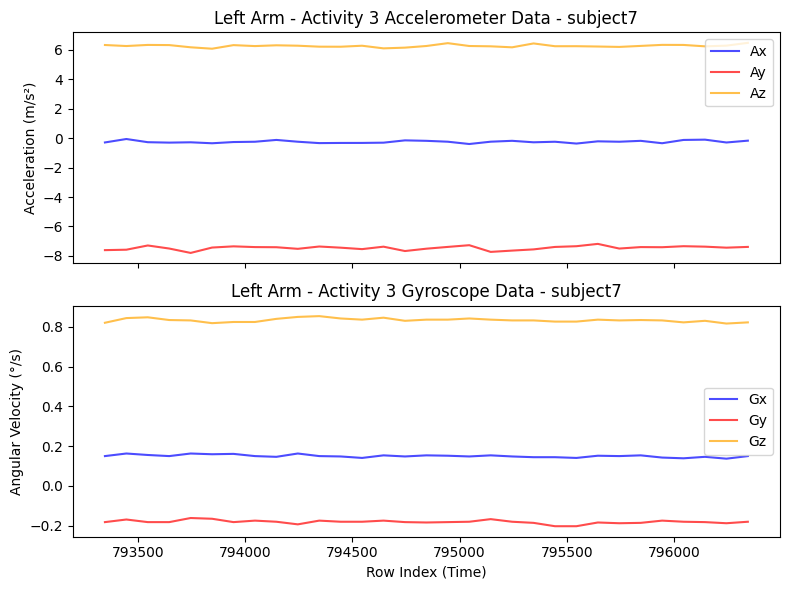

Subject: subject8, Data shape after sampling: (31, 18)


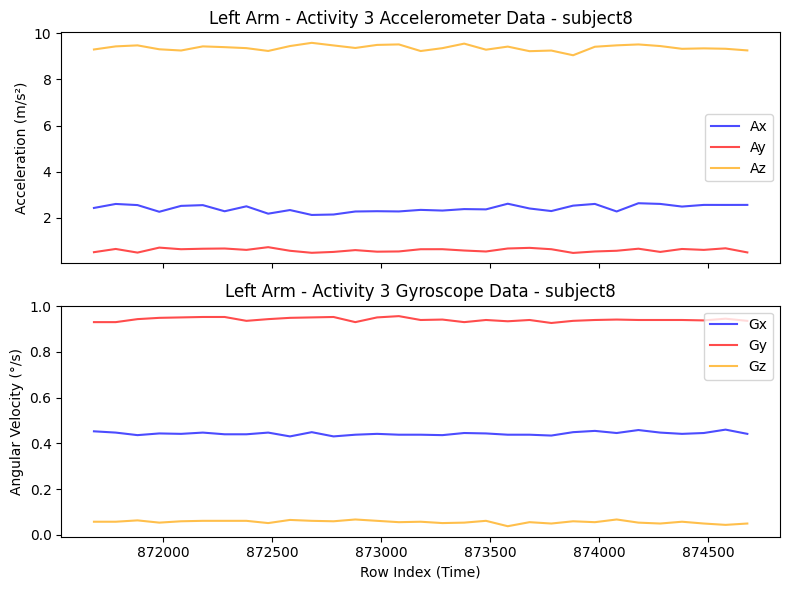

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 18)


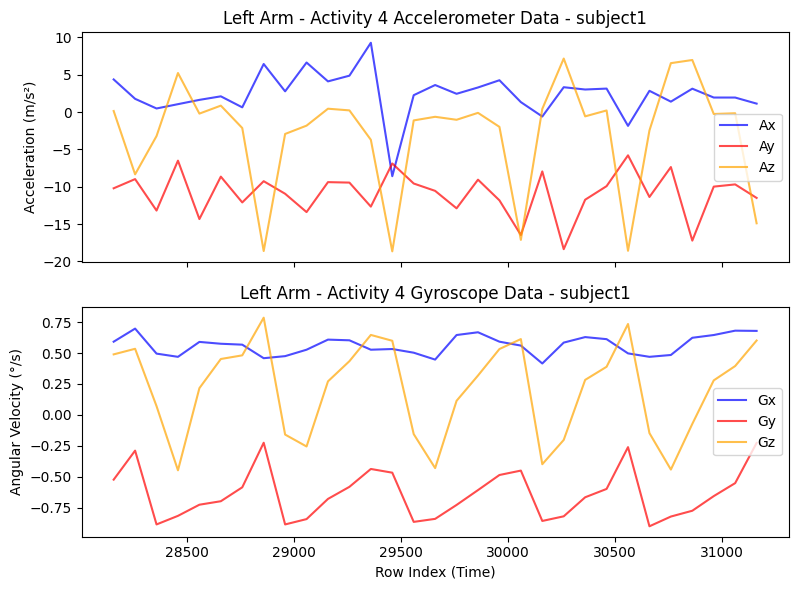

Subject: subject2, Data shape after sampling: (31, 18)


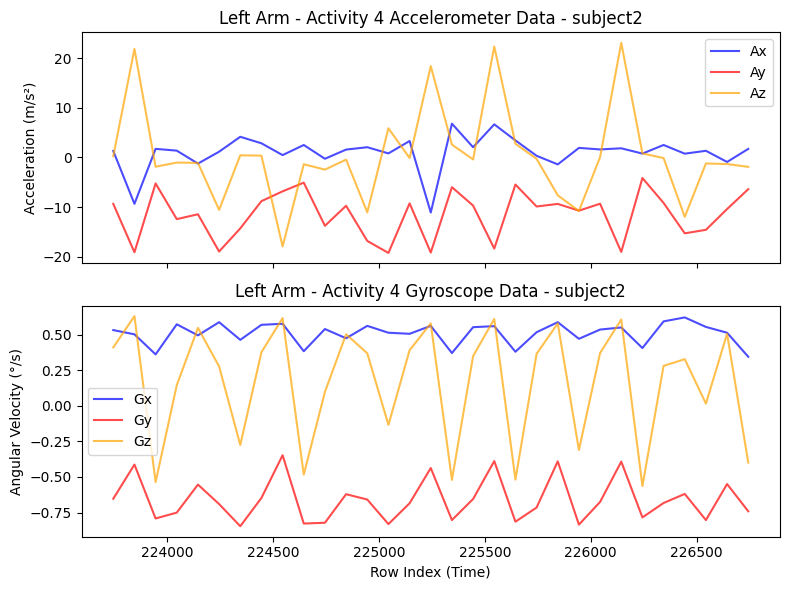

Subject: subject3, Data shape after sampling: (31, 18)


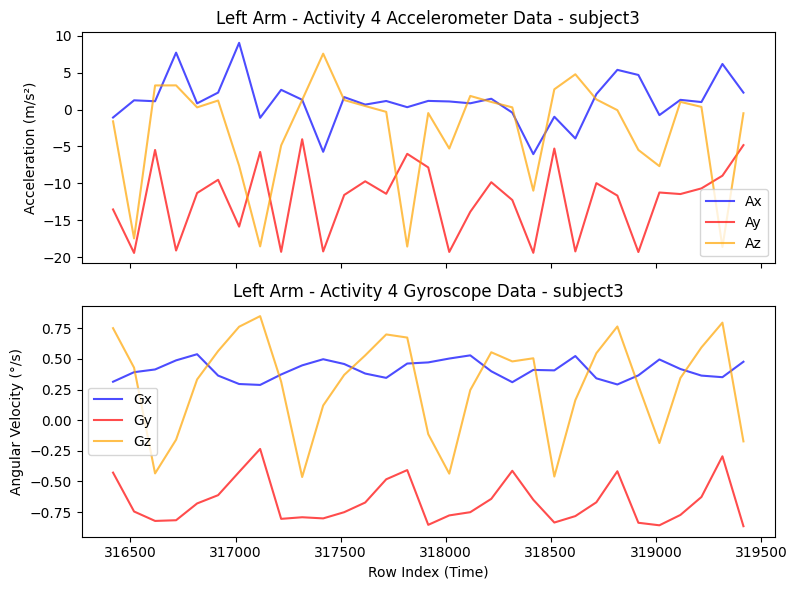

Subject: subject4, Data shape after sampling: (31, 18)


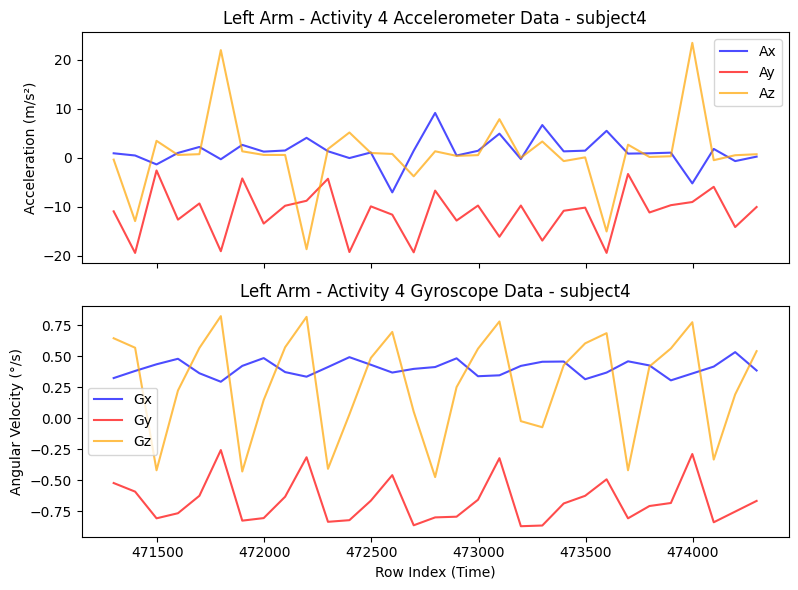

Subject: subject5, Data shape after sampling: (31, 18)


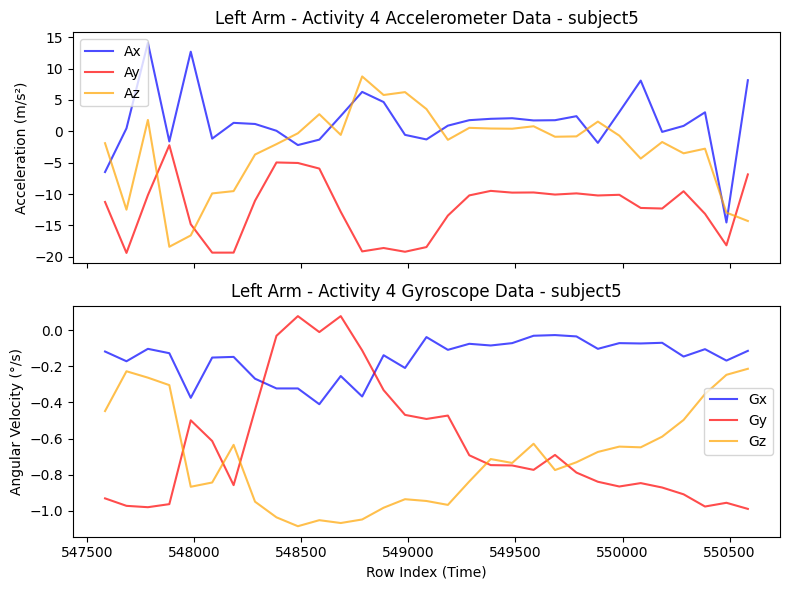

Subject: subject6, Data shape after sampling: (31, 18)


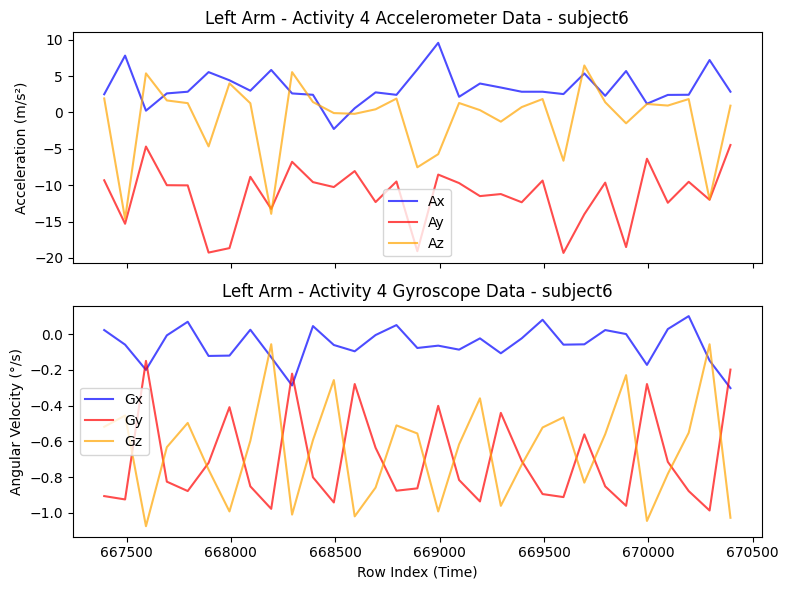

Subject: subject7, Data shape after sampling: (31, 18)


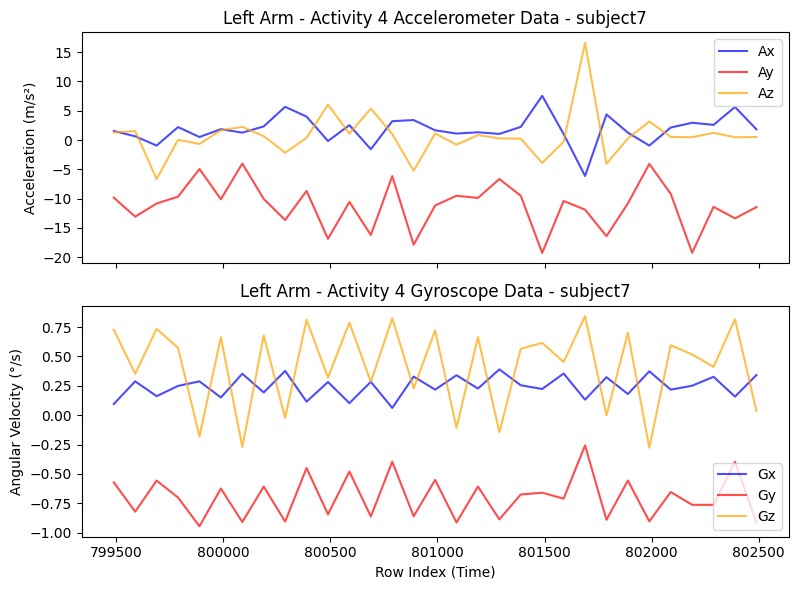

Subject: subject8, Data shape after sampling: (31, 18)


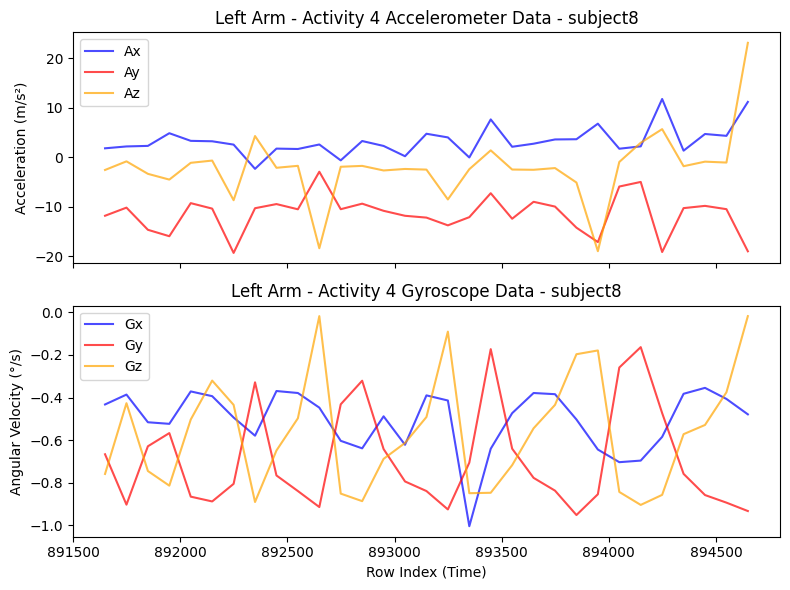

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 18)


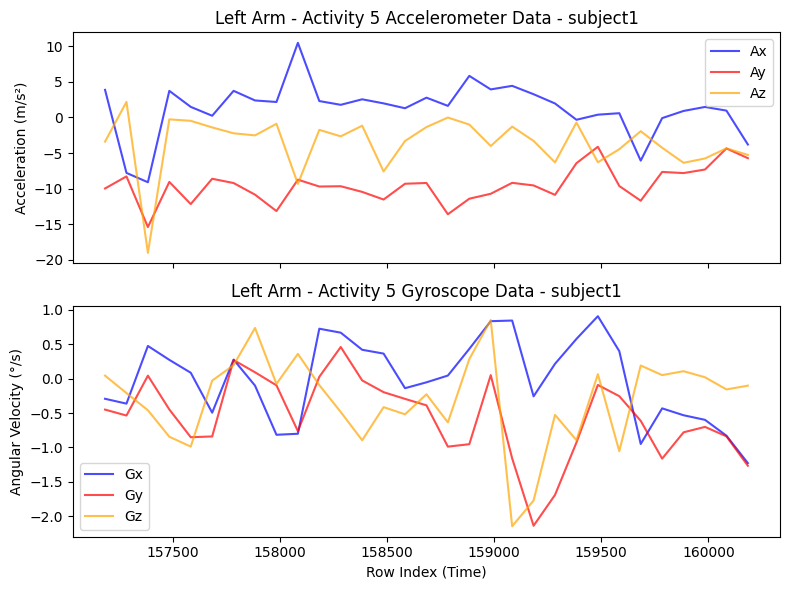

Subject: subject2, Data shape after sampling: (31, 18)


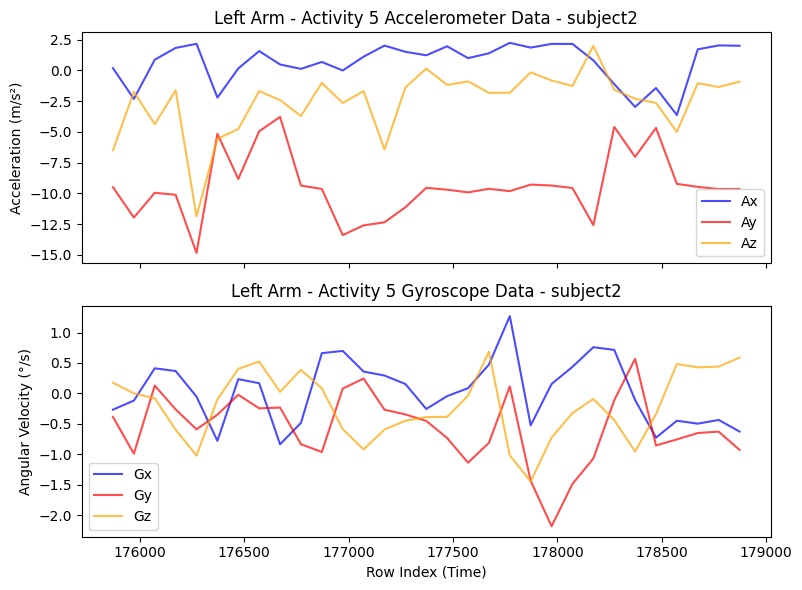

Subject: subject3, Data shape after sampling: (31, 18)


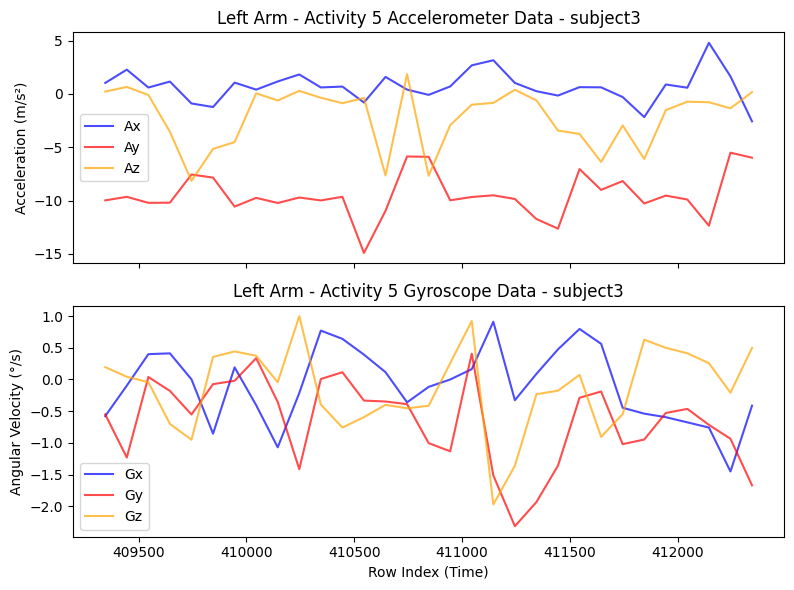

Subject: subject4, Data shape after sampling: (31, 18)


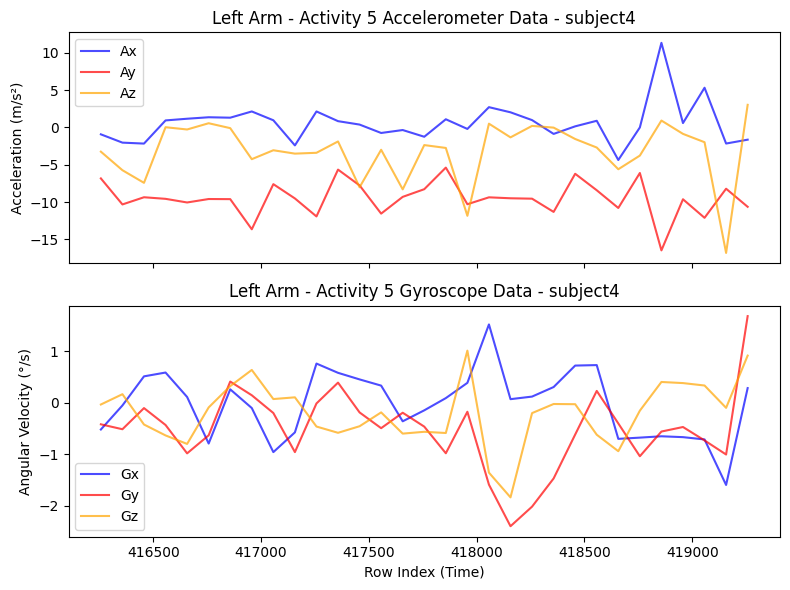

Subject: subject5, Data shape after sampling: (31, 18)


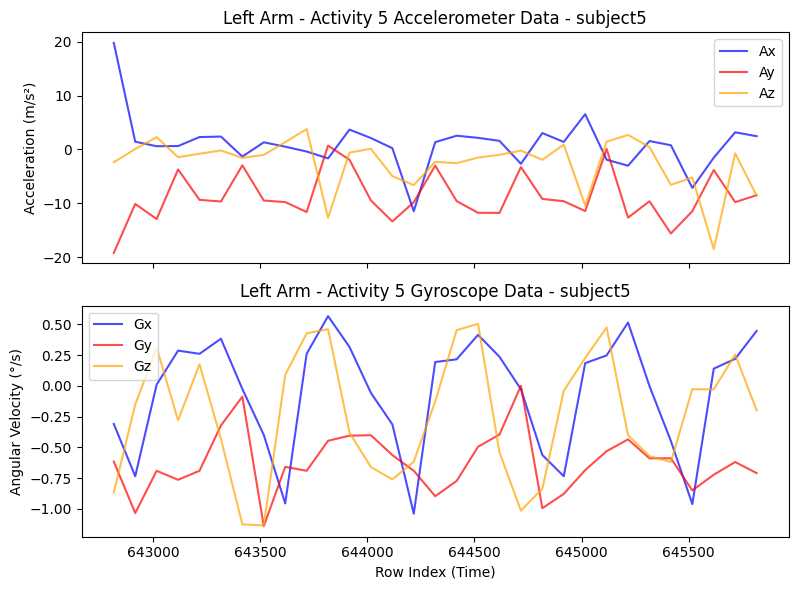

Subject: subject6, Data shape after sampling: (31, 18)


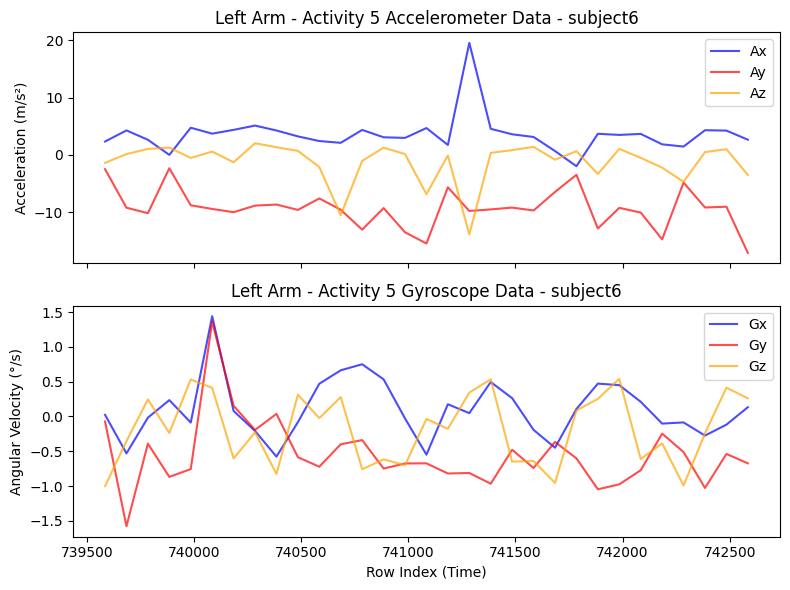

Subject: subject7, Data shape after sampling: (31, 18)


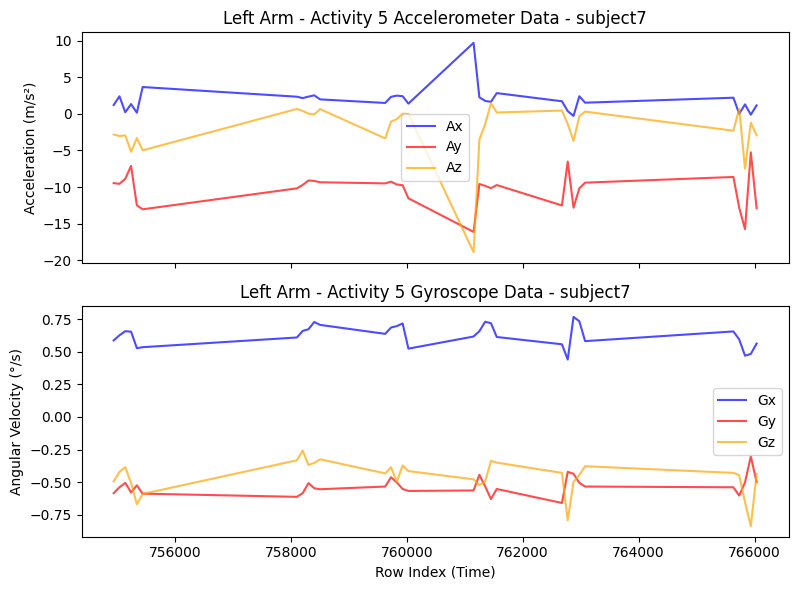

Subject: subject8, Data shape after sampling: (31, 18)


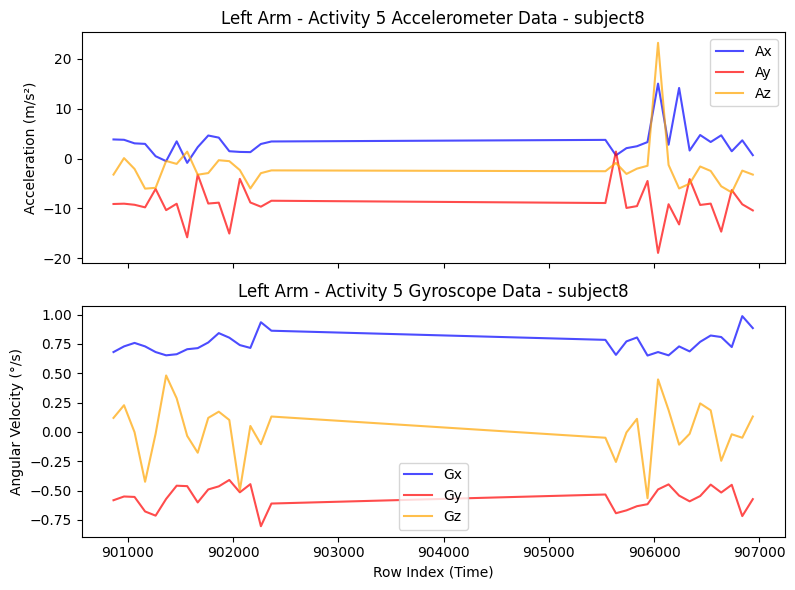

Filtered data shape: (22990, 18)
Subject: subject1, Data shape after sampling: (31, 18)


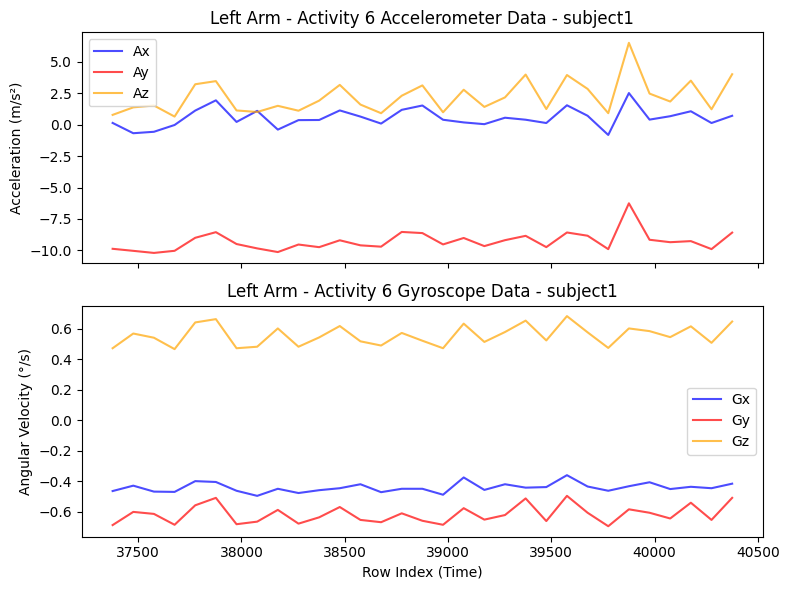

Subject: subject2, Data shape after sampling: (32, 18)


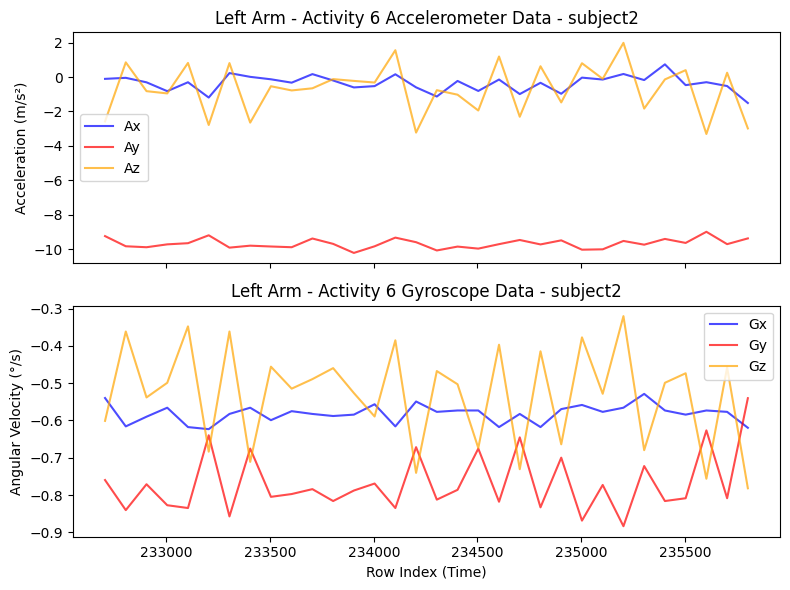

Subject: subject3, Data shape after sampling: (33, 18)


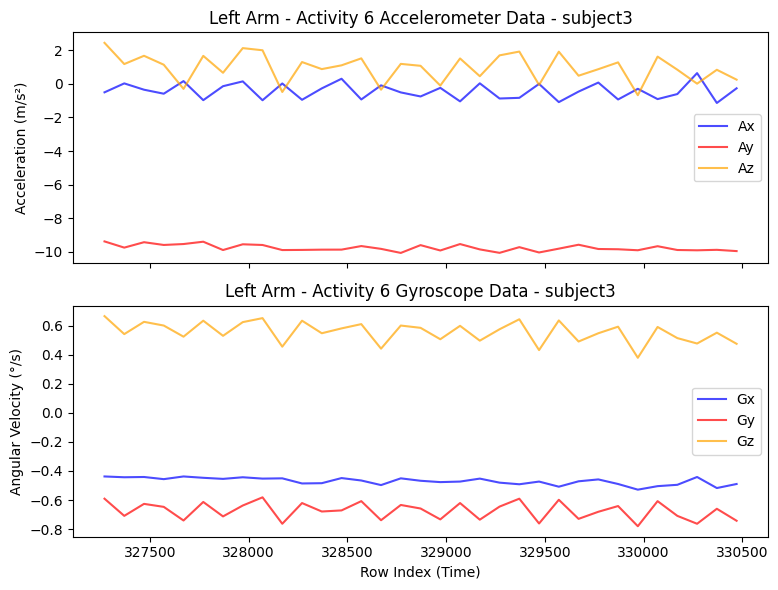

Subject: subject4, Data shape after sampling: (34, 18)


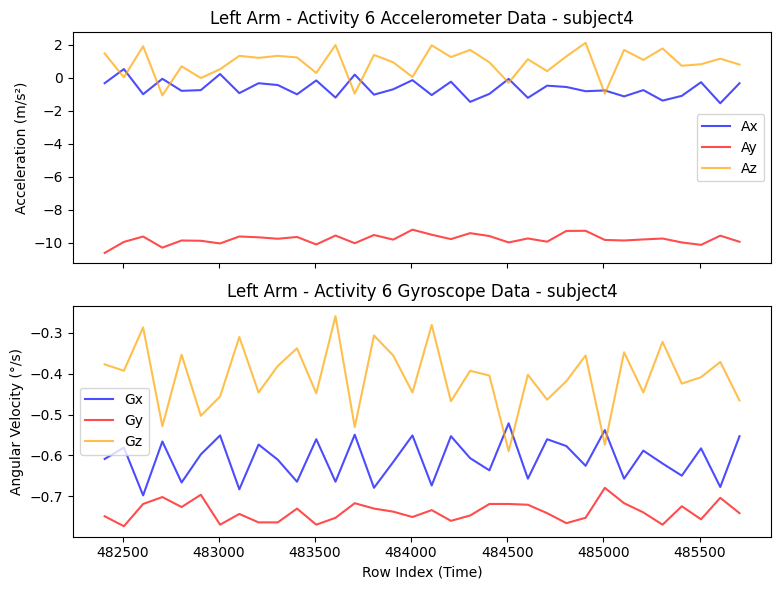

Subject: subject5, Data shape after sampling: (28, 18)


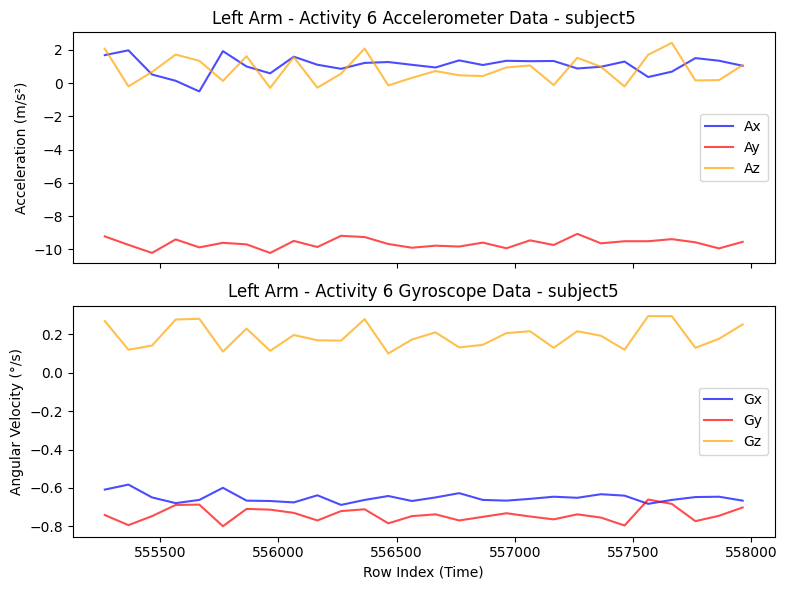

Subject: subject6, Data shape after sampling: (23, 18)


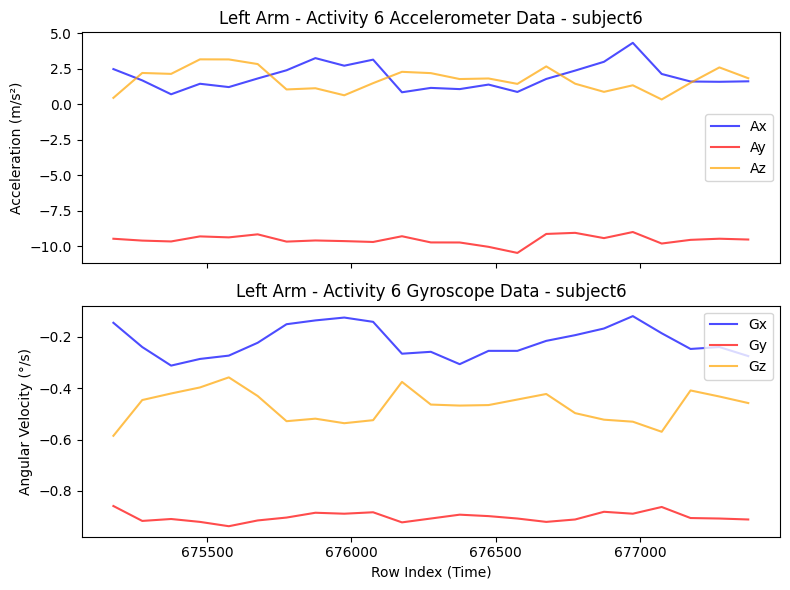

Subject: subject7, Data shape after sampling: (31, 18)


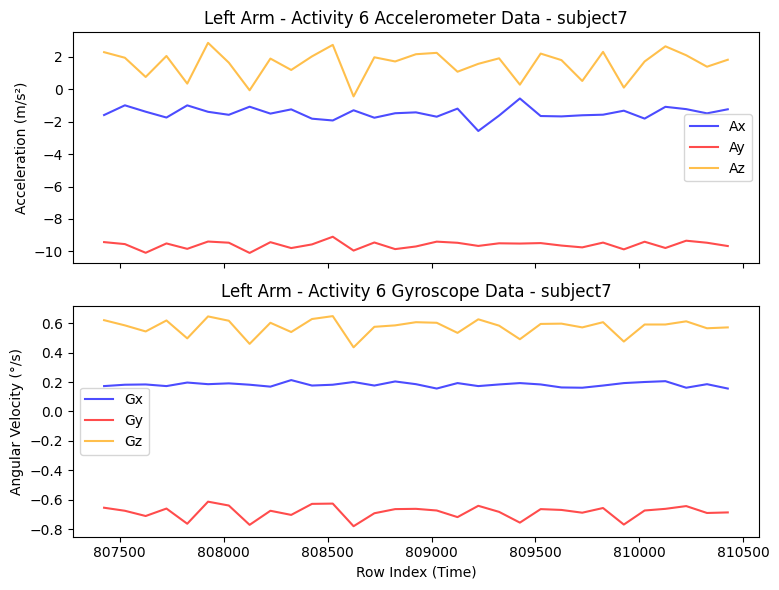

Subject: subject8, Data shape after sampling: (22, 18)


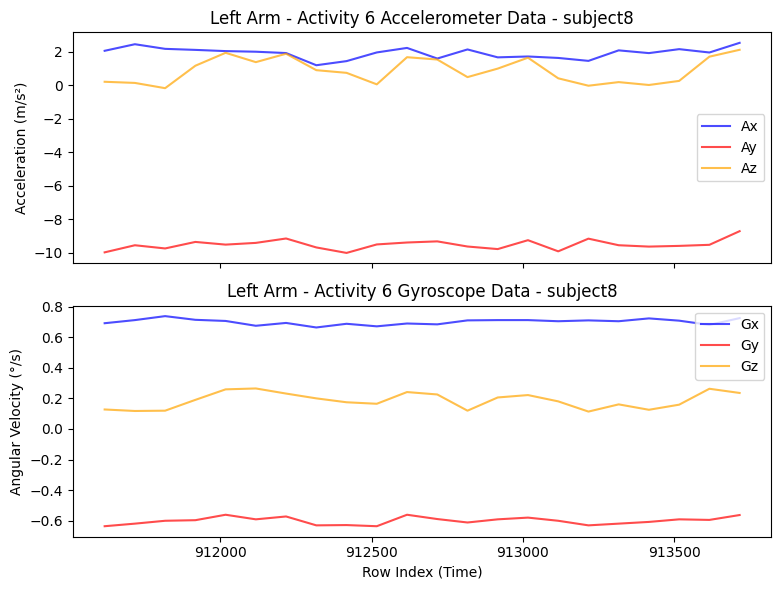

Filtered data shape: (23809, 18)
Subject: subject1, Data shape after sampling: (31, 18)


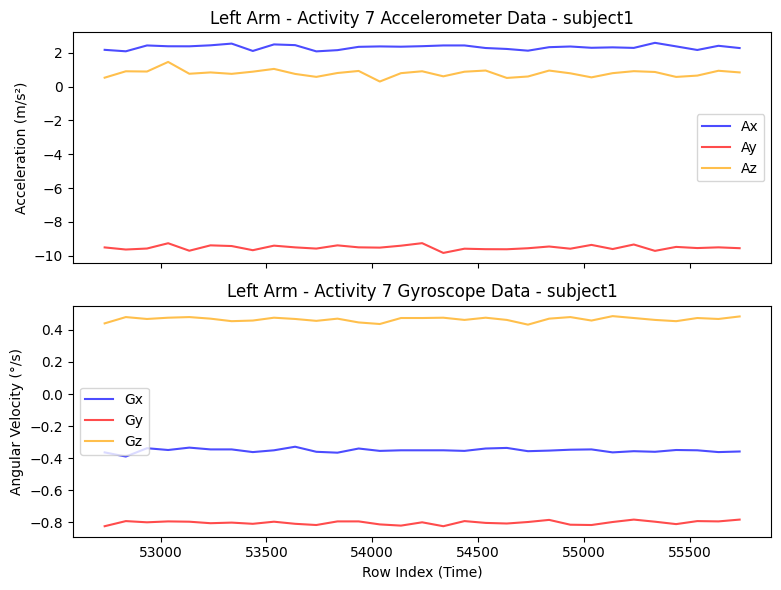

Subject: subject2, Data shape after sampling: (34, 18)


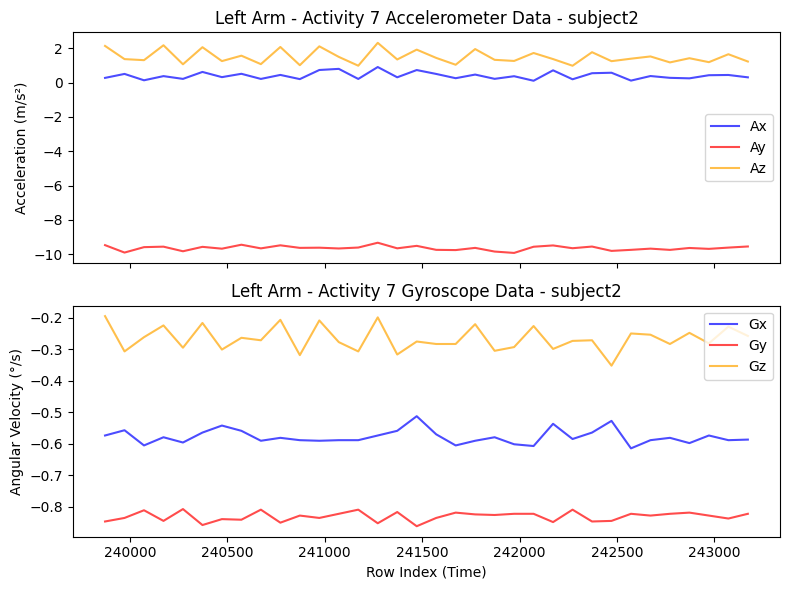

Subject: subject3, Data shape after sampling: (34, 18)


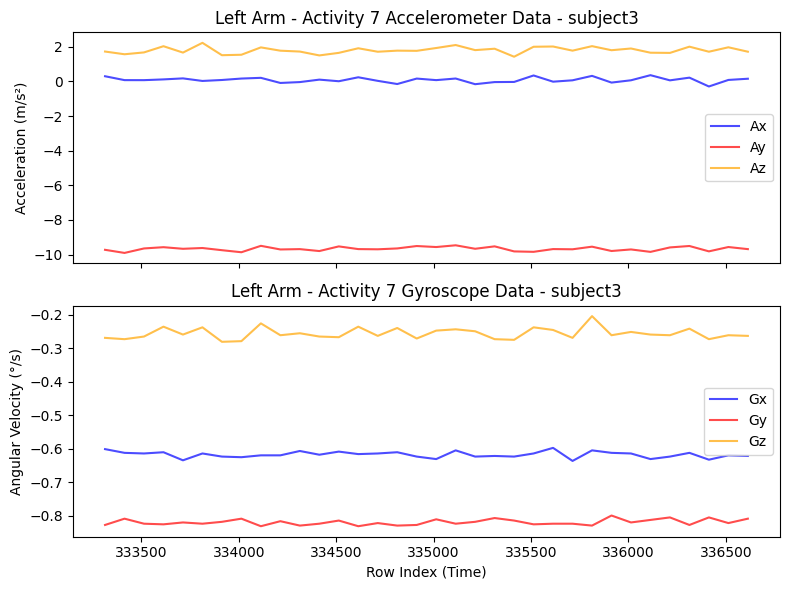

Subject: subject4, Data shape after sampling: (33, 18)


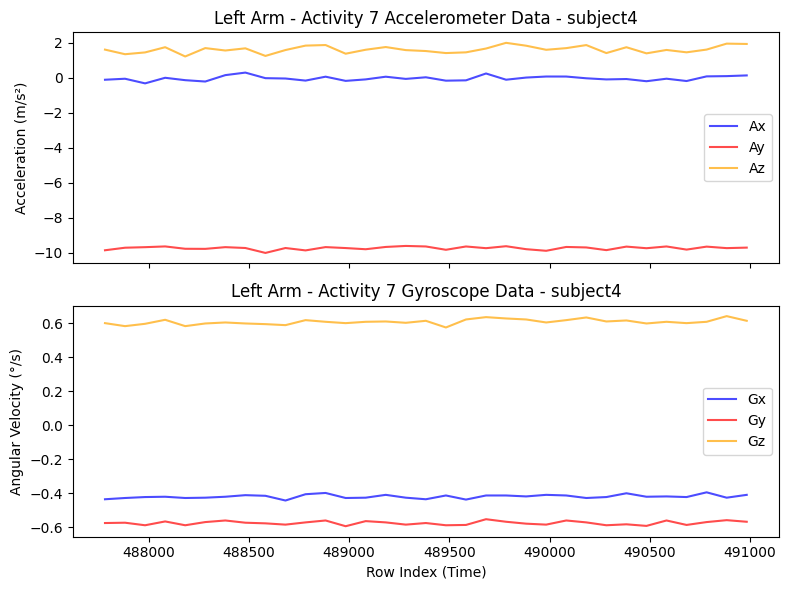

Subject: subject5, Data shape after sampling: (29, 18)


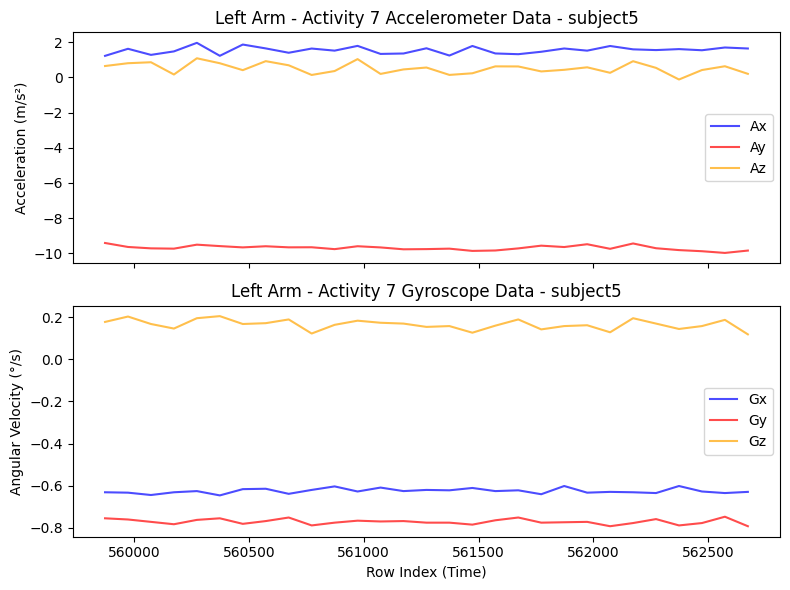

Subject: subject6, Data shape after sampling: (21, 18)


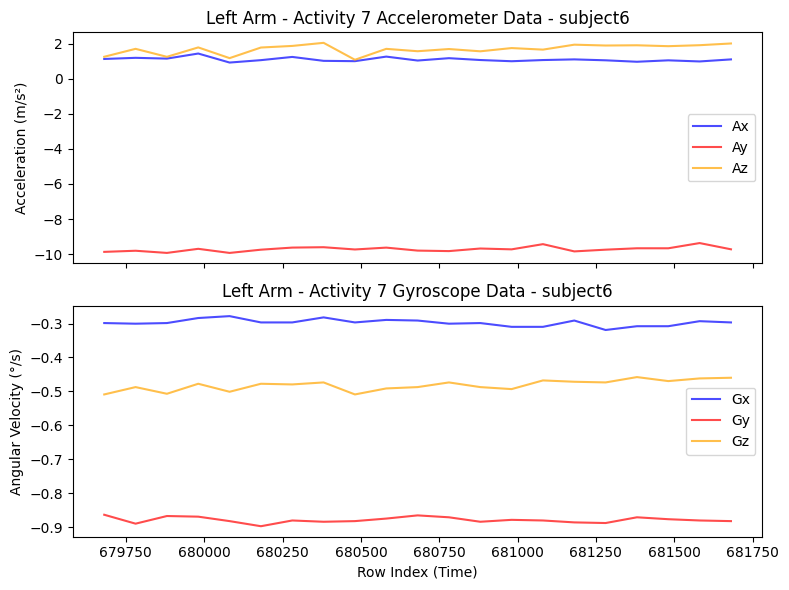

Subject: subject7, Data shape after sampling: (28, 18)


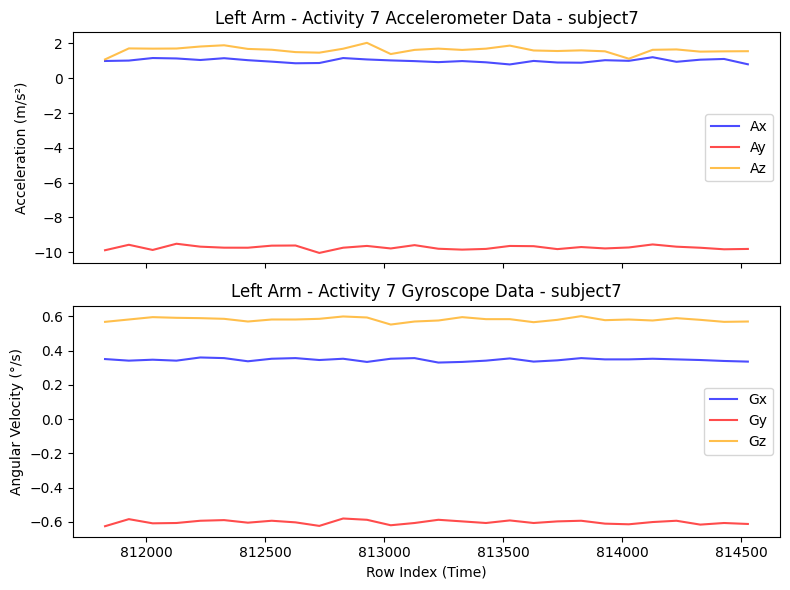

Subject: subject8, Data shape after sampling: (31, 18)


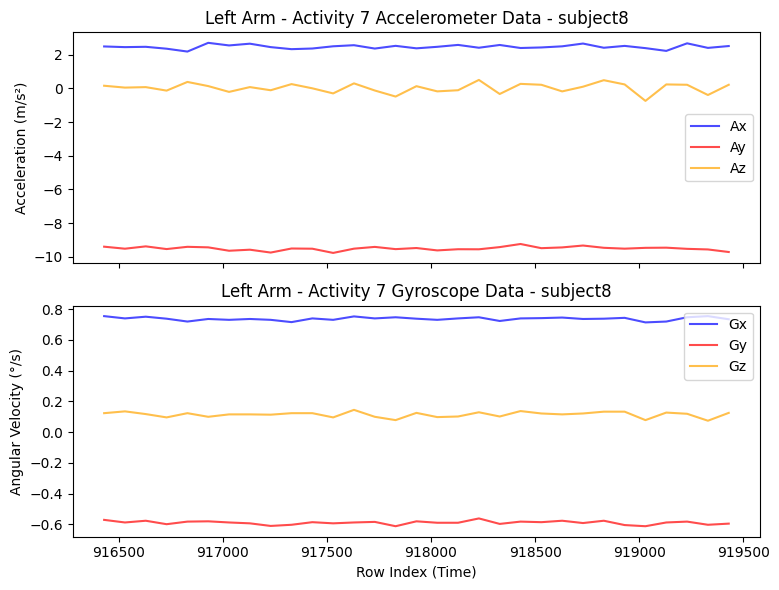

Filtered data shape: (23501, 18)
Subject: subject1, Data shape after sampling: (34, 18)


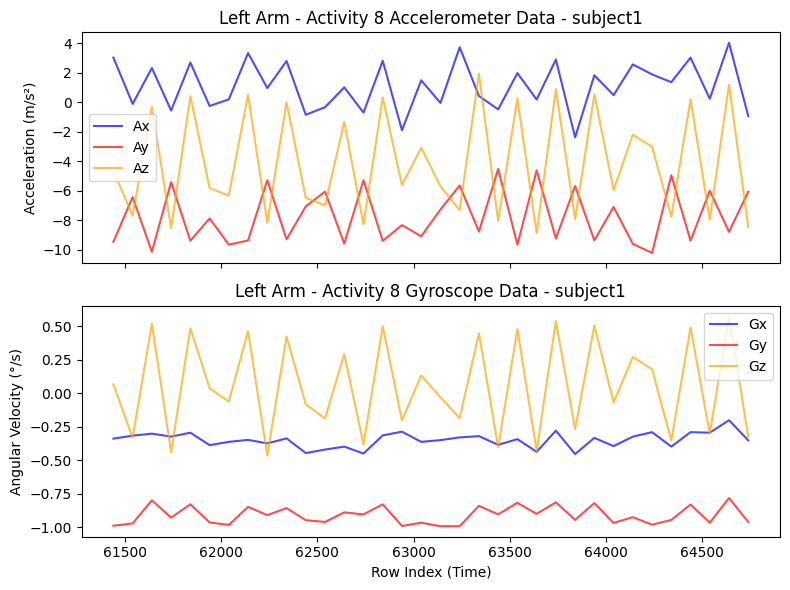

Subject: subject2, Data shape after sampling: (35, 18)


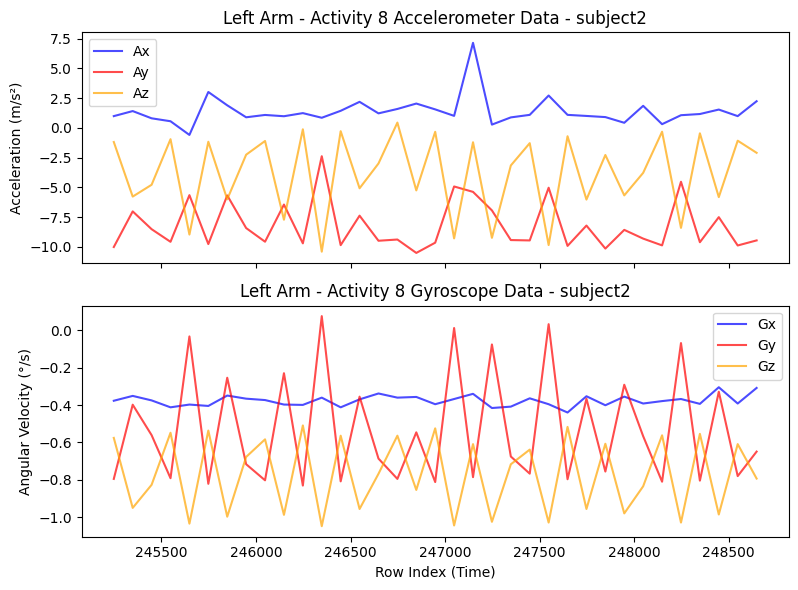

Subject: subject3, Data shape after sampling: (32, 18)


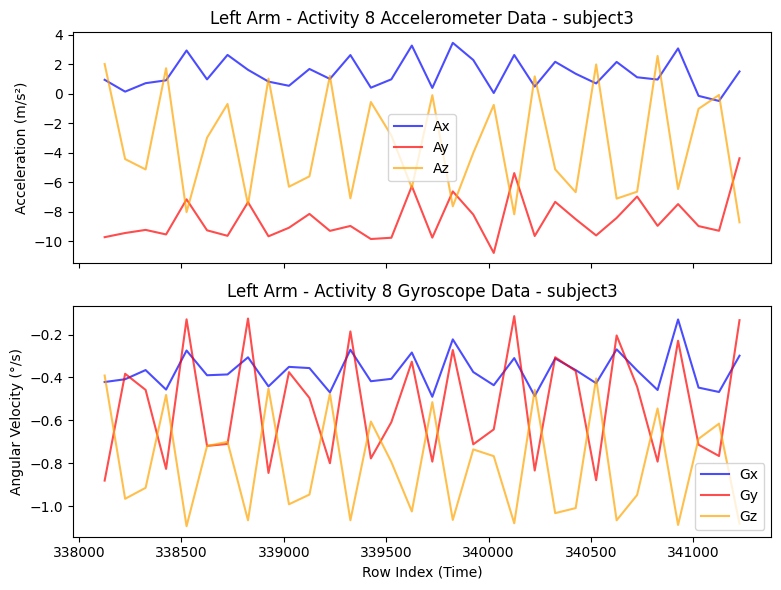

Subject: subject4, Data shape after sampling: (32, 18)


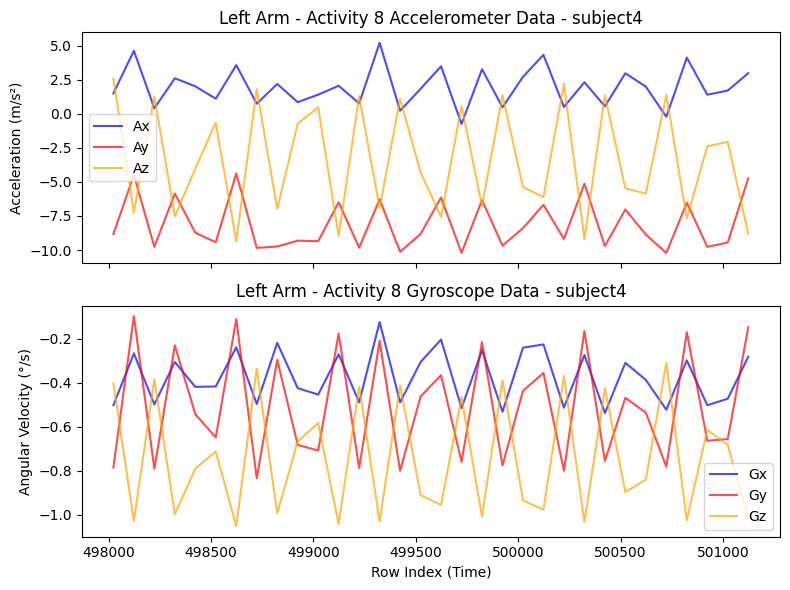

Subject: subject5, Data shape after sampling: (28, 18)


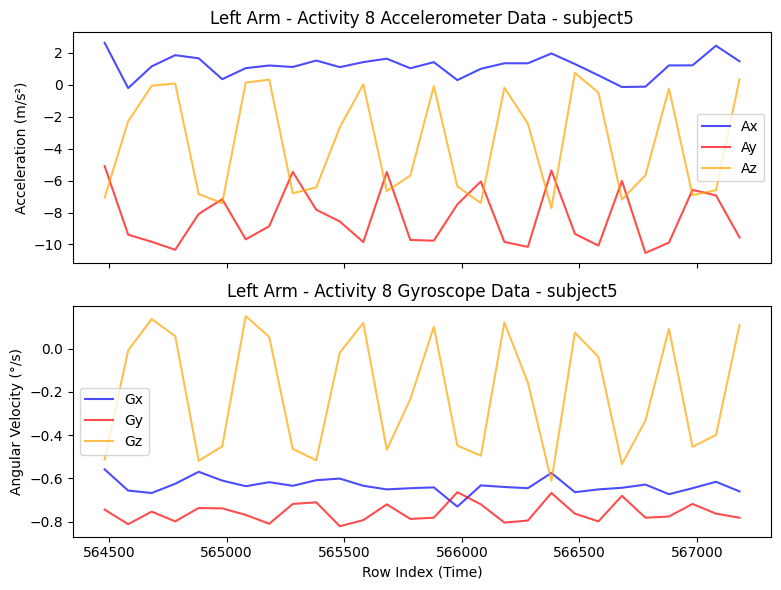

Subject: subject6, Data shape after sampling: (24, 18)


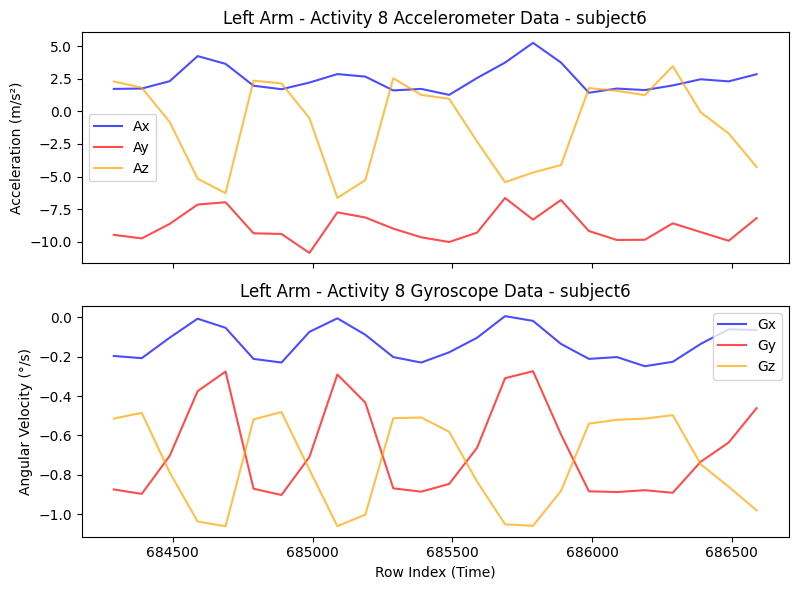

Subject: subject7, Data shape after sampling: (29, 18)


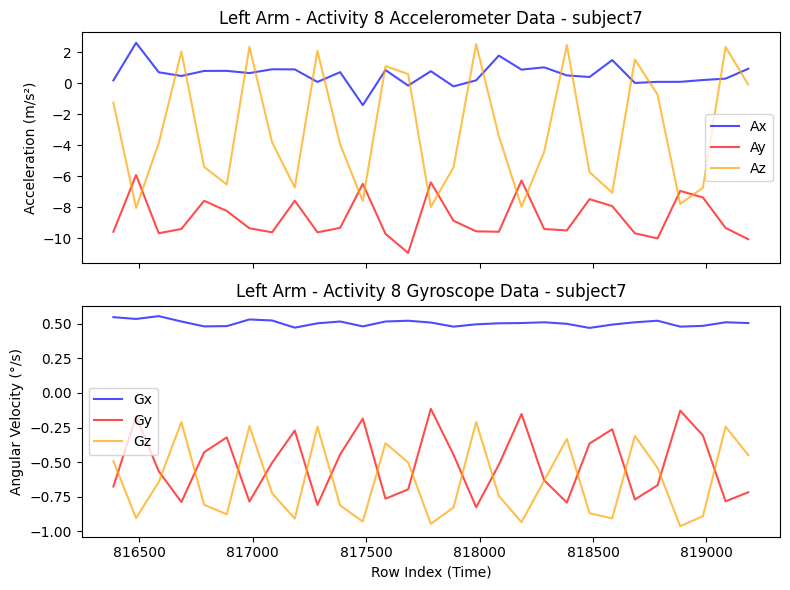

Subject: subject8, Data shape after sampling: (26, 18)


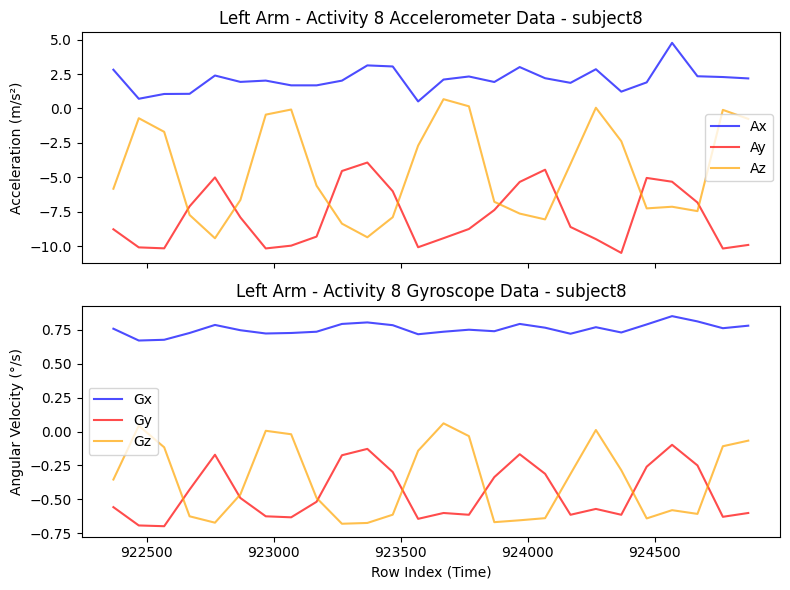

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 18)


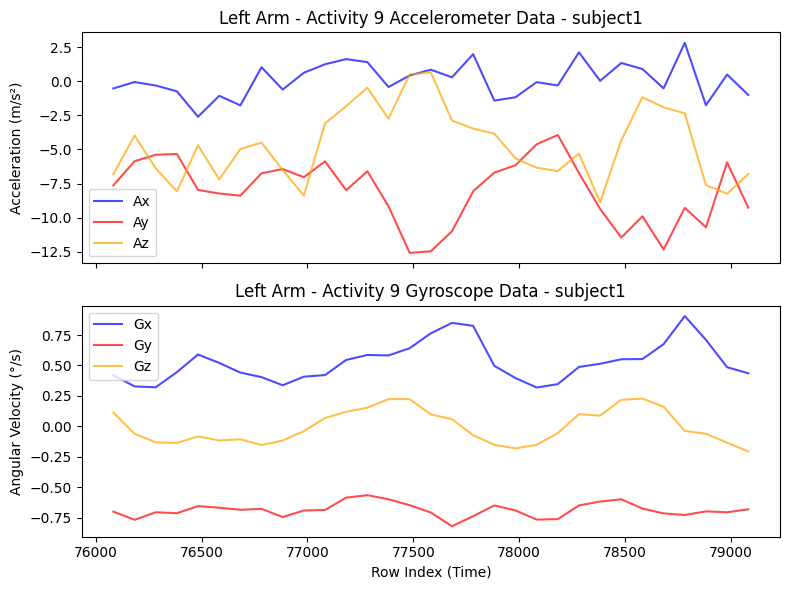

Subject: subject2, Data shape after sampling: (31, 18)


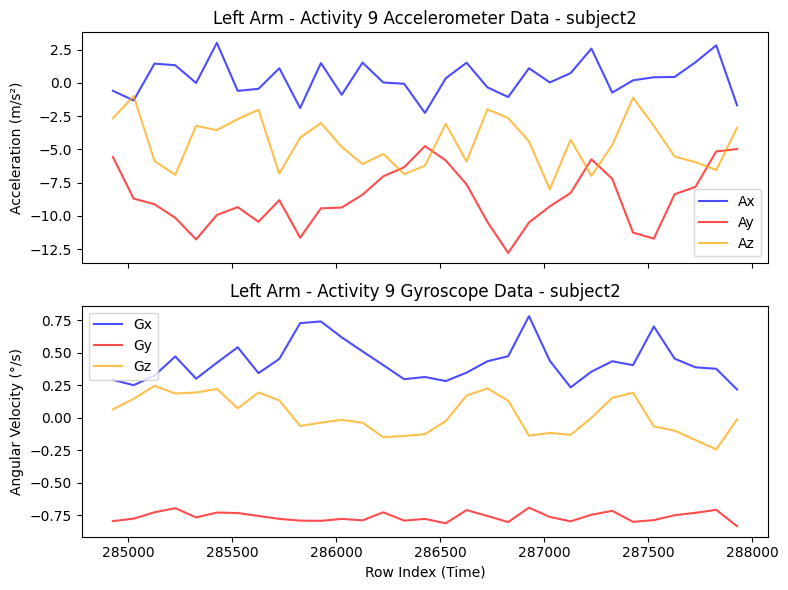

Subject: subject3, Data shape after sampling: (31, 18)


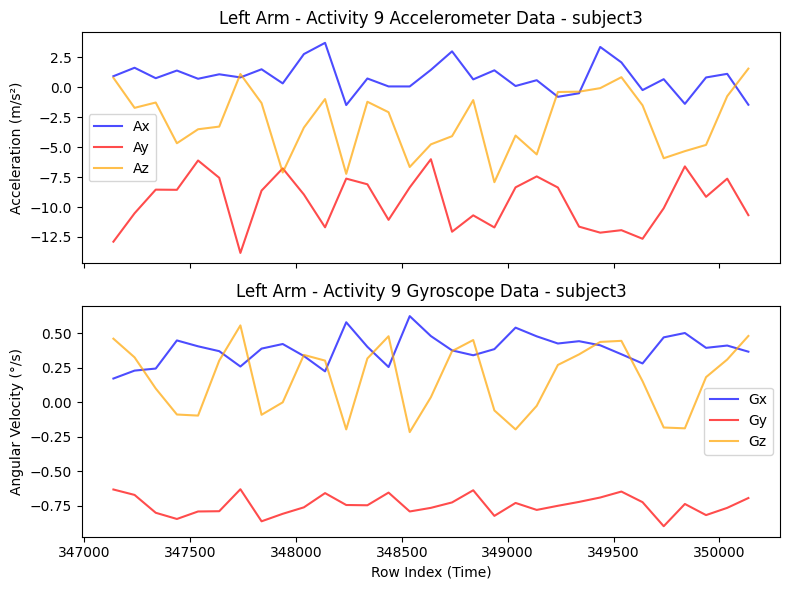

Subject: subject4, Data shape after sampling: (31, 18)


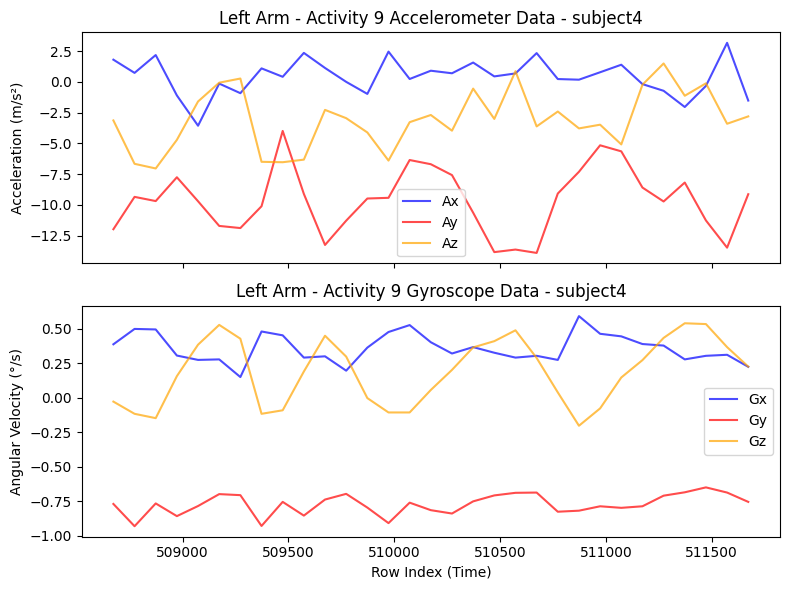

Subject: subject5, Data shape after sampling: (31, 18)


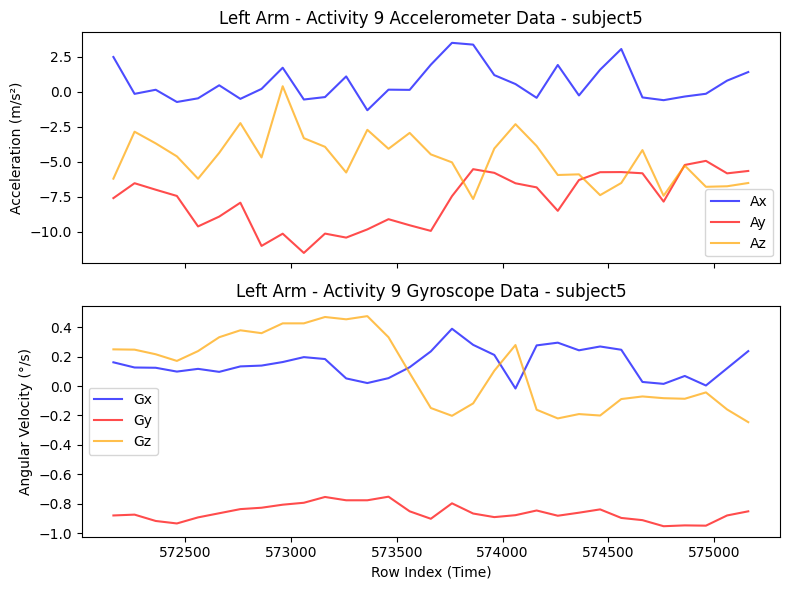

Subject: subject6, Data shape after sampling: (31, 18)


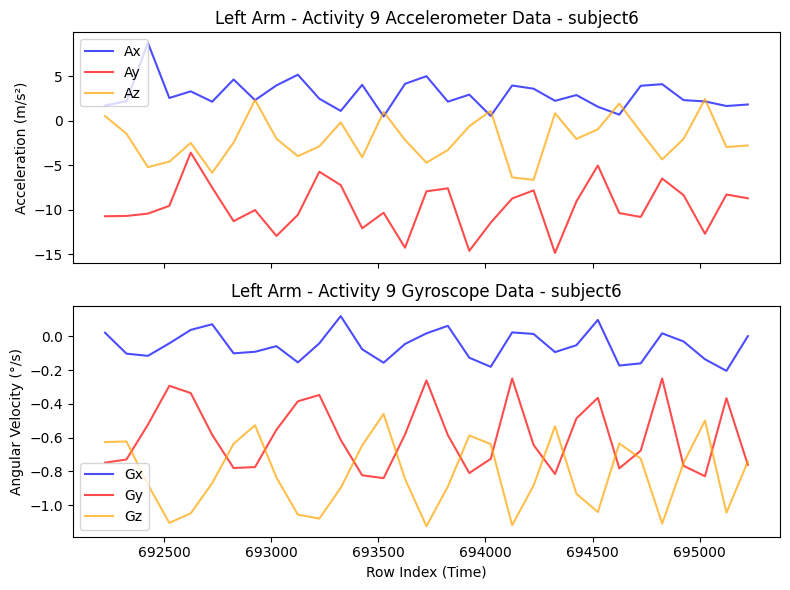

Subject: subject7, Data shape after sampling: (31, 18)


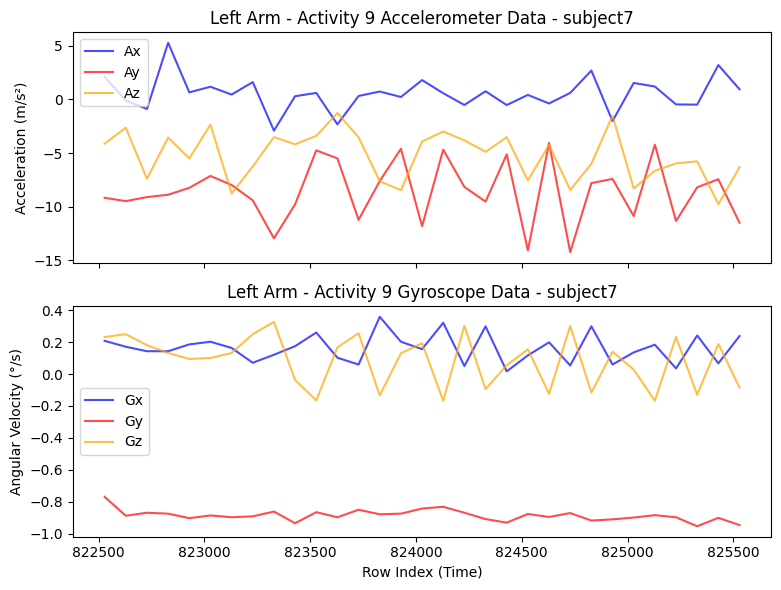

Subject: subject8, Data shape after sampling: (31, 18)


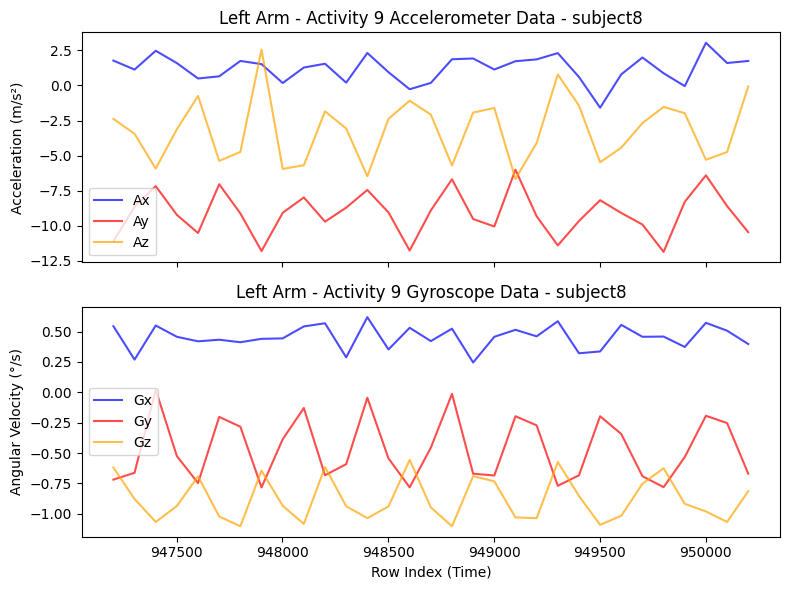

In [25]:
activity_id = 0
sampling_rate = 5000 
sel_cat_type = 'activity'
for activity_id in range(0, 10):
    if activity_id == 0:
        sampling_rate = 50000
    else: sampling_rate=1000  
    _ = plot_all_subjects_per_activity(df, sel_cat_type, lf_acc, lf_gry, "Left Arm - Activity " + str(activity_id) , sampling_rate, activity_id)

In [ ]:
for activity_id in range(0,13):
    _ = plot_all_subjects_per_activity(df, sel_cat_type, rt_acc, rt_gry, "Right Ankle- Activity " + str(activity_id), sampling_rate, activity_id)

Filtered data shape: (720946, 18)
Subject: subject1, Data shape after sampling: (1262, 19)
Subject: subject2, Data shape after sampling: (951, 19)
Subject: subject3, Data shape after sampling: (868, 19)
Subject: subject4, Data shape after sampling: (815, 19)
Subject: subject5, Data shape after sampling: (859, 19)
Subject: subject6, Data shape after sampling: (661, 19)
Subject: subject7, Data shape after sampling: (702, 19)
Subject: subject8, Data shape after sampling: (957, 19)
Subject: subject9, Data shape after sampling: (13824, 19)


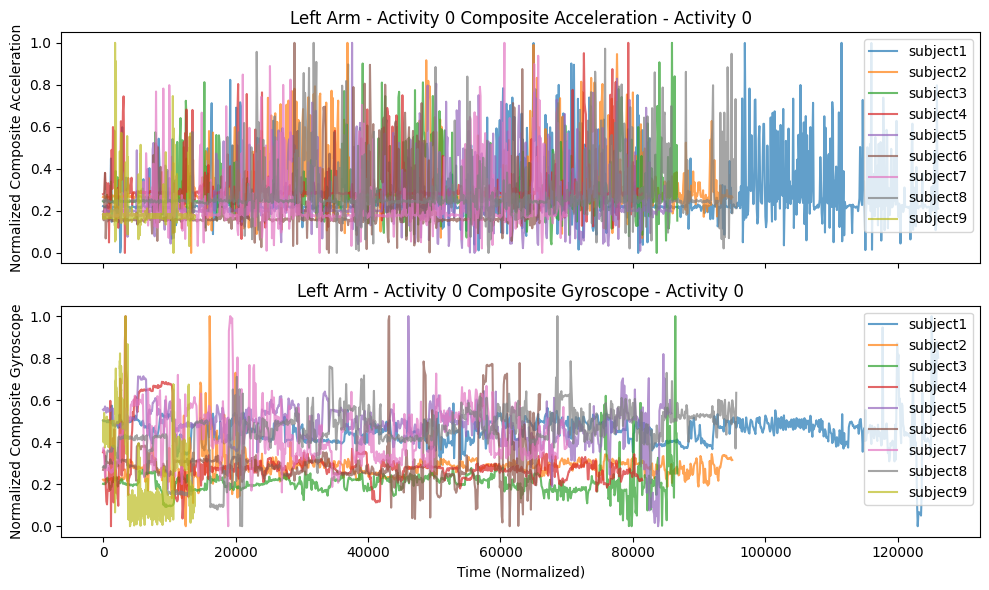

Filtered data shape: (27648, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)
Subject: subject9, Data shape after sampling: (31, 19)


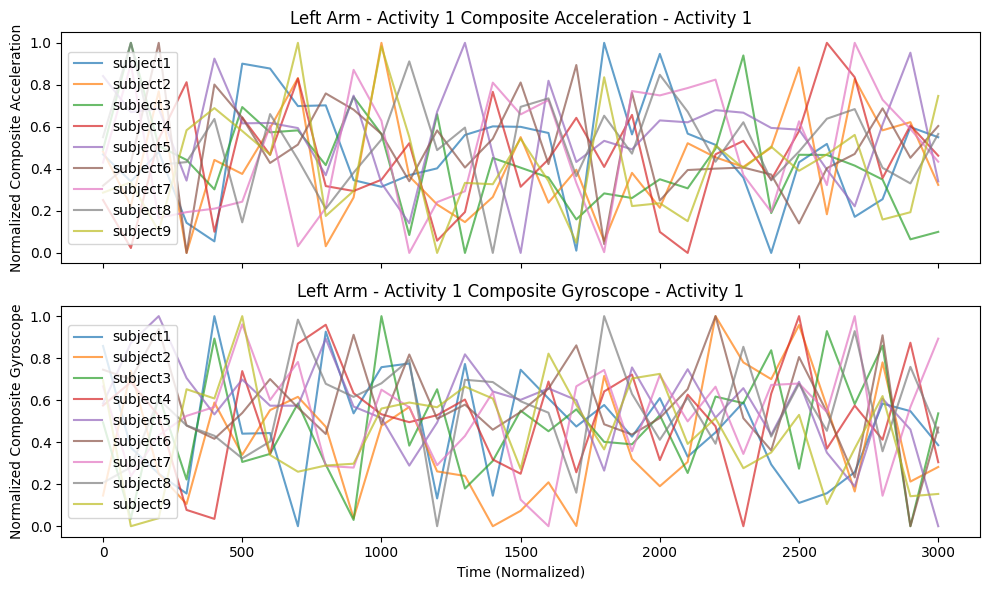

Filtered data shape: (25406, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)
Subject: subject9, Data shape after sampling: (830, 19)


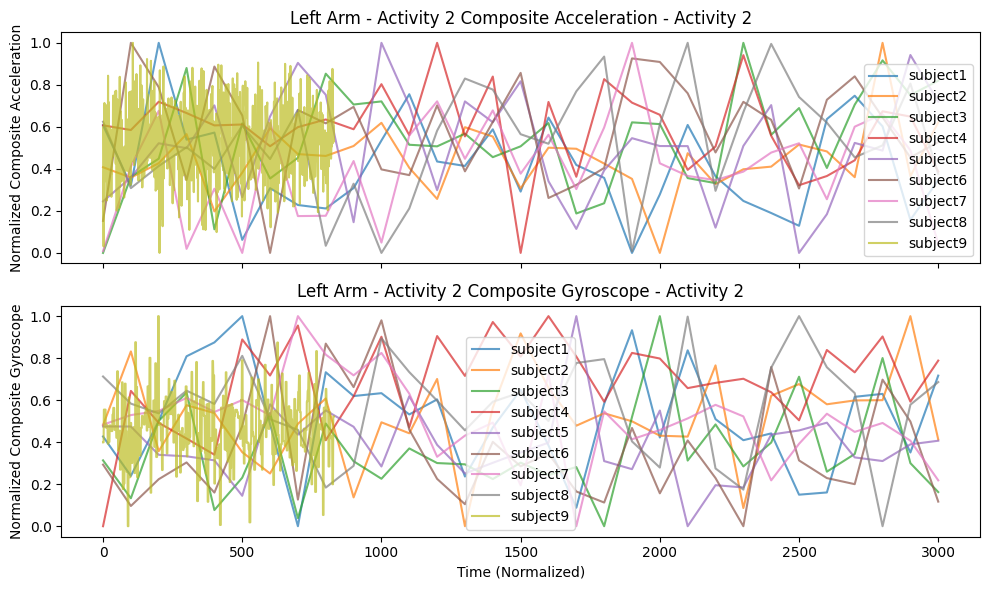

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


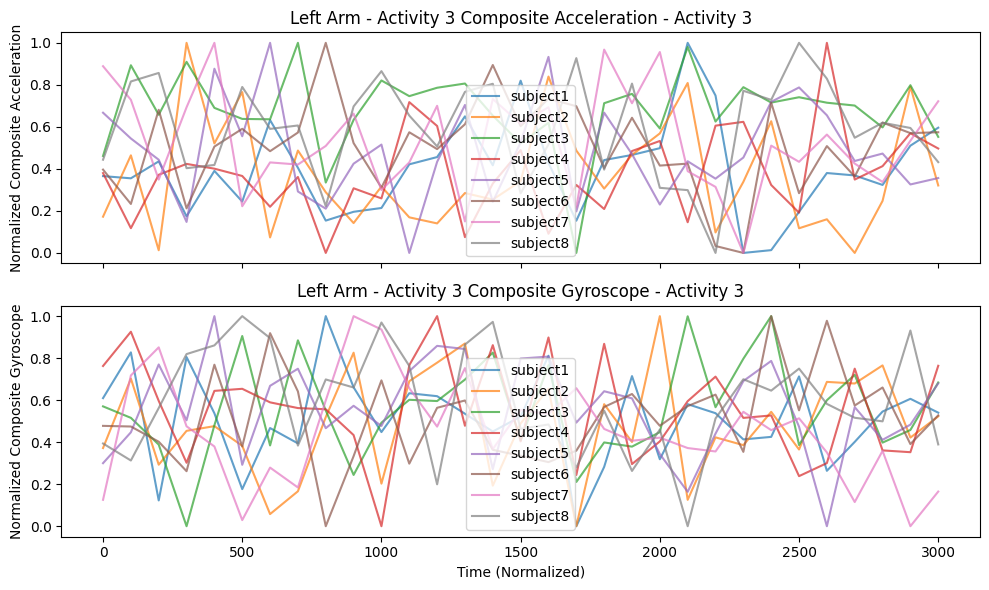

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


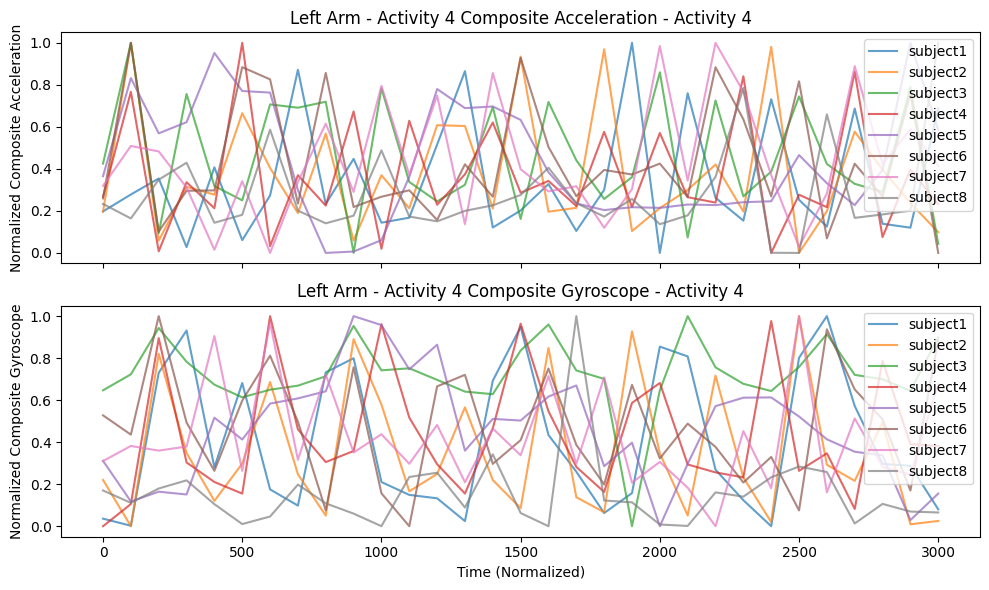

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


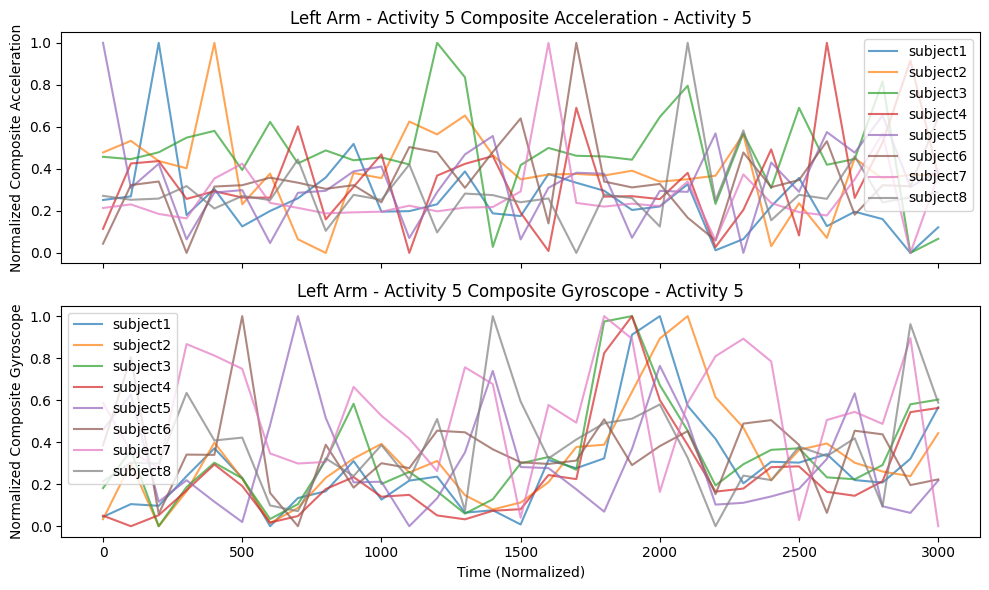

Filtered data shape: (22990, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (32, 19)
Subject: subject3, Data shape after sampling: (33, 19)
Subject: subject4, Data shape after sampling: (34, 19)
Subject: subject5, Data shape after sampling: (28, 19)
Subject: subject6, Data shape after sampling: (23, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (22, 19)


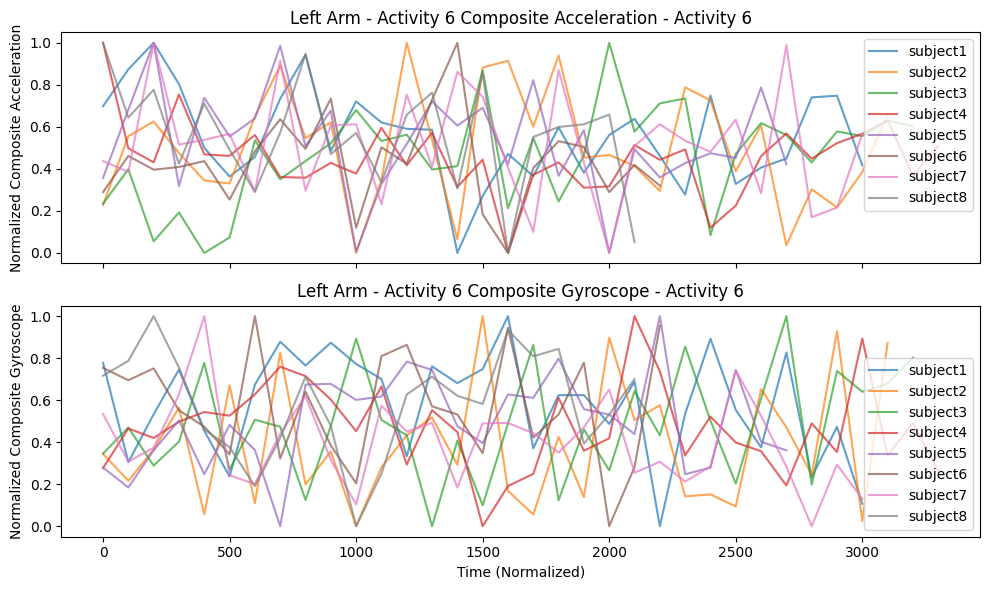

Filtered data shape: (23809, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (34, 19)
Subject: subject3, Data shape after sampling: (34, 19)
Subject: subject4, Data shape after sampling: (33, 19)
Subject: subject5, Data shape after sampling: (29, 19)
Subject: subject6, Data shape after sampling: (21, 19)
Subject: subject7, Data shape after sampling: (28, 19)
Subject: subject8, Data shape after sampling: (31, 19)


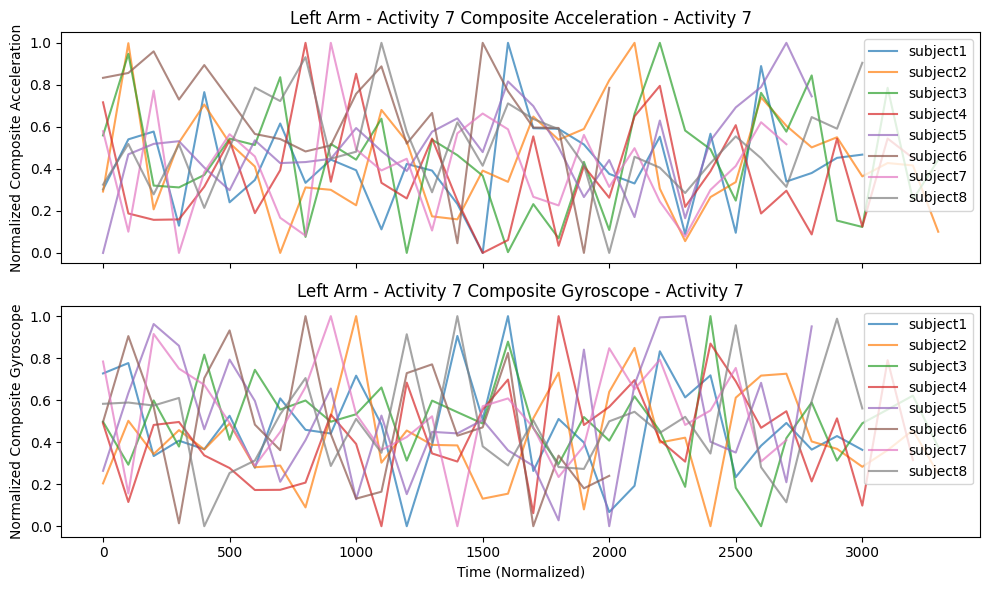

Filtered data shape: (23501, 18)
Subject: subject1, Data shape after sampling: (34, 19)
Subject: subject2, Data shape after sampling: (35, 19)
Subject: subject3, Data shape after sampling: (32, 19)
Subject: subject4, Data shape after sampling: (32, 19)
Subject: subject5, Data shape after sampling: (28, 19)
Subject: subject6, Data shape after sampling: (24, 19)
Subject: subject7, Data shape after sampling: (29, 19)
Subject: subject8, Data shape after sampling: (26, 19)


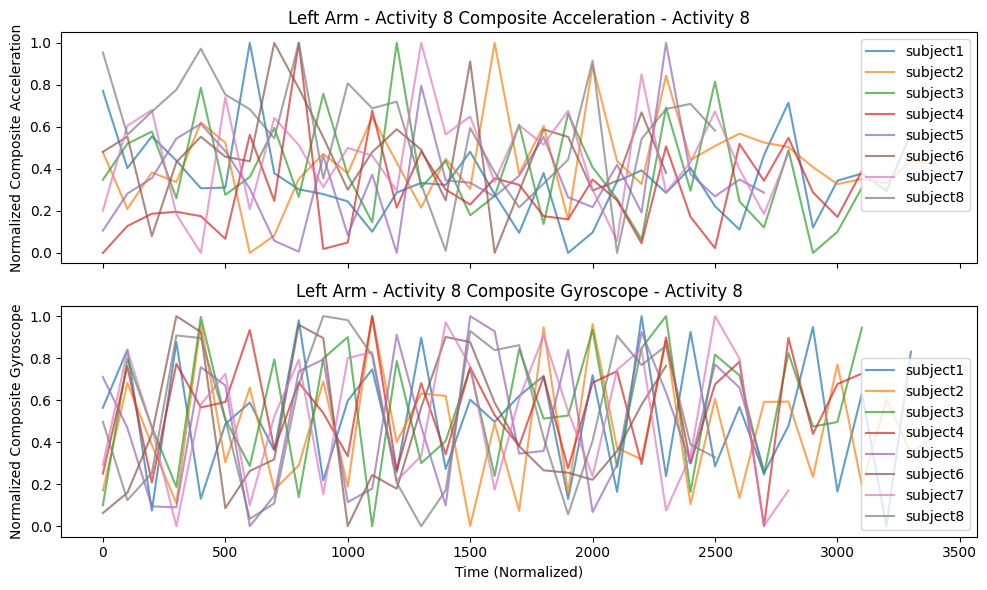

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


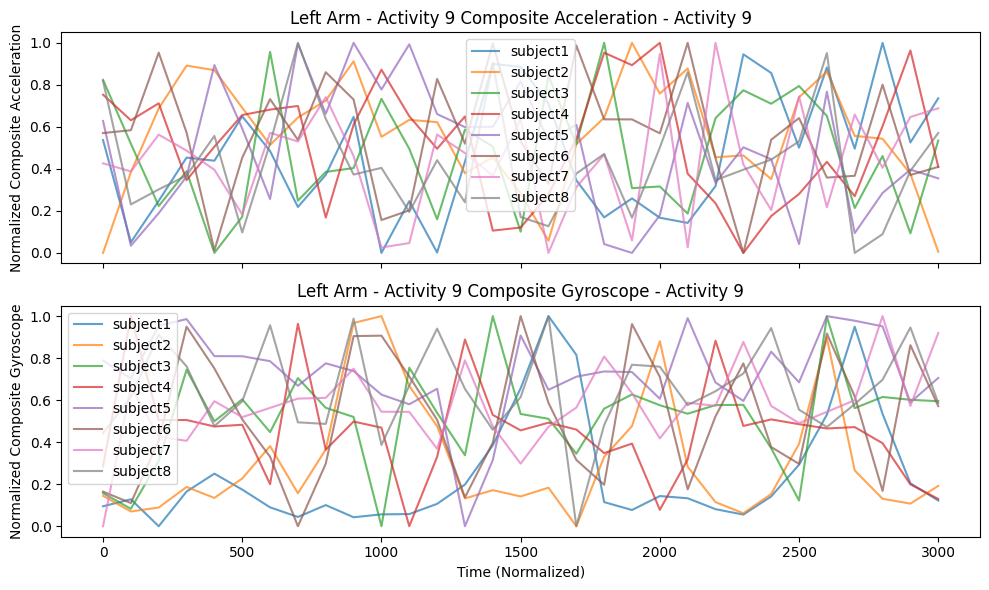

In [22]:
activity_id = 0
sampling_rate = 5000 
sel_cat_type = 'activity'
for activity_id in range(0, 10):
    if activity_id == 0:
        sampling_rate = 50000
    else: sampling_rate=1000  
    plot_composite_feature_aligned(df, sel_cat_type, lf_acc, lf_gry, "Left Arm - Activity " + str(activity_id), sampling_rate, activity_id)

Filtered data shape: (720946, 18)
Subject: subject1, Data shape after sampling: (1262, 19)
Subject: subject2, Data shape after sampling: (951, 19)
Subject: subject3, Data shape after sampling: (868, 19)
Subject: subject4, Data shape after sampling: (815, 19)
Subject: subject5, Data shape after sampling: (859, 19)
Subject: subject6, Data shape after sampling: (661, 19)
Subject: subject7, Data shape after sampling: (702, 19)
Subject: subject8, Data shape after sampling: (957, 19)
Subject: subject9, Data shape after sampling: (13824, 19)


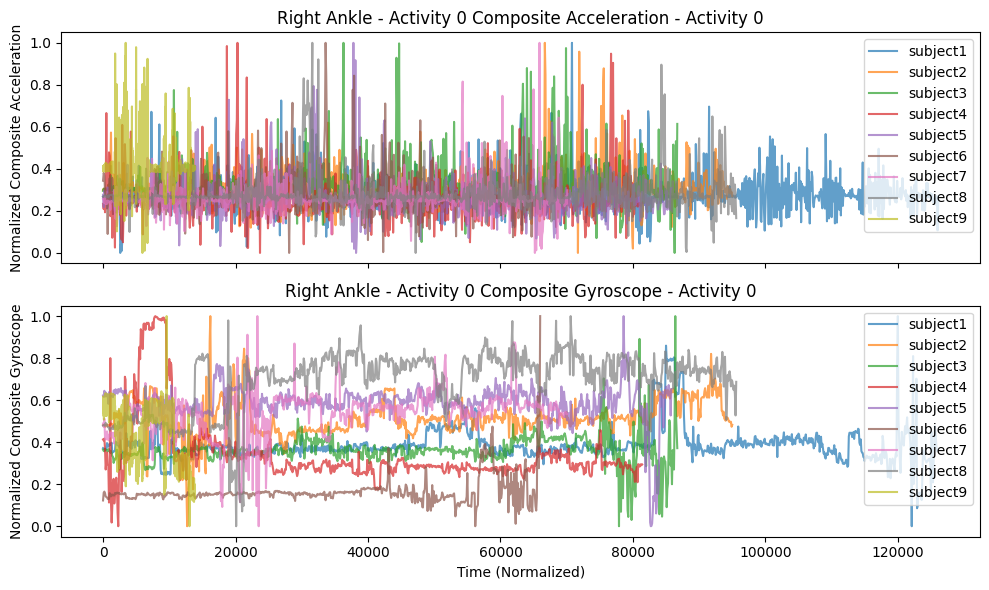

Filtered data shape: (27648, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)
Subject: subject9, Data shape after sampling: (31, 19)


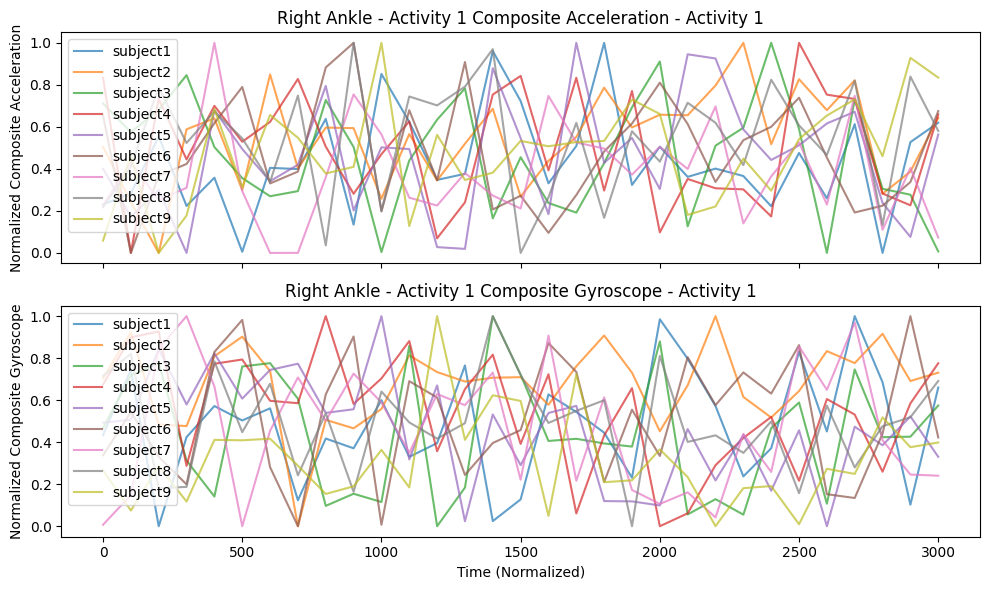

Filtered data shape: (25406, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)
Subject: subject9, Data shape after sampling: (830, 19)


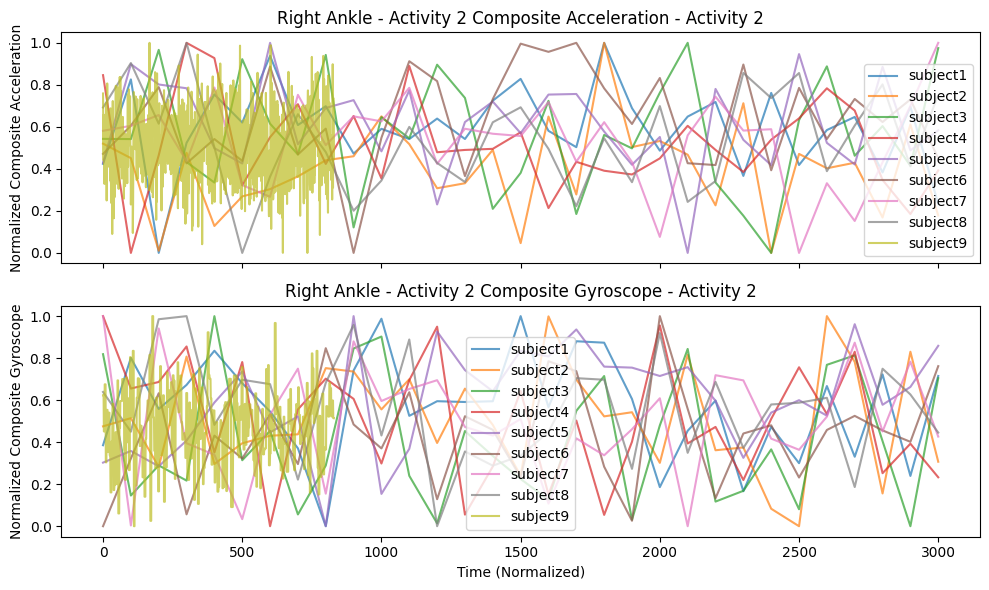

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


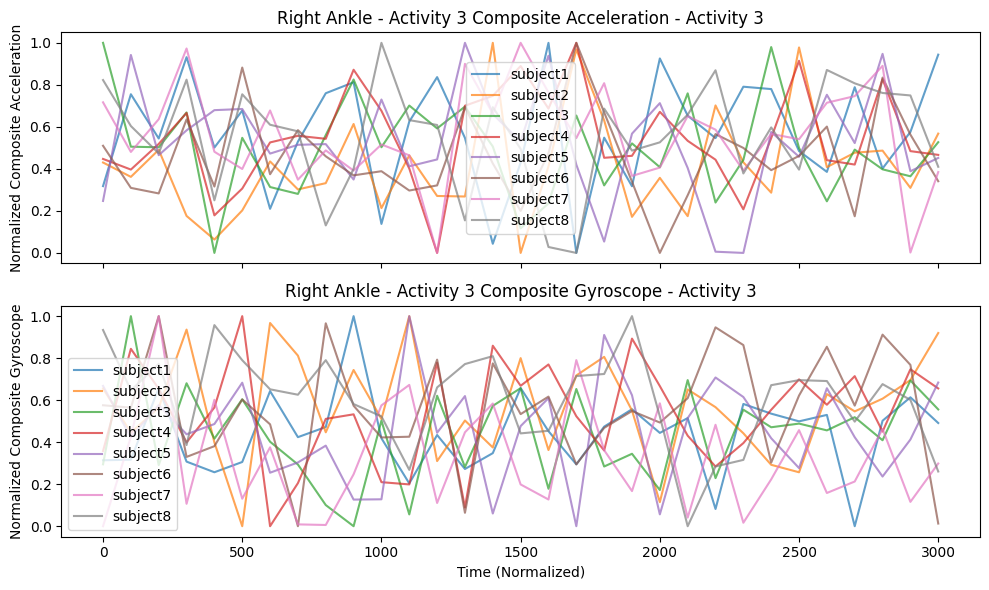

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


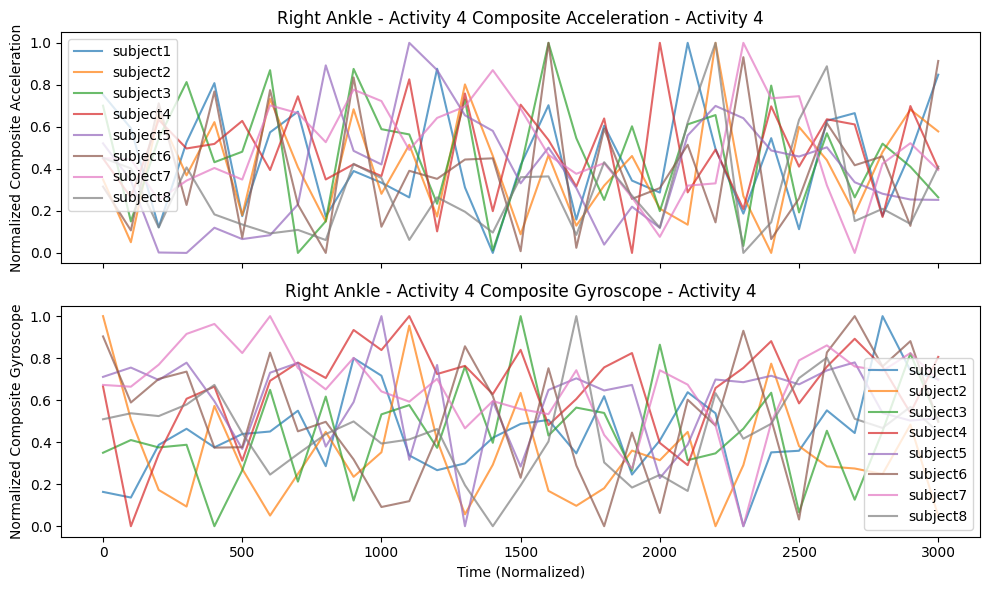

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


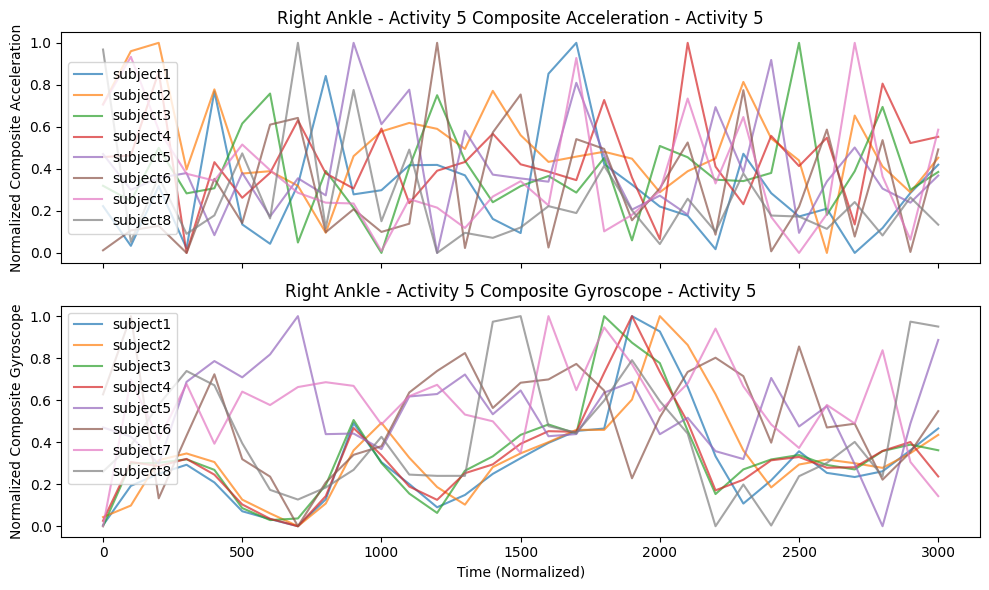

Filtered data shape: (22990, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (32, 19)
Subject: subject3, Data shape after sampling: (33, 19)
Subject: subject4, Data shape after sampling: (34, 19)
Subject: subject5, Data shape after sampling: (28, 19)
Subject: subject6, Data shape after sampling: (23, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (22, 19)


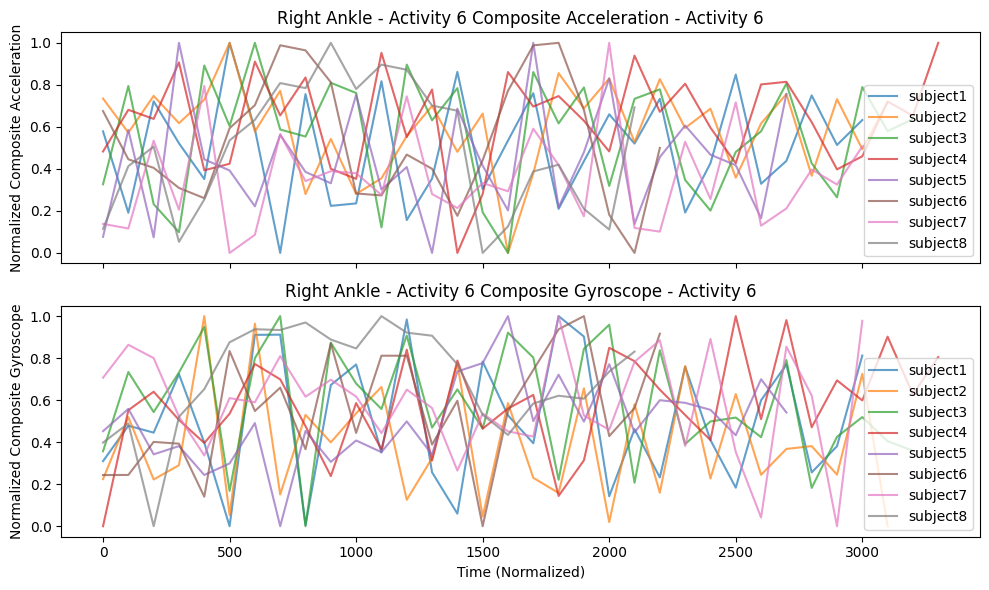

Filtered data shape: (23809, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (34, 19)
Subject: subject3, Data shape after sampling: (34, 19)
Subject: subject4, Data shape after sampling: (33, 19)
Subject: subject5, Data shape after sampling: (29, 19)
Subject: subject6, Data shape after sampling: (21, 19)
Subject: subject7, Data shape after sampling: (28, 19)
Subject: subject8, Data shape after sampling: (31, 19)


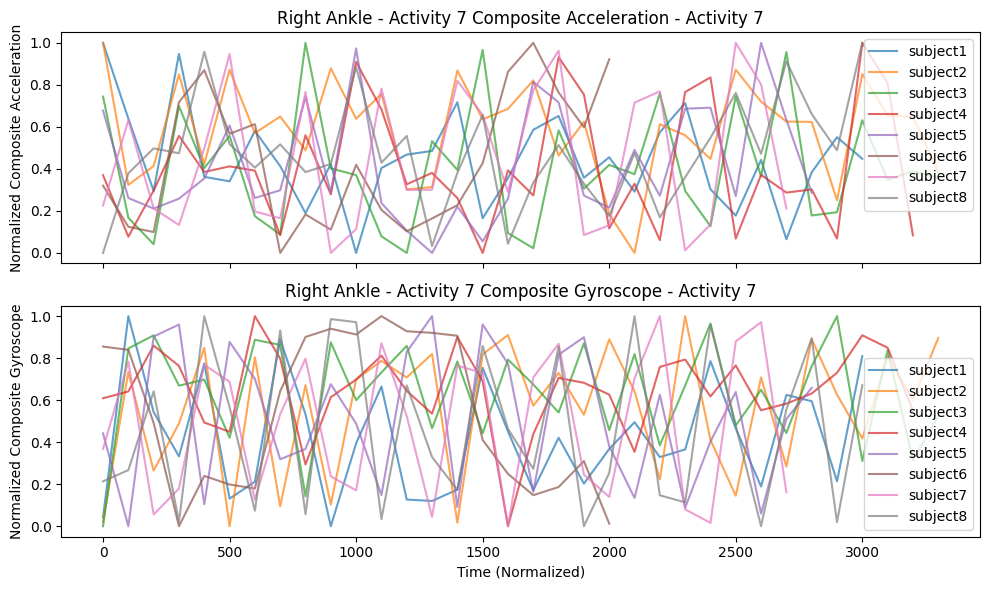

Filtered data shape: (23501, 18)
Subject: subject1, Data shape after sampling: (34, 19)
Subject: subject2, Data shape after sampling: (35, 19)
Subject: subject3, Data shape after sampling: (32, 19)
Subject: subject4, Data shape after sampling: (32, 19)
Subject: subject5, Data shape after sampling: (28, 19)
Subject: subject6, Data shape after sampling: (24, 19)
Subject: subject7, Data shape after sampling: (29, 19)
Subject: subject8, Data shape after sampling: (26, 19)


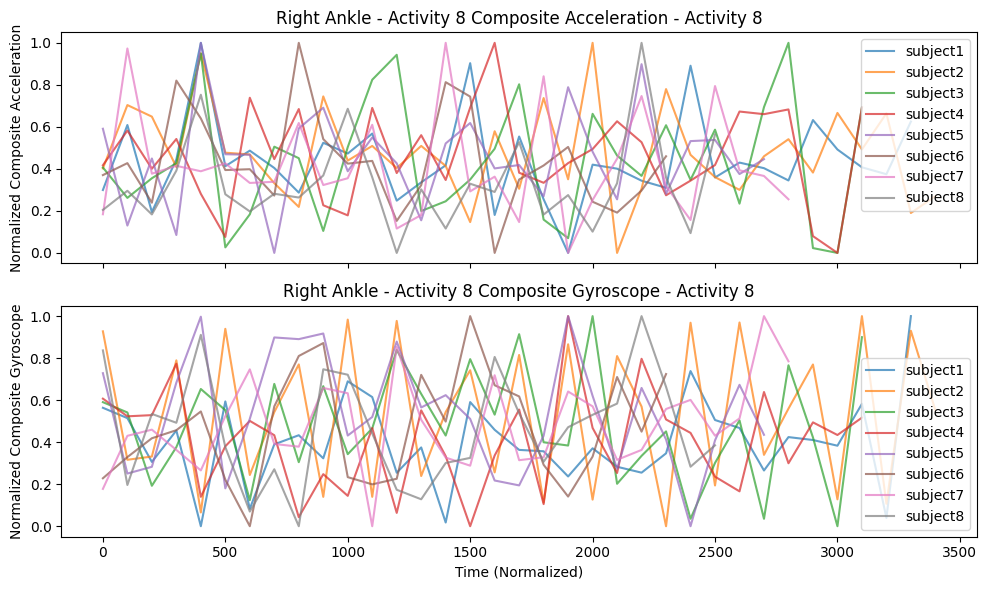

Filtered data shape: (24576, 18)
Subject: subject1, Data shape after sampling: (31, 19)
Subject: subject2, Data shape after sampling: (31, 19)
Subject: subject3, Data shape after sampling: (31, 19)
Subject: subject4, Data shape after sampling: (31, 19)
Subject: subject5, Data shape after sampling: (31, 19)
Subject: subject6, Data shape after sampling: (31, 19)
Subject: subject7, Data shape after sampling: (31, 19)
Subject: subject8, Data shape after sampling: (31, 19)


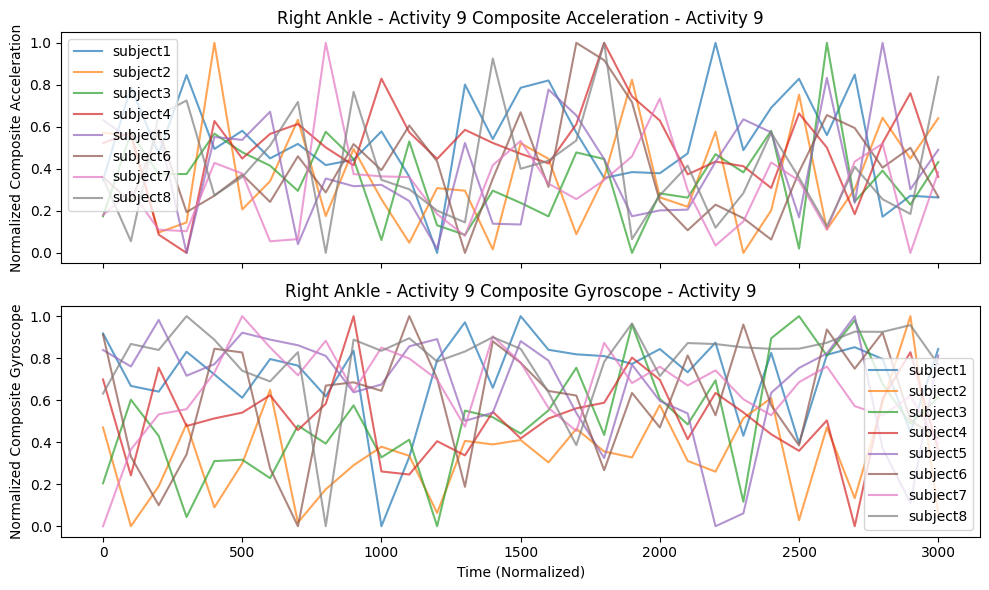

In [23]:
for activity_id in range(0, 10):
    if activity_id == 0:
        sampling_rate = 50000
    else: sampling_rate=1000  
    plot_composite_feature_aligned(df, sel_cat_type, rt_acc, rt_gry, "Right Ankle - Activity " + str(activity_id) , sampling_rate, activity_id)